## Imports and Dependencies

In [1]:
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import chainanalysis
import glob
import os
import io
import my_rdf
import subprocess as sb
#import pymongo
import pickle
from scipy.ndimage import uniform_filter1d
from scipy.stats import wasserstein_distance as emd
from itertools import zip_longest
from sklearn.linear_model import LinearRegression
from matplotlib.offsetbox import AnchoredOffsetbox, TextArea, HPacker, VPacker
import matplotlib.patches as patches
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from scipy.optimize import curve_fit
from scipy.special import factorial

In [2]:
# %pip install sklearn

In [3]:
# raw_data_path = '/mnt/d/StepGrowth_copoly/copoly3/copoly_data/Averaging/'
# GitHub_path = '/mnt/d/StepGrowth_copoly/copoly3_Github/copoly_data/'
# simnames = ['200813_copoly3_standard-1', '200817_copoly3_standard-2', '200820_copoly3_standard-3',
#             '200813_copoly3_1.5bar-1', '200817_copoly3_1.5bar-2', '200820_copoly3_1.5bar-3',
#             '200813_copoly3_2.5bar-1', '200817_copoly3_2.5bar-2', '200820_copoly3_2.5bar-3',
#             '200813_copoly3_3.5bar-1', '200817_copoly3_3.5bar-2', '200820_copoly3_3.5bar-3',
#             '200813_copoly3_4.5bar-1', '200817_copoly3_4.5bar-2', '200820_copoly3_4.5bar-3', 
#             '200904_copoly3_50dens-1', '200908_copoly3_50dens-2', '200911_copoly3_50dens-3',
#             '200904_copoly3_60dens-1', '200908_copoly3_60dens-2', '200911_copoly3_60dens-3', 
#             '200904_copoly3_70dens-1', '200908_copoly3_70dens-2', '200911_copoly3_70dens-3', 
#             '200904_copoly3_80dens-1', '200908_copoly3_80dens-2', '200911_copoly3_80dens-3', 
#             '200904_copoly3_90dens-1', '200908_copoly3_90dens-2', '200911_copoly3_90dens-3',
#             '201001_copoly3_0.01damp-4', '201001_copoly3_0.01damp-5', '201001_copoly3_0.01damp-6',
#             '201001_copoly3_0.03damp-4', '201001_copoly3_0.03damp-5', '201001_copoly3_0.03damp-6',
#             '201001_copoly3_0.05damp-4', '201001_copoly3_0.05damp-5', '201001_copoly3_0.05damp-6',
#             '201001_copoly3_0.30damp-4', '201001_copoly3_0.30damp-5', '201001_copoly3_0.30damp-6',
#             '201001_copoly3_0.50damp-4', '201001_copoly3_0.50damp-5', '201001_copoly3_0.50damp-6',
#             '201001_copoly3_1.00damp-4', '201001_copoly3_1.00damp-5', '201001_copoly3_1.00damp-6',
#             '211109_copoly3_2.1epsAABB-1', '211109_copoly3_2.1epsAABB-2', '211109_copoly3_2.1epsAABB-3',
#             '211109_copoly3_2.4epsAABB-1', '211109_copoly3_2.4epsAABB-2', '211109_copoly3_2.4epsAABB-3',
#             '211109_copoly3_2.7epsAABB-1', '211109_copoly3_2.7epsAABB-2', '211109_copoly3_2.7epsAABB-3',
#             '210619_copoly_flexible-1', '220705_copoly_flexible-2', '220705_copoly_flexible-3']
# for simname in simnames:
#     os.system('cp '+raw_data_path+simname+'/'+simname+'.lammpstrj.ordertraj.txt'+' '+GitHub_path+simname+'/'+simname+".lammpstrj.ordertraj.txt")

## Chain Analysis

In [4]:
trials_num = 3   # number of trials for each simulation type to average over (must be total number no skipping implemented)
path_name = '*copoly*'
#path_name = '210610*copoly*'
#path_name = '210719*copoly*'
#path_name = '211108*copoly*'
run_reader = False
run_bonding = False
calc_RDF = False
#full_RDF_trials = [0,1,2,15,16,17,21,22,23,24,25,26]
bond_end_clustering = [0,1,2,57,58,59]
full_RDF_trials = []
cwd = os.getcwd()
simnames = ['200813_copoly3_standard-1', '200817_copoly3_standard-2', '200820_copoly3_standard-3',
            '200813_copoly3_1.5bar-1', '200817_copoly3_1.5bar-2', '200820_copoly3_1.5bar-3',
            '200813_copoly3_2.5bar-1', '200817_copoly3_2.5bar-2', '200820_copoly3_2.5bar-3',
            '200813_copoly3_3.5bar-1', '200817_copoly3_3.5bar-2', '200820_copoly3_3.5bar-3',
            '200813_copoly3_4.5bar-1', '200817_copoly3_4.5bar-2', '200820_copoly3_4.5bar-3', 
            '200904_copoly3_50dens-1', '200908_copoly3_50dens-2', '200911_copoly3_50dens-3',
            '200904_copoly3_60dens-1', '200908_copoly3_60dens-2', '200911_copoly3_60dens-3', 
            '200904_copoly3_70dens-1', '200908_copoly3_70dens-2', '200911_copoly3_70dens-3', 
            '200904_copoly3_80dens-1', '200908_copoly3_80dens-2', '200911_copoly3_80dens-3', 
            '200904_copoly3_90dens-1', '200908_copoly3_90dens-2', '200911_copoly3_90dens-3',
            '201001_copoly3_0.01damp-4', '201001_copoly3_0.01damp-5', '201001_copoly3_0.01damp-6',
            '201001_copoly3_0.03damp-4', '201001_copoly3_0.03damp-5', '201001_copoly3_0.03damp-6',
            '201001_copoly3_0.05damp-4', '201001_copoly3_0.05damp-5', '201001_copoly3_0.05damp-6',
            '201001_copoly3_0.30damp-4', '201001_copoly3_0.30damp-5', '201001_copoly3_0.30damp-6',
            '201001_copoly3_0.50damp-4', '201001_copoly3_0.50damp-5', '201001_copoly3_0.50damp-6',
            '201001_copoly3_1.00damp-4', '201001_copoly3_1.00damp-5', '201001_copoly3_1.00damp-6',
            '211109_copoly3_2.1epsAABB-1', '211109_copoly3_2.1epsAABB-2', '211109_copoly3_2.1epsAABB-3',
            '211109_copoly3_2.4epsAABB-1', '211109_copoly3_2.4epsAABB-2', '211109_copoly3_2.4epsAABB-3',
            '211109_copoly3_2.7epsAABB-1', '211109_copoly3_2.7epsAABB-2', '211109_copoly3_2.7epsAABB-3',
            '210619_copoly_flexible-1', '220705_copoly_flexible-2', '220705_copoly_flexible-3']#,
            #'230507_copoly_standard_surface-1','230507_copoly_standard_surface-1','230507_copoly_standard_surface-1']

sims = []
cnt = 0
trial_cnt = 1
for i,simname in enumerate(simnames):
    #print(i)
    print(simname)

    #run basic analysis once if needed
    if run_reader:
        reader = chainanalysis.BondReader('./'+simname+'/'+simname)
        reader.calc()
        
        #Manipulating object frames
        probs = [reader.trajs['pAA'],reader.trajs['pBB'],reader.trajs['pAABB'],reader.trajs['pAB']]
        PDI = np.array(reader.trajs['PDI'])
        p = np.array(reader.trajs['extent'])
        tstep = np.array(reader.trajs['step'])
        ChainDist = reader.frames[-1]['chaindist']
        BlockADist = reader.frames[-1]['blockAdist']
        BlockBDist = reader.frames[-1]['blockBdist']
        BlockAErr = reader.frames[-1]['blockAerror']
        BlockBErr = reader.frames[-1]['blockBerror']
        seqs = reader.frames[-1]['seq']
        pA = [0.]
        pB = [0.]
        extent2 = [0.]
        cnt=0
        n = np.linspace(0,50,51)
        TotalBlockXw = np.zeros((len(reader.trajs['PDI'])))
        TotalBlockXn = np.zeros((len(reader.trajs['PDI'])))
        Xn = np.zeros((len(reader.trajs['PDI'])))
        BlockXw = np.zeros((len(reader.trajs['PDI'])))
        BlockXn = np.zeros((len(reader.trajs['PDI'])))
        BlockAXw = np.zeros((len(reader.trajs['PDI'])))
        BlockAXn = np.zeros((len(reader.trajs['PDI'])))
        BlockBXw = np.zeros((len(reader.trajs['PDI'])))
        BlockBXn = np.zeros((len(reader.trajs['PDI'])))
        for frame in reader.frames[:]:
            extent2.append(1-((frame['monoAcount']+frame['monoBcount'])/reader.params['Nmono']))
            pA.append(1-frame['monoAcount']/reader.frames[0]['monoAcount'])
            pB.append(1-frame['monoBcount']/reader.frames[0]['monoBcount'])  
            BlockTotal = np.zeros((len(n)))
            for id, val in enumerate(frame['blockAdist'][0]):
                BlockTotal[val] += frame['blockAdist'][1][id]
            for id, val in enumerate(frame['blockBdist'][0]):
                BlockTotal[val] += frame['blockBdist'][1][id]
            BlockAXw[cnt] = np.sum(np.array(frame['blockAdist'][0])*np.array(frame['blockAdist'][0])*np.array(frame['blockAdist'][1]))/np.sum(np.array(frame['blockAdist'][0])*np.array(frame['blockAdist'][1]))
            BlockAXn[cnt] = np.sum(np.array(frame['blockAdist'][0])*np.array(frame['blockAdist'][1]))/np.sum(np.array(frame['blockAdist'][1]))
            BlockBXw[cnt] = np.sum(np.array(frame['blockBdist'][0])*np.array(frame['blockBdist'][0])*np.array(frame['blockBdist'][1]))/np.sum(np.array(frame['blockBdist'][0])*np.array(frame['blockBdist'][1]))
            BlockBXn[cnt] = np.sum(np.array(frame['blockBdist'][0])*np.array(frame['blockBdist'][1]))/np.sum(np.array(frame['blockBdist'][1]))
            Xn[cnt] = np.sum(np.array(frame['chaindist'][0])*np.array(frame['chaindist'][1]))/np.sum(np.array(frame['chaindist'][1]))
            TotalBlockXw[cnt] = np.sum(n*n*BlockTotal)/np.sum(n*BlockTotal) 
            TotalBlockXn[cnt] = np.sum(n*BlockTotal)/np.sum(BlockTotal)
            cnt+=1
        TotalBlock_PDI = np.array(TotalBlockXw/TotalBlockXn)        
        BlockA_PDI = np.array(BlockAXw/BlockAXn)
        BlockB_PDI = np.array(BlockBXw/BlockBXn)

        #Saving results
        with open('./'+simname+'/jar/'+simname+'_probs.pickle','wb') as f1:
            pickle.dump(probs,f1)
        with open('./'+simname+'/jar/'+simname+'_extent.pickle','wb') as f1:
            pickle.dump(p,f1)
        with open('./'+simname+'/jar/'+simname+'_tstep.pickle','wb') as f1:
            pickle.dump(tstep,f1)
        with open('./'+simname+'/jar/'+simname+'_PDI.pickle','wb') as f1:
            pickle.dump(PDI,f1)
        with open('./'+simname+'/jar/'+simname+'_DOP.pickle','wb') as f1:
            pickle.dump(Xn,f1)
        with open('./'+simname+'/jar/'+simname+'_BlockPDI.pickle','wb') as f1:
            pickle.dump(TotalBlock_PDI,f1)
        with open('./'+simname+'/jar/'+simname+'_BlockAPDI.pickle','wb') as f1:
            pickle.dump(BlockA_PDI,f1)
        with open('./'+simname+'/jar/'+simname+'_BlockBPDI.pickle','wb') as f1:
            pickle.dump(BlockB_PDI,f1)
        with open('./'+simname+'/jar/'+simname+'_BlockA.pickle','wb') as f1:
            pickle.dump(BlockADist,f1)
        with open('./'+simname+'/jar/'+simname+'_BlockB.pickle','wb') as f1:
            pickle.dump(BlockBDist,f1)
        with open('./'+simname+'/jar/'+simname+'_ChainDist.pickle','wb') as f1:
            pickle.dump(ChainDist,f1)
        with open('./'+simname+'/jar/'+simname+'_seqs.pickle','wb') as f:
            pickle.dump(seqs,f)  
        with open('./'+simname+'/jar/'+simname+'_extent2.pickle','wb') as f:
            pickle.dump(extent2,f)  
        with open('./'+simname+'/jar/'+simname+'_pA.pickle','wb') as f:
            pickle.dump(pA,f)  
        with open('./'+simname+'/jar/'+simname+'_pB.pickle','wb') as f:
            pickle.dump(pB,f)  
        

    if run_bonding:
        if not run_reader:
            reader = chainanalysis.BondReader('./'+simname+'/'+simname)
            reader.calc()
        #Finding the longest chain in the system
        longest_chain = np.amax(np.array(reader.frames[-1]['chaindist'][0]))
        n_range = list(np.linspace(1,longest_chain,longest_chain).astype(int))


        #Loop over simulation frames [0:9]
        for frame in reader.frames[:]:

            #Finding number of bonds formed and unreacted monomers
            ctr = int(frame['step']/100000)
            if ctr == 0:
                all_rxn = []
                monos_rxn = []
                dimers_rxn = []
                oligos_rxn = []
                all_bond_pairs = []
                new_bonds = 0
                old_dimers = 0
                old_seqs = reader.frames[ctr]['numseq']

            else:
                old_seqs = reader.frames[ctr-1]['numseq']


            #Identifying newly formed sequences and lost sequences
            new_seqs = frame['numseq']
            made_lengths_counts = [n_range,list(np.zeros(len(n_range)).astype(int))]
            lost_lengths_counts = [n_range,list(np.zeros(len(n_range)).astype(int))]
            monos_reacting = 0
            dimers_reacting = 0
            oligos_only = 0
            rxn_dist = []
            made = [] #New sequences not currently existing
            lost = [] #Sequences which have dissapeared due to reacting
            bond_pairs = []

            for chain in old_seqs:
                match = False
                for new_seq in new_seqs:
                    if set(chain) == set(new_seq):
                        match = True
                        break
                if not match:
                    lost.append(chain)

            for chain in new_seqs:
                match = False
                for old_seq in old_seqs:
                    if set(chain) == set(old_seq):
                        match = True
                        break
                if not match:    
                    made.append(chain)

            for chain in lost:
                for seq in made:
                    if set(chain).issubset(seq):
                        len1 = int(len(chain)/3)
                        len2 = int((len(seq)-len(chain))/3)
                        if len1 >= len2:
                            pair = (len2,len1)
                        else:
                            pair = (len1,len2)
                        bond_pairs.append(pair)
                        lost_lengths_counts[1][len1-1] += 1
                        lost_lengths_counts[1][len2-1] += 1
                        made_lengths_counts[1][len1+len2-1] += 1
                        if pair[0] > 2:
                            oligos_only += 1
                        elif pair[0] == 2:
                            dimers_reacting += 1
                        else:
                            monos_reacting += 1


            #Obtaining length distribution for reacting species
            bond_pairs.sort()
            new_bonds = len(bond_pairs)

            rxn_dist = lost_lengths_counts

            #Appending results to list for whole simulation
            all_rxn.append(rxn_dist)
            all_bond_pairs.append(bond_pairs)
            if new_bonds == 0:
                if ctr == 0:
                    monos_rxn.append(1)
                    dimers_rxn.append(0)
                    oligos_rxn.append(0)
                else:
                    monos_rxn.append(monos_rxn[ctr-1])
                    dimers_rxn.append(dimers_rxn[ctr-1])
                    oligos_rxn.append(oligos_rxn[ctr-1])
            else:
                monos_rxn.append(monos_reacting/new_bonds)
                dimers_rxn.append(dimers_reacting/new_bonds)
                oligos_rxn.append(oligos_only/new_bonds)
        
        #Saving results
        with open('./'+simname+'/jar/'+simname+'_monos.pickle','wb') as f1:
            pickle.dump(monos_rxn,f1)
        with open('./'+simname+'/jar/'+simname+'_dimers.pickle','wb') as f2:
            pickle.dump(dimers_rxn,f2)
        with open('./'+simname+'/jar/'+simname+'_oligos.pickle','wb') as f3:
            pickle.dump(oligos_rxn,f3)
        with open('./'+simname+'/jar/'+simname+'_rxn.pickle','wb') as f4:
            pickle.dump(all_rxn,f4)
        with open('./'+simname+'/jar/'+simname+'_bond_pairs.pickle','wb') as f5:
            pickle.dump(all_bond_pairs,f5)
    
    # Reader and boding already run, just load in data
    if (not run_reader) and (not run_bonding):
        with open('./'+simname+'/jar/'+simname+'_probs.pickle','rb') as f1:
            probs = pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_extent.pickle','rb') as f1:
            p = pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_tstep.pickle','rb') as f1:
            tstep = pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_PDI.pickle','rb') as f1:
            PDI = pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_DOP.pickle','rb') as f1:
            Xn = pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_BlockPDI.pickle','rb') as f1:
            TotalBlock_PDI = pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_BlockAPDI.pickle','rb') as f1:
            BlockA_PDI = pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_BlockBPDI.pickle','rb') as f1:
            BlockB_PDI = pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_BlockA.pickle','rb') as f1:
            BlockADist = pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_BlockB.pickle','rb') as f1:
            BlockBDist = pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_ChainDist.pickle','rb') as f1:
            ChainDist = pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_monos.pickle','rb') as f1:
            monos_rxn = pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_dimers.pickle','rb') as f2:
            dimers_rxn = pickle.load(f2)
        with open('./'+simname+'/jar/'+simname+'_oligos.pickle','rb') as f3:
            oligos_rxn = pickle.load(f3)
        with open('./'+simname+'/jar/'+simname+'_rxn.pickle','rb') as f4:
            all_rxn = pickle.load(f4)
        with open('./'+simname+'/jar/'+simname+'_bond_pairs.pickle','rb') as f5:
            all_bond_pairs = pickle.load(f5)
        with open('./'+simname+'/jar/'+simname+'_seqs.pickle','rb') as f:
            seqs = pickle.load(f)
        with open('./'+simname+'/jar/'+simname+'_pA.pickle','rb') as f:
            pA = pickle.load(f)
        with open('./'+simname+'/jar/'+simname+'_pB.pickle','rb') as f:
            pB = pickle.load(f)
#         with open('./'+simname+'/jar/'+simname+'_int-ext.pickle','rb') as f:
#             monos_int_ext = pickle.load(f)

    
    #Always get 1 trial RDF, calculated
    if calc_RDF and trial_cnt==1:
        rdf_step = 15000000 #Timestep 1: before emergent rate change
        rdf_step2 = 20000000 #Timestep 2: after emergent rate change
        BOX_SIZE = 50
        #Timestep 1 snapshot
        my_rdf.fetch('./'+simname+'/'+simname+'.lammpstrj', rdf_step, './'+simname+'/'+simname+'_end.lammpstrj')
        my_rdf.fetch('./'+simname+'/'+simname+'-bond', rdf_step, './'+simname+'/'+simname+'-bond_end')
        sb.call('head -n -1 ./'+simname+'/'+simname+'-bond_end > tmp && mv tmp ./'+simname+'/'+simname+'-bond_end',shell=True)
        sb.call('head -n -1 ./'+simname+'/'+simname+'_end.lammpstrj > tmp && mv tmp ./'+simname+'/'+simname+'_end.lammpstrj',shell=True)
        x, rdf_all = my_rdf.rdf('./'+simname+'/'+simname)
        x, rdf_AA = my_rdf.rdf_pairAA('./'+simname+'/'+simname)
        x, rdf_BB = my_rdf.rdf_pairBB('./'+simname+'/'+simname)
        x, rdf_AB = my_rdf.rdf_pairAB('./'+simname+'/'+simname)
        RDFs = [rdf_step,x,rdf_all,rdf_AA,rdf_BB,rdf_AB]
        #Timestep 2 snapshot
        my_rdf.fetch('./'+simname+'/'+simname+'.lammpstrj', rdf_step2, './'+simname+'/'+simname+'_end.lammpstrj')
        my_rdf.fetch('./'+simname+'/'+simname+'-bond', rdf_step2, './'+simname+'/'+simname+'-bond_end')
        sb.call('head -n -1 ./'+simname+'/'+simname+'-bond_end > tmp && mv tmp ./'+simname+'/'+simname+'-bond_end',shell=True)
        sb.call('head -n -1 ./'+simname+'/'+simname+'_end.lammpstrj > tmp && mv tmp ./'+simname+'/'+simname+'_end.lammpstrj',shell=True)
        x, rdf_all = my_rdf.rdf('./'+simname+'/'+simname)
        x, rdf_AA = my_rdf.rdf_pairAA('./'+simname+'/'+simname)
        x, rdf_BB = my_rdf.rdf_pairBB('./'+simname+'/'+simname)
        x, rdf_AB = my_rdf.rdf_pairAB('./'+simname+'/'+simname)
        RDF2 = [rdf_step2,x,rdf_all,rdf_AA,rdf_BB,rdf_AB]
        with open('./'+simname+'/jar/'+simname+'_RDFs.pickle','wb') as f:
            pickle.dump(RDFs,f)
        with open('./'+simname+'/jar/'+simname+'_RDF2.pickle','wb') as f:
            pickle.dump(RDF2,f)
    
    
    #Sometimes get 3 trials RDF, calculated
    elif calc_RDF and i in full_RDF_trials:
        rdf_step = 15000000 #Timestep 1: before emergent rate change
        rdf_step2 = 20000000 #Timestep 2: after emergent rate change
        BOX_SIZE = 50
        #Timestep 1 snapshot
        my_rdf.fetch('./'+simname+'/'+simname+'.lammpstrj', rdf_step, './'+simname+'/'+simname+'_end.lammpstrj')
        my_rdf.fetch('./'+simname+'/'+simname+'-bond', rdf_step, './'+simname+'/'+simname+'-bond_end')
        sb.call('head -n -1 ./'+simname+'/'+simname+'-bond_end > tmp && mv tmp ./'+simname+'/'+simname+'-bond_end',shell=True)
        sb.call('head -n -1 ./'+simname+'/'+simname+'_end.lammpstrj > tmp && mv tmp ./'+simname+'/'+simname+'_end.lammpstrj',shell=True)
        x, rdf_all = my_rdf.rdf('./'+simname+'/'+simname)
        x, rdf_AA = my_rdf.rdf_pairAA('./'+simname+'/'+simname)
        x, rdf_BB = my_rdf.rdf_pairBB('./'+simname+'/'+simname)
        x, rdf_AB = my_rdf.rdf_pairAB('./'+simname+'/'+simname)
        RDFs = [rdf_step,x,rdf_all,rdf_AA,rdf_BB,rdf_AB]
        #Timestep 2 snapshot
        my_rdf.fetch('./'+simname+'/'+simname+'.lammpstrj', rdf_step2, './'+simname+'/'+simname+'_end.lammpstrj')
        my_rdf.fetch('./'+simname+'/'+simname+'-bond', rdf_step2, './'+simname+'/'+simname+'-bond_end')
        sb.call('head -n -1 ./'+simname+'/'+simname+'-bond_end > tmp && mv tmp ./'+simname+'/'+simname+'-bond_end',shell=True)
        sb.call('head -n -1 ./'+simname+'/'+simname+'_end.lammpstrj > tmp && mv tmp ./'+simname+'/'+simname+'_end.lammpstrj',shell=True)
        x, rdf_all = my_rdf.rdf('./'+simname+'/'+simname)
        x, rdf_AA = my_rdf.rdf_pairAA('./'+simname+'/'+simname)
        x, rdf_BB = my_rdf.rdf_pairBB('./'+simname+'/'+simname)
        x, rdf_AB = my_rdf.rdf_pairAB('./'+simname+'/'+simname)
        RDF2 = [rdf_step2,x,rdf_all,rdf_AA,rdf_BB,rdf_AB]
        with open('./'+simname+'/jar/'+simname+'_RDFs.pickle','wb') as f:
            pickle.dump(RDFs,f)
        with open('./'+simname+'/jar/'+simname+'_RDF2.pickle','wb') as f:
            pickle.dump(RDF2,f)
        
        
        
    #Always get 1 trial RDF, loaded from file    
    elif trial_cnt==1 and not calc_RDF:
        rdf_step = 15000000 #Timestep 1: before emergent rate change
        rdf_step2 = 20000000 #Timestep 2: after emergent rate change
        with open('./'+simname+'/jar/'+simname+'_RDFs.pickle','rb') as f:
            RDFs = pickle.load(f)
        with open('./'+simname+'/jar/'+simname+'_RDF2.pickle','rb') as f:
            RDF2 = pickle.load(f)


    #Sometimes get 3 trials RDF, loaded from file
    elif i in full_RDF_trials and not calc_RDF:
        rdf_step = 15000000 #Timestep 1: before emergent rate change
        rdf_step2 = 20000000 #Timestep 2: after emergent rate change
        with open('./'+simname+'/jar/'+simname+'_RDFs.pickle','rb') as f:
            RDFs = pickle.load(f)
        with open('./'+simname+'/jar/'+simname+'_RDF2.pickle','rb') as f:
            RDF2 = pickle.load(f)

    
    #Get bond and chain end clustering for standard stiff and standard flexible cases
    if i in bond_end_clustering:
#         with open('./'+simname+'/jar/'+simname+'_AB_pairs.pickle','rb') as f1:
#             AB_pairs=pickle.load(f1)
#         with open('./'+simname+'/jar/'+simname+'_AB_monos_list.pickle','rb') as f1:
#             AB_monos_list=pickle.load(f1)
#         with open('./'+simname+'/jar/'+simname+'_AA_pairs.pickle','rb') as f1:
#             AA_pairs=pickle.load(f1)
#         with open('./'+simname+'/jar/'+simname+'_AA_monos_list.pickle','rb') as f1:
#             AA_monos_list=pickle.load(f1)
#         with open('./'+simname+'/jar/'+simname+'_BB_pairs.pickle','rb') as f1:
#             BB_pairs=pickle.load(f1)
#         with open('./'+simname+'/jar/'+simname+'_BB_monos_list.pickle','rb') as f1:
#             BB_monos_list=pickle.load(f1)

        # AA bonds 
        with open('./'+simname+'/jar/'+simname+'_all_AA_clusters.pickle','rb') as f1:
            all_AA_clusters=pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_all_AA_num_filter.pickle','rb') as f1:
            all_AA_num_filter=pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_all_AA_num_cluster.pickle','rb') as f1:
            all_AA_num_cluster=pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_all_AA_cluster_counts.pickle','rb') as f1:
            all_AA_cluster_counts=pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_all_AA_pos.pickle','rb') as f1:
            all_AA_pos=pickle.load(f1)
        # BB bonds
        with open('./'+simname+'/jar/'+simname+'_all_BB_clusters.pickle','rb') as f1:
            all_BB_clusters=pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_all_BB_num_filter.pickle','rb') as f1:
            all_BB_num_filter=pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_all_BB_num_cluster.pickle','rb') as f1:
            all_BB_num_cluster=pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_all_BB_cluster_counts.pickle','rb') as f1:
            all_BB_cluster_counts=pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_all_BB_pos.pickle','rb') as f1:
            all_BB_pos=pickle.load(f1)
        # AB bonds
        with open('./'+simname+'/jar/'+simname+'_all_clusters.pickle','rb') as f1:
            all_clusters=pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_all_num_filter.pickle','rb') as f1:
            all_num_filter=pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_all_num_cluster.pickle','rb') as f1:
            all_num_cluster=pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_all_cluster_counts.pickle','rb') as f1:
            all_cluster_counts=pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_all_boundary_pos.pickle','rb') as f1:
            all_boundary_pos=pickle.load(f1)
        # Active chain ends
        with open('./'+simname+'/jar/'+simname+'_all_end_clusters.pickle','rb') as f1:
            all_end_clusters=pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_all_end_num_filter.pickle','rb') as f1:
            all_end_num_filter=pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_all_end_num_cluster.pickle','rb') as f1:
            all_end_num_cluster=pickle.load(f1)
        with open('./'+simname+'/jar/'+simname+'_all_end_cluster_counts.pickle','rb') as f1:
            all_end_cluster_counts=pickle.load(f1)    
        with open('./'+simname+'/jar/'+simname+'_all_end_pos.pickle','rb') as f1:
            all_end_pos=pickle.load(f1)
    
    
    order = []
    with open('./'+simname+'/'+simname+".lammpstrj.ordertraj.txt") as orderfile:
        for line_cnt,line in enumerate(orderfile):
            if line_cnt == 0:
                split = str.split(line)
                order.append(float(split[1]))
            elif not line_cnt%10:
                split = str.split(line)
                order.append(float(split[1]))
    if trial_cnt == 1:
        # initialize for simulation set
        order_lists = []
        extent_lists = [] 
        tstep_lists = []
        BlockA_PDI_lists = []
        BlockB_PDI_lists = []
        TotalBlock_PDI_lists = []
        PDI_lists = []
        pAA_lists = []
        pAB_lists = []
        pBB_lists = []
        pA_lists = []
        pB_lists = []    
        seqs_all = []
        Xn_lists = []
        RDFx = RDFs[1]
        RDFstep = RDFs[0]
        RDFstep2 = RDF2[0]
        RDF_all_lists = []
        RDF_AA_lists = []
        RDF_BB_lists = []
        RDF_AB_lists = []
        RDF2_all_lists = []
        RDF2_AA_lists = []
        RDF2_BB_lists = []
        RDF2_AB_lists = []
        monos_rxn_lists = []
        dimers_rxn_lists = []
        oligos_rxn_lists = []
        all_rxn_lists = []
        all_bond_pairs_lists = []
        #monos_int_ext_lists = []
        blockAtotal = np.zeros(151)
        blockBtotal = np.zeros(151)
        chaindist = np.zeros(351)
        
        frac_AA_cluster_lists = []
        frac_AB_cluster_lists = []
        frac_BB_cluster_lists = []
        frac_end_cluster_lists = []
        
        #for clustering probably not needed
#         AB_pairs_trials_list = []
#         AB_monos_list_trials_list = []
#         AA_pairs_trials_list = []
#         AA_monos_list_trials_list = []
#         BB_pairs_trials_list = []
#         BB_monos_list_trials_list = []

#         all_AA_clusters_trials_list = []
#         all_AA_num_filter_trials_list = []
#         all_AA_num_cluster_trials_list = []
#         all_AA_cluster_counts_trials_list = []
#         all_AA_pos_trials_list = []
        
#         all_BB_clusters_trials_list = []
#         all_BB_num_filter_trials_list = []
#         all_BB_num_cluster_trials_list = []
#         all_BB_cluster_counts_trials_list = []
#         all_BB_pos_trials_list = []
        
#         all_clusters_trials_list = []
#         all_num_filter_trials_list = []
#         all_num_cluster_trials_list = []
#         all_cluster_counts_trials_list = []
#         all_boundary_pos_trials_list = []
        
#         all_end_clusters_trials_list = []
#         all_end_num_filter_trials_list = []
#         all_end_num_cluster_trials_list = []
#         all_end_cluster_counts_trials_list = []
#         all_end_pos_trials_list = []

        
        
    # gather relevant data (have to average at end to account for possible length differences in arrays)
    extent_lists.append(p)
    order_lists.append(order)
    tstep_lists.append(tstep)
    TotalBlock_PDI_lists.append(TotalBlock_PDI)
    BlockA_PDI_lists.append(BlockA_PDI)
    BlockB_PDI_lists.append(BlockB_PDI)
    PDI_lists.append(PDI)
    pAA_lists.append(probs[0])
    pBB_lists.append(probs[1])
    pAB_lists.append(probs[3])
    pA_lists.append(pA)
    pB_lists.append(pB)
    Xn_lists.append(Xn)
    RDF_all_lists.append(RDFs[2])
    RDF_AA_lists.append(RDFs[3])
    RDF_BB_lists.append(RDFs[4])
    RDF_AB_lists.append(RDFs[5])
    RDF2_all_lists.append(RDF2[2])
    RDF2_AA_lists.append(RDF2[3])
    RDF2_BB_lists.append(RDF2[4])
    RDF2_AB_lists.append(RDF2[5])
    monos_rxn_lists.append(monos_rxn)
    dimers_rxn_lists.append(dimers_rxn)
    oligos_rxn_lists.append(oligos_rxn)
    all_rxn_lists.append(all_rxn)
    all_bond_pairs_lists.append(all_bond_pairs)
#     monos_int_ext_lists.append(monos_int_ext)
    if i in bond_end_clustering:
        frac_AA_cluster_lists.append((np.array(all_AA_num_filter)/np.array([len(i) for i in all_AA_pos])).tolist())
        frac_AB_cluster_lists.append((np.array(all_num_filter)/np.array([len(i) for i in all_boundary_pos])).tolist())
        frac_BB_cluster_lists.append((np.array(all_BB_num_filter)/np.array([len(i) for i in all_BB_pos])).tolist())
        frac_end_cluster_lists.append((np.array(all_end_num_filter)/np.array([len(i) for i in all_end_pos])).tolist())


    
    # combine block and chain distributions for trial w/ previous trials
    for id,val in enumerate(BlockADist[0]):
        blockAtotal[val] += BlockADist[1][id]
    for id,val in enumerate(BlockBDist[0]):
        blockBtotal[val] += BlockBDist[1][id]
    for id,val in enumerate(ChainDist[0]):
        chaindist[val] += ChainDist[1][id]
        
    #combine all seqs from trials
    for seq in seqs:
        seqs_all.append(seq)
    

    # Average and advance to next simulation set
    if trial_cnt==trials_num:
        order_avg = np.nanmean(np.array(list(zip_longest(*order_lists)),dtype=float),axis=1)
        extent_avg = np.nanmean(np.array(list(zip_longest(*extent_lists)),dtype=float),axis=1)
        tstep_avg = np.nanmean(np.array(list(zip_longest(*tstep_lists)),dtype=float),axis=1)
        TotalBlock_PDI_avg = np.nanmean(np.array(list(zip_longest(*TotalBlock_PDI_lists)),dtype=float),axis=1)
        BlockA_PDI_avg = np.nanmean(np.array(list(zip_longest(*BlockA_PDI_lists)),dtype=float),axis=1)
        BlockB_PDI_avg = np.nanmean(np.array(list(zip_longest(*BlockB_PDI_lists)),dtype=float),axis=1)
        PDI_avg = np.nanmean(np.array(list(zip_longest(*PDI_lists)),dtype=float),axis=1)
        pAA_avg = np.nanmean(np.array(list(zip_longest(*pAA_lists)),dtype=float),axis=1)
        pAB_avg = np.nanmean(np.array(list(zip_longest(*pAB_lists)),dtype=float),axis=1)
        pBB_avg = np.nanmean(np.array(list(zip_longest(*pBB_lists)),dtype=float),axis=1)
        pA_avg = np.nanmean(np.array(list(zip_longest(*pA_lists)),dtype=float),axis=1)
        pB_avg = np.nanmean(np.array(list(zip_longest(*pB_lists)),dtype=float),axis=1)
        Xn_avg = np.nanmean(np.array(list(zip_longest(*Xn_lists)),dtype=float),axis=1)
        RDF_all_avg = np.nanmean(np.array(list(zip_longest(*RDF_all_lists)),dtype=float),axis=1)
        RDF_AA_avg = np.nanmean(np.array(list(zip_longest(*RDF_AA_lists)),dtype=float),axis=1)
        RDF_BB_avg = np.nanmean(np.array(list(zip_longest(*RDF_BB_lists)),dtype=float),axis=1)
        RDF_AB_avg = np.nanmean(np.array(list(zip_longest(*RDF_AB_lists)),dtype=float),axis=1)
        RDF2_all_avg = np.nanmean(np.array(list(zip_longest(*RDF2_all_lists)),dtype=float),axis=1)
        RDF2_AA_avg = np.nanmean(np.array(list(zip_longest(*RDF2_AA_lists)),dtype=float),axis=1)
        RDF2_BB_avg = np.nanmean(np.array(list(zip_longest(*RDF2_BB_lists)),dtype=float),axis=1)
        RDF2_AB_avg = np.nanmean(np.array(list(zip_longest(*RDF2_AB_lists)),dtype=float),axis=1)
        probs_avg = [pAA_avg,pAB_avg,pBB_avg]
        RDFs_avg = [RDFs[0],RDFs[1],RDF_all_avg,RDF_AA_avg,RDF_BB_avg,RDF_AB_avg]
        RDF2_avg = [RDF2[0],RDF2[1],RDF2_all_avg,RDF2_AA_avg,RDF2_BB_avg,RDF2_AB_avg]
        
        if i in bond_end_clustering:
            frac_AA_cluster = np.nanmean(np.array(list(zip_longest(*frac_AA_cluster_lists)),dtype=float),axis=1)
            frac_AB_cluster = np.nanmean(np.array(list(zip_longest(*frac_AB_cluster_lists)),dtype=float),axis=1)
            frac_BB_cluster = np.nanmean(np.array(list(zip_longest(*frac_BB_cluster_lists)),dtype=float),axis=1)
            frac_end_cluster = np.nanmean(np.array(list(zip_longest(*frac_end_cluster_lists)),dtype=float),axis=1)
            clustering = [frac_AA_cluster,frac_AB_cluster,frac_BB_cluster,frac_end_cluster]
        else:
            clustering = None

        #TEMPORARY FIGURE OUT WHAT TO DO WITH THESE IN TERMS OF AVERAGING OVER TRIALS              
        time_len = []
        max_len = []
        pairs_len = []
        for trial in all_rxn_lists:
            max_len.append(len(trial[0][0]))
            time_len.append(len(trial))
        for trial in all_bond_pairs_lists:
            pairs_len.append(len(trial))
        pairs_len = max(pairs_len)
        time_len = max(time_len)
        max_len = max(max_len)
        all_rxn = [[[],[]] for k in range(time_len)]
        lens_list = [k+1 for k in range(max_len)]
        all_bond_pairs = [[] for k in range(pairs_len)]
        for n, trial in enumerate(all_rxn_lists):
            for j,step in enumerate(trial):
                for entry in lens_list:
                    all_rxn[j][0].append(entry)
                for k,entry in enumerate(step[1]):
                    if n==0 or all_rxn[j][1]==[]:
                        all_rxn[j][1].append(entry)
                        while len(all_rxn[j][1]) < max_len:
                            all_rxn[j][1].append(0)
                    else:
                        all_rxn[j][1][k]+=entry
            
            for j,step in enumerate(all_bond_pairs_lists[n]):
                for entry in step:
                    all_bond_pairs[j].append(entry)
        #SHOULD WORK???   
        
        
        
        #These should work fine
        monos_rxn = np.sum(np.array(list(zip_longest(*monos_rxn_lists)),dtype=float),axis=1)
        dimers_rxn = np.sum(np.array(list(zip_longest(*dimers_rxn_lists)),dtype=float),axis=1)
        oligos_rxn = np.sum(np.array(list(zip_longest(*oligos_rxn_lists)),dtype=float),axis=1)
        #monos_int_ext_total = np.sum(np.array(list(zip_longest(*monos_int_ext_lists)),dtype=float),axis=1)
        
        
        
        rxn = [monos_rxn , dimers_rxn, oligos_rxn, all_rxn, all_bond_pairs]
        data = [extent_avg,order_avg,tstep_avg,probs_avg,blockAtotal,blockBtotal,chaindist,BlockA_PDI_avg,BlockB_PDI_avg,PDI_avg,pA_avg,pB_avg,seqs_all,Xn_avg,TotalBlock_PDI_avg,RDFs_avg,RDF2_avg,rxn,clustering]#,monos_int_ext_total]
        sims.append(data)
        cnt += 1
        trial_cnt = 1
    else:
        trial_cnt += 1




# with open('./copoly3_sims.pickle','wb') as f:
#     pickle.dump(sims,f)

200813_copoly3_standard-1


/tmp/ipykernel_30711/3493356343.py:542: RuntimeWarning: invalid value encountered in divide
  frac_AA_cluster_lists.append((np.array(all_AA_num_filter)/np.array([len(i) for i in all_AA_pos])).tolist())
/tmp/ipykernel_30711/3493356343.py:543: RuntimeWarning: invalid value encountered in divide
  frac_AB_cluster_lists.append((np.array(all_num_filter)/np.array([len(i) for i in all_boundary_pos])).tolist())
/tmp/ipykernel_30711/3493356343.py:544: RuntimeWarning: invalid value encountered in divide
  frac_BB_cluster_lists.append((np.array(all_BB_num_filter)/np.array([len(i) for i in all_BB_pos])).tolist())
/tmp/ipykernel_30711/3493356343.py:545: RuntimeWarning: invalid value encountered in divide
  frac_end_cluster_lists.append((np.array(all_end_num_filter)/np.array([len(i) for i in all_end_pos])).tolist())


200817_copoly3_standard-2
200820_copoly3_standard-3


/tmp/ipykernel_30711/3493356343.py:571: RuntimeWarning: Mean of empty slice
  pAA_avg = np.nanmean(np.array(list(zip_longest(*pAA_lists)),dtype=float),axis=1)
/tmp/ipykernel_30711/3493356343.py:572: RuntimeWarning: Mean of empty slice
  pAB_avg = np.nanmean(np.array(list(zip_longest(*pAB_lists)),dtype=float),axis=1)
/tmp/ipykernel_30711/3493356343.py:573: RuntimeWarning: Mean of empty slice
  pBB_avg = np.nanmean(np.array(list(zip_longest(*pBB_lists)),dtype=float),axis=1)
/tmp/ipykernel_30711/3493356343.py:590: RuntimeWarning: Mean of empty slice
  frac_AA_cluster = np.nanmean(np.array(list(zip_longest(*frac_AA_cluster_lists)),dtype=float),axis=1)
/tmp/ipykernel_30711/3493356343.py:591: RuntimeWarning: Mean of empty slice
  frac_AB_cluster = np.nanmean(np.array(list(zip_longest(*frac_AB_cluster_lists)),dtype=float),axis=1)
/tmp/ipykernel_30711/3493356343.py:592: RuntimeWarning: Mean of empty slice
  frac_BB_cluster = np.nanmean(np.array(list(zip_longest(*frac_BB_cluster_lists)),dtype=f

200813_copoly3_1.5bar-1
200817_copoly3_1.5bar-2
200820_copoly3_1.5bar-3
200813_copoly3_2.5bar-1
200817_copoly3_2.5bar-2
200820_copoly3_2.5bar-3
200813_copoly3_3.5bar-1
200817_copoly3_3.5bar-2
200820_copoly3_3.5bar-3
200813_copoly3_4.5bar-1
200817_copoly3_4.5bar-2
200820_copoly3_4.5bar-3
200904_copoly3_50dens-1
200908_copoly3_50dens-2
200911_copoly3_50dens-3
200904_copoly3_60dens-1
200908_copoly3_60dens-2
200911_copoly3_60dens-3
200904_copoly3_70dens-1
200908_copoly3_70dens-2
200911_copoly3_70dens-3
200904_copoly3_80dens-1
200908_copoly3_80dens-2
200911_copoly3_80dens-3
200904_copoly3_90dens-1
200908_copoly3_90dens-2
200911_copoly3_90dens-3
201001_copoly3_0.01damp-4
201001_copoly3_0.01damp-5
201001_copoly3_0.01damp-6
201001_copoly3_0.03damp-4
201001_copoly3_0.03damp-5
201001_copoly3_0.03damp-6
201001_copoly3_0.05damp-4
201001_copoly3_0.05damp-5
201001_copoly3_0.05damp-6
201001_copoly3_0.30damp-4
201001_copoly3_0.30damp-5
201001_copoly3_0.30damp-6
201001_copoly3_0.50damp-4
201001_copoly3

In [5]:
BlockDistS = sims[0][4][1:] + sims[0][5][1:]
BlockDistB1 = sims[1][4][1:] + sims[1][5][1:]
BlockDistB2 = sims[2][4][1:] + sims[2][5][1:]
BlockDistB3 = sims[3][4][1:] + sims[3][5][1:]
BlockDistB4 = sims[4][4][1:] + sims[4][5][1:]
BlockDistDen1 = sims[5][4][1:] + sims[5][5][1:]
BlockDistDen2 = sims[6][4][1:] + sims[6][5][1:]
BlockDistDen3 = sims[7][4][1:] + sims[7][5][1:]
BlockDistDen4 = sims[8][4][1:] + sims[8][5][1:]
BlockDistDen5 = sims[9][4][1:] + sims[9][5][1:]
BlockDistD1 = sims[10][4][1:] + sims[10][5][1:]
BlockDistD2 = sims[11][4][1:] + sims[11][5][1:]
BlockDistD3 = sims[12][4][1:] + sims[12][5][1:]
BlockDistD4 = sims[13][4][1:] + sims[13][5][1:]
BlockDistD5 = sims[14][4][1:] + sims[14][5][1:]
BlockDistD6 = sims[15][4][1:] + sims[15][5][1:]
BlockDistEps1 = sims[16][4][1:] + sims[16][5][1:]
BlockDistEps2 = sims[17][4][1:] + sims[17][5][1:]
BlockDistEps3 = sims[18][4][1:] + sims[18][5][1:]
BlockDistFlex = sims[19][4][1:] + sims[19][5][1:]

In [6]:
ChainDistS = sims[0][6][1:]
ChainDistB1 = sims[1][6][1:]
ChainDistB2 = sims[2][6][1:]
ChainDistB3 = sims[3][6][1:]
ChainDistB4 = sims[4][6][1:]
ChainDistDen1 = sims[5][6][1:]
ChainDistDen2 = sims[6][6][1:]
ChainDistDen3 = sims[7][6][1:]
ChainDistDen4 = sims[8][6][1:]
ChainDistDen5 = sims[9][6][1:]
ChainDistD1 = sims[10][6][1:]
ChainDistD2 = sims[11][6][1:]
ChainDistD3 = sims[12][6][1:]
ChainDistD4 = sims[13][6][1:]
ChainDistD5 = sims[14][6][1:]
ChainDistD6 = sims[15][6][1:]
ChainDistEps1 = sims[16][6][1:]
ChainDistEps2 = sims[17][6][1:]
ChainDistEps3 = sims[18][6][1:]
ChainDistFlex = sims[19][6][1:]

## Colormapping

In [7]:
def truncate_colormap(cmap, minval=0.0, maxval=1.0, n=100):
    new_cmap = matplotlib.colors.LinearSegmentedColormap.from_list(
    'trunc({n},{a:.2f},{b:.2f})'.format(n=cmap.name, a=minval, b=maxval),cmap(np.linspace(minval,maxval,n)))
    return new_cmap


colormap_bar = plt.cm.bwr
colormap_damp = truncate_colormap(plt.cm.spring,0.0,0.8)
colormap_dens = truncate_colormap(plt.cm.copper,0.2,0.8)
# colormap_dens = plt.cm.copper
colormap_standard = plt.cm.gray
colormap_eps = plt.cm.viridis
cmap_cb = plt.cm.cividis
cmap_cb2 = plt.cm.viridis
color_ids_Bar = np.linspace(0,1,5)
color_ids_Damp = np.linspace(0,1,7)
#color_ids_eps = np.linspace(0,1,3)
color_ids_eps = 1 - np.linspace(0,1,4)  #invert direction of map
#color_ids_Dens = np.linspace(0,1,5)
color_ids_Dens = 1 - np.linspace(0,1,6) #invert direction of map








# color_ids_Bar = (np.array([1.5,2.5,3.5,4.5])-1.5)/(4.5-1.5)
# color_ids_Damp = (np.array([1.0,0.3,0.2,0.03,0.02,0.01])-0.01)/(1.0-0.01)
# color_ids_eps = (np.array([0.7,0.8,0.9])-0.7)/(0.9-0.7)
# color_ids_Dens = (np.array([0.0288,0.0346,0.0403,0.0461,0.0518])-0.0288)/(0.0518-0.0288)


## Chain Length Distribution

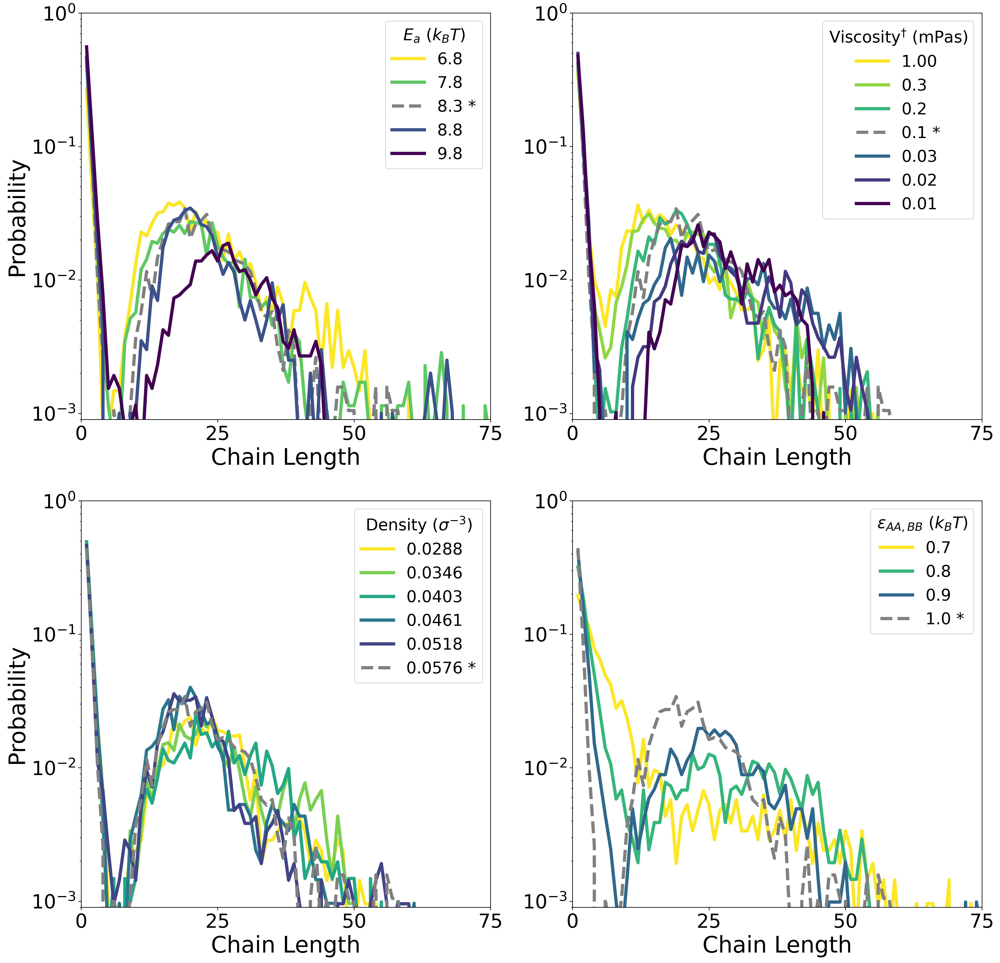

In [8]:
SMALL_SIZE = 20
MEDIUM_SIZE = 24
BIGGER_SIZE = 28

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=BIGGER_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
matplotlib.rcParams['figure.dpi'] = 300


fig,ax = plt.subplots(2,2,figsize=(20,20))

# x = np.linspace(0,50,51);
# x = np.linspace(1,50,50);
x = np.linspace(1,350,350);
lw = 4.


barPlt1 = ax[0,0].plot(x,ChainDistB1/np.sum(ChainDistB1),color=cmap_cb2(color_ids_Bar[4]),linewidth=lw)
barPlt2 = ax[0,0].plot(x,ChainDistB2/np.sum(ChainDistB2),color=cmap_cb2(color_ids_Bar[3]),linewidth=lw)
barPltS = ax[0,0].plot(x,ChainDistS/np.sum(ChainDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
barPlt3 = ax[0,0].plot(x,ChainDistB3/np.sum(ChainDistB3),color=cmap_cb2(color_ids_Bar[1]),linewidth=lw)
barPlt4 = ax[0,0].plot(x,ChainDistB4/np.sum(ChainDistB4),color=cmap_cb2(color_ids_Bar[0]),linewidth=lw)
ax[0,0].set_yscale('log')
ax[0,0].set_xlim((0,75))
ax[0,0].set_ylim((9e-4,1))
ax[0,0].set_xticks([0,25,50,75])
ax[0,0].legend(('6.8','7.8','8.3 *','8.8', '9.8'), title=r'$E_{a} \ (k_{B}T)$')
ax[0,0].set_xlabel('Chain Length')
ax[0,0].set_ylabel('Probability');


dampPlt1 = ax[0,1].plot(x,ChainDistD1/np.sum(ChainDistD1),color=cmap_cb2(color_ids_Damp[6]),linewidth=lw)
dampPlt1ZZ = ax[0,1].plot(x,ChainDistD2/np.sum(ChainDistD2),color=cmap_cb2(color_ids_Damp[5]),linewidth=lw)
dampPlt2 = ax[0,1].plot(x,ChainDistD3/np.sum(ChainDistD3),color=cmap_cb2(color_ids_Damp[4]),linewidth=lw)
dampPltS = ax[0,1].plot(x,ChainDistS/np.sum(ChainDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
dampPlt2ZZ = ax[0,1].plot(x,ChainDistD4/np.sum(ChainDistD4),color=cmap_cb2(color_ids_Damp[2]),linewidth=lw)
dampPlt3 = ax[0,1].plot(x,ChainDistD5/np.sum(ChainDistD5),color=cmap_cb2(color_ids_Damp[1]),linewidth=lw)
dampPlt4 = ax[0,1].plot(x,ChainDistD6/np.sum(ChainDistD6),color=cmap_cb2(color_ids_Damp[0]),linewidth=lw)
ax[0,1].set_yscale('log')
ax[0,1].set_xlim((0,75))
ax[0,1].set_ylim((9e-4,1))
ax[0,1].set_xticks([0,25,50,75])
ax[0,1].legend(('1.00','0.3','0.2','0.1 *','0.03','0.02','0.01'), title=r'Viscosity$^{\dagger}$ (mPas)')
ax[0,1].set_xlabel('Chain Length')
#ax[0,1].set_ylabel('Probability');

denPlt1 = ax[1,0].plot(x,ChainDistDen1/np.sum(ChainDistDen1),color=cmap_cb2(color_ids_Dens[0]),linewidth=lw)
denPlt2 = ax[1,0].plot(x,ChainDistDen2/np.sum(ChainDistDen2),color=cmap_cb2(color_ids_Dens[1]),linewidth=lw)
denPlt3 = ax[1,0].plot(x,ChainDistDen3/np.sum(ChainDistDen3),color=cmap_cb2(color_ids_Dens[2]),linewidth=lw)
denPlt4 = ax[1,0].plot(x,ChainDistDen4/np.sum(ChainDistDen4),color=cmap_cb2(color_ids_Dens[3]),linewidth=lw)
denPlt5 = ax[1,0].plot(x,ChainDistDen5/np.sum(ChainDistDen5),color=cmap_cb2(color_ids_Dens[4]),linewidth=lw)
denPltS = ax[1,0].plot(x,ChainDistS/np.sum(ChainDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
ax[1,0].set_yscale('log')
ax[1,0].set_xlim((0,75))
ax[1,0].set_ylim((9e-4,1))
ax[1,0].set_xticks([0,25,50,75])
ax[1,0].legend(('0.0288','0.0346','0.0403','0.0461','0.0518','0.0576 *'), title=r'Density ($\sigma^{-3}$)');
ax[1,0].set_xlabel('Chain Length')
ax[1,0].set_ylabel('Probability');


epsPlt1 = ax[1,1].plot(x,ChainDistEps1/np.sum(ChainDistEps1),color=cmap_cb2(color_ids_eps[0]),linewidth=lw)
epsPlt2 = ax[1,1].plot(x,ChainDistEps2/np.sum(ChainDistEps2),color=cmap_cb2(color_ids_eps[1]),linewidth=lw)
epsPlt3 = ax[1,1].plot(x,ChainDistEps3/np.sum(ChainDistEps3),color=cmap_cb2(color_ids_eps[2]),linewidth=lw)
epsPltS = ax[1,1].plot(x,ChainDistS/np.sum(ChainDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
ax[1,1].set_yscale('log')
ax[1,1].set_xlim((0,75))
ax[1,1].set_ylim((9e-4,1))
ax[1,1].set_xticks([0,25,50,75])
ax[1,1].legend(('0.7','0.8','0.9','1.0 *'), title=r'$\epsilon_{AA,BB} \ (k_{B}T)$');
ax[1,1].set_xlabel('Chain Length');
#ax[1,1].set_ylabel('Probability');
fig.savefig('copoly3_ChainDist.png',dpi=300, bbox_inches='tight')

## Block Length Distribution

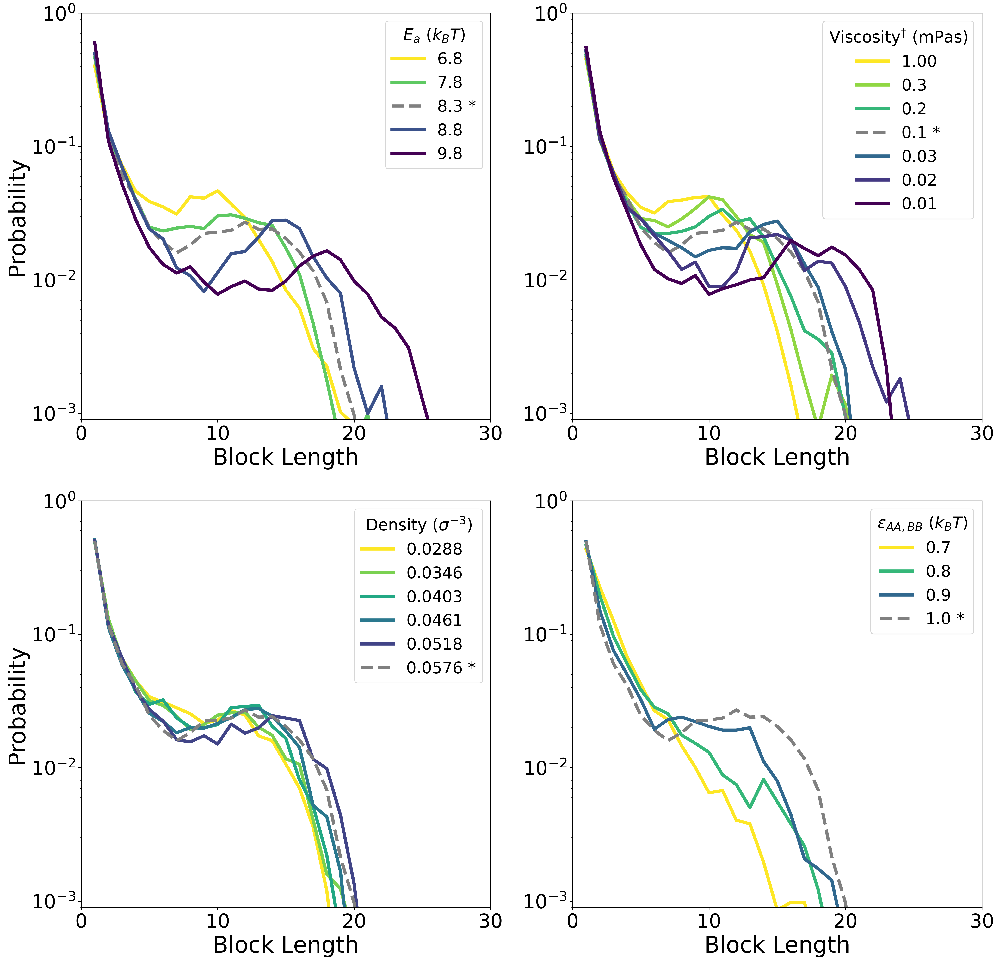

In [9]:
SMALL_SIZE = 20
MEDIUM_SIZE = 24
BIGGER_SIZE = 28

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=BIGGER_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
matplotlib.rcParams['figure.dpi'] = 300


fig,ax = plt.subplots(2,2,figsize=(20,20))

# x = np.linspace(0,50,51);
# x = np.linspace(1,50,50);
x = np.linspace(1,150,150);
lw = 4.


barPlt1 = ax[0,0].plot(x,BlockDistB1/np.sum(BlockDistB1),color=cmap_cb2(color_ids_Bar[4]),linewidth=lw)
barPlt2 = ax[0,0].plot(x,BlockDistB2/np.sum(BlockDistB2),color=cmap_cb2(color_ids_Bar[3]),linewidth=lw)
barPltS = ax[0,0].plot(x,BlockDistS/np.sum(BlockDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
barPlt3 = ax[0,0].plot(x,BlockDistB3/np.sum(BlockDistB3),color=cmap_cb2(color_ids_Bar[1]),linewidth=lw)
barPlt4 = ax[0,0].plot(x,BlockDistB4/np.sum(BlockDistB4),color=cmap_cb2(color_ids_Bar[0]),linewidth=lw)
ax[0,0].set_yscale('log')
ax[0,0].set_xlim((0,30))
ax[0,0].set_ylim((9e-4,1))
ax[0,0].set_xticks([0,10,20,30])
ax[0,0].legend(('6.8','7.8','8.3 *','8.8', '9.8'), title=r'$E_{a} \ (k_{B}T)$')
ax[0,0].set_xlabel('Block Length')
ax[0,0].set_ylabel('Probability');


dampPlt1 = ax[0,1].plot(x,BlockDistD1/np.sum(BlockDistD1),color=cmap_cb2(color_ids_Damp[6]),linewidth=lw)
dampPlt1ZZ = ax[0,1].plot(x,BlockDistD2/np.sum(BlockDistD2),color=cmap_cb2(color_ids_Damp[5]),linewidth=lw)
dampPlt2 = ax[0,1].plot(x,BlockDistD3/np.sum(BlockDistD3),color=cmap_cb2(color_ids_Damp[4]),linewidth=lw)
dampPltS = ax[0,1].plot(x,BlockDistS/np.sum(BlockDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
dampPlt2ZZ = ax[0,1].plot(x,BlockDistD4/np.sum(BlockDistD4),color=cmap_cb2(color_ids_Damp[2]),linewidth=lw)
dampPlt3 = ax[0,1].plot(x,BlockDistD5/np.sum(BlockDistD5),color=cmap_cb2(color_ids_Damp[1]),linewidth=lw)
dampPlt4 = ax[0,1].plot(x,BlockDistD6/np.sum(BlockDistD6),color=cmap_cb2(color_ids_Damp[0]),linewidth=lw)
ax[0,1].set_yscale('log')
ax[0,1].set_xlim((0,30))
ax[0,1].set_ylim((9e-4,1))
ax[0,1].set_xticks([0,10,20,30])
ax[0,1].legend(('1.00','0.3','0.2','0.1 *','0.03','0.02','0.01'), title=r'Viscosity$^{\dagger}$ (mPas)')
ax[0,1].set_xlabel('Block Length')
#ax[0,1].set_ylabel('Probability');

denPlt1 = ax[1,0].plot(x,BlockDistDen1/np.sum(BlockDistDen1),color=cmap_cb2(color_ids_Dens[0]),linewidth=lw)
denPlt2 = ax[1,0].plot(x,BlockDistDen2/np.sum(BlockDistDen2),color=cmap_cb2(color_ids_Dens[1]),linewidth=lw)
denPlt3 = ax[1,0].plot(x,BlockDistDen3/np.sum(BlockDistDen3),color=cmap_cb2(color_ids_Dens[2]),linewidth=lw)
denPlt4 = ax[1,0].plot(x,BlockDistDen4/np.sum(BlockDistDen4),color=cmap_cb2(color_ids_Dens[3]),linewidth=lw)
denPlt5 = ax[1,0].plot(x,BlockDistDen5/np.sum(BlockDistDen5),color=cmap_cb2(color_ids_Dens[4]),linewidth=lw)
denPltS = ax[1,0].plot(x,BlockDistS/np.sum(BlockDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
ax[1,0].set_yscale('log')
ax[1,0].set_xlim((0,30))
ax[1,0].set_ylim((9e-4,1))
ax[1,0].set_xticks([0,10,20,30])
ax[1,0].legend(('0.0288','0.0346','0.0403','0.0461','0.0518','0.0576 *'), title=r'Density ($\sigma^{-3}$)');
ax[1,0].set_xlabel('Block Length')
ax[1,0].set_ylabel('Probability');


epsPlt1 = ax[1,1].plot(x,BlockDistEps1/np.sum(BlockDistEps1),color=cmap_cb2(color_ids_eps[0]),linewidth=lw)
epsPlt2 = ax[1,1].plot(x,BlockDistEps2/np.sum(BlockDistEps2),color=cmap_cb2(color_ids_eps[1]),linewidth=lw)
epsPlt3 = ax[1,1].plot(x,BlockDistEps3/np.sum(BlockDistEps3),color=cmap_cb2(color_ids_eps[2]),linewidth=lw)
epsPltS = ax[1,1].plot(x,BlockDistS/np.sum(BlockDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
ax[1,1].set_yscale('log')
ax[1,1].set_xlim((0,30))
ax[1,1].set_ylim((9e-4,1))
ax[1,1].set_xticks([0,10,20,30])
ax[1,1].legend(('0.7','0.8','0.9','1.0 *'), title=r'$\epsilon_{AA,BB} \ (k_{B}T)$');
ax[1,1].set_xlabel('Block Length');
#ax[1,1].set_ylabel('Probability');
fig.savefig('copoly3_BlockDist.png',dpi=300, bbox_inches='tight')

## Bonding Populations

In [10]:
#rxn = [monos_rxn , dimers_rxn, oligos_rxn, all_rxn, all_bond_pairs]
#      0           1        2        3          4           5           6        7                 8           9       10   11       12     13         14              15         16    17
#[extent_avg,order_avg,tstep_avg,probs_avg,blockAtotal,blockBtotal,chaindist,BlockA_PDI_avg,BlockB_PDI_avg,PDI_avg,pA_avg,pB_avg,seqs_all,Xn_avg,TotalBlock_PDI_avg,RDFs_avg,RDF2_avg,rxn]
rxn_plot = []
for n,sim in enumerate(sims):
    longest_chain = int(len(sim[6]))
    n_range = list(np.linspace(1,longest_chain,longest_chain).astype(int))
    p = sim[0]
    sim_dop = sim[13]
    monos_rxn = sim[17][0]
    dimers_rxn = sim[17][1]
    oligos_rxn = sim[17][2]
    all_rxn = sim[17][3]
    all_bond_pairs = sim[17][4]
    
      
        
    monos_chains_frac = np.zeros(len(p))
    dimers_chains_frac = np.zeros(len(p))
    oligos_chains_frac = np.zeros(len(p))
    oligos_rxn_alt = np.zeros(len(p))

    shorter_chains_frac = np.zeros(len(p))
    avg_chains_frac = np.zeros(len(p))
    longer_chains_frac = np.zeros(len(p))

    for i in range(len(all_rxn)):
        if i==0:
            monos_chains_frac[i] = 1
        else:
            if np.sum(all_rxn[i][1][:]) == 0.:
                monos_chains_frac[i] = monos_chains_frac[i-1]
                dimers_chains_frac[i] = dimers_chains_frac[i-1]
                oligos_chains_frac[i] = oligos_chains_frac[i-1]

                shorter_chains_frac[i] = shorter_chains_frac[i-1]
                avg_chains_frac[i] = avg_chains_frac[i-1]
                longer_chains_frac[i] = longer_chains_frac[i-1]
            else:
                avg_len_index = int(np.floor(sim_dop[i])-1)
                for pair in all_bond_pairs[i]:
                    if pair[0] > 2:
                        oligos_rxn_alt[i]+=1
                oligos_rxn_alt[i]/=len(all_bond_pairs[i])
                
                
                monos_chains_frac[i] = all_rxn[i][1][0]/np.sum(all_rxn[i][1][:])
                dimers_chains_frac[i] = all_rxn[i][1][1]/np.sum(all_rxn[i][1][:])
                oligos_chains_frac[i] = np.sum(all_rxn[i][1][2:])/np.sum(all_rxn[i][1][:])

                shorter_chains_frac[i] = np.sum(all_rxn[i][1][0:avg_len_index])/np.sum(all_rxn[i][1][:])
                avg_chains_frac[i] = np.sum(all_rxn[i][1][avg_len_index:avg_len_index+1])/np.sum(all_rxn[i][1][:])
                longer_chains_frac[i] = np.sum(all_rxn[i][1][avg_len_index+1:])/np.sum(all_rxn[i][1][:])

    sum_chains_frac = monos_chains_frac + dimers_chains_frac + oligos_chains_frac
    
    
    
    window = 10
    monos_chains_avg = uniform_filter1d(monos_chains_frac,window,mode='reflect')
    dimers_chains_avg = uniform_filter1d(dimers_chains_frac,window,mode='reflect')
    oligos_chains_avg = uniform_filter1d(oligos_chains_frac,window, mode='reflect')
    sum_chains_avg = uniform_filter1d(sum_chains_frac,window, mode='reflect')
    
    shorter_chains_avg = uniform_filter1d(shorter_chains_frac,window, mode='reflect')
    avg_chains_avg = uniform_filter1d(avg_chains_frac,window, mode='reflect')
    longer_chains_avg = uniform_filter1d(longer_chains_frac,window, mode='reflect')

#     window = 50
#     monos_chains_avg_bigwindow =  uniform_filter1d(monos_chains_frac,window,mode='reflect')
#     dimers_chains_avg_bigwindow =  uniform_filter1d(dimers_chains_frac,window,mode='reflect')
#     oligos_chains_avg_bigwindow =  uniform_filter1d(oligos_chains_frac,window,mode='reflect')
    
#     oligos_rxn_avg_bigwindow = uniform_filter1d(oligos_rxn,window,mode='reflect')
#     oligos_rxn_alt_avg_bigwindow = uniform_filter1d(oligos_rxn_alt,window,mode='reflect')
    
#     sum_chains_avg_bigwindow =  uniform_filter1d(sum_chains_frac,window,mode='reflect')
#     shorter_chains_avg_bigwindow = uniform_filter1d(shorter_chains_frac,window, mode='reflect')
#     avg_chains_avg_bigwindow = uniform_filter1d(avg_chains_frac,window, mode='reflect')
#     longer_chains_avg_bigwindow = uniform_filter1d(longer_chains_frac,window, mode='reflect')
    
    
    window = 50
    multiplier = 5
    split_index = int(np.floor(len(p)/2))
    monos_chains_avg_bigwindow =  np.concatenate((uniform_filter1d(monos_chains_frac[0:split_index],window,mode='nearest'),uniform_filter1d(monos_chains_frac[split_index:],multiplier*window,mode='reflect')))
    dimers_chains_avg_bigwindow =  np.concatenate((uniform_filter1d(dimers_chains_frac[0:split_index],window,mode='nearest'),uniform_filter1d(dimers_chains_frac[split_index:],multiplier*window,mode='reflect')))
    oligos_chains_avg_bigwindow =  np.concatenate((uniform_filter1d(oligos_chains_frac[0:split_index],window,mode='nearest'),uniform_filter1d(oligos_chains_frac[split_index:],multiplier*window,mode='reflect')))
    
    oligos_rxn_avg_bigwindow = np.concatenate((uniform_filter1d(oligos_rxn[0:split_index],window,mode='nearest'),uniform_filter1d(oligos_rxn[split_index:],multiplier*window,mode='reflect')))
    oligos_rxn_alt_avg_bigwindow = np.concatenate((uniform_filter1d(oligos_rxn_alt[0:split_index],window,mode='nearest'),uniform_filter1d(oligos_rxn_alt[split_index:],multiplier*window,mode='reflect')))
    
    sum_chains_avg_bigwindow =  np.concatenate((uniform_filter1d(sum_chains_frac[0:split_index],window,mode='nearest'),uniform_filter1d(sum_chains_frac[split_index:],multiplier*window,mode='reflect')))
    shorter_chains_avg_bigwindow = np.concatenate((uniform_filter1d(shorter_chains_frac[0:split_index],window, mode='nearest'),uniform_filter1d(shorter_chains_frac[split_index:],multiplier*window,mode='reflect')))
    avg_chains_avg_bigwindow = np.concatenate((uniform_filter1d(avg_chains_frac[0:split_index],window, mode='nearest'),uniform_filter1d(avg_chains_frac[split_index:],multiplier*window,mode='reflect')))
    longer_chains_avg_bigwindow = np.concatenate((uniform_filter1d(longer_chains_frac[0:split_index],window, mode='nearest'),uniform_filter1d(longer_chains_frac[split_index:],multiplier*window,mode='reflect')))
    
    
    

    rxn_plot.append([monos_chains_avg,dimers_chains_avg,oligos_chains_avg,sum_chains_avg,
                     monos_chains_avg_bigwindow,dimers_chains_avg_bigwindow,oligos_chains_avg_bigwindow,sum_chains_avg_bigwindow,
                     oligos_rxn_alt_avg_bigwindow,shorter_chains_avg_bigwindow,avg_chains_avg_bigwindow,longer_chains_avg_bigwindow])



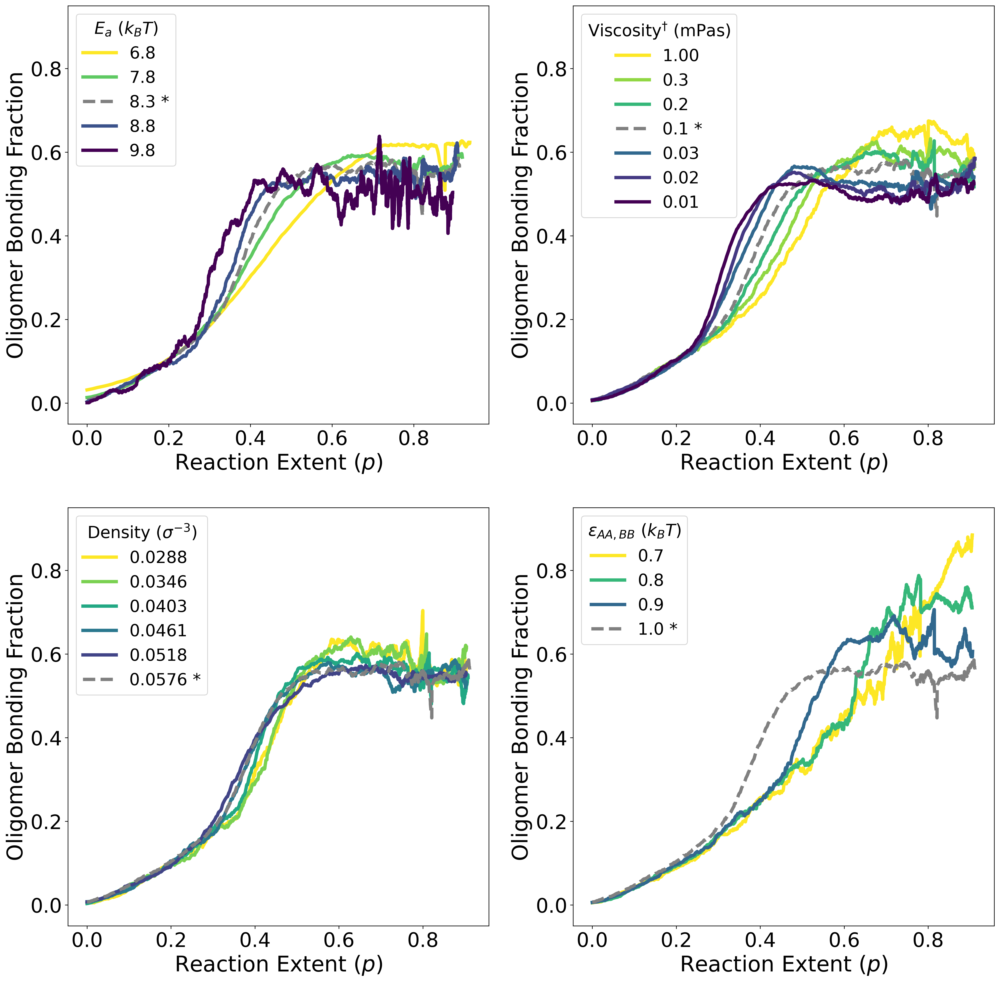

In [11]:
fig,ax = plt.subplots(2,2,figsize=(20,20))


barPlt1 = ax[0,0].plot(sims[1][0],rxn_plot[1][6],color=cmap_cb2(color_ids_Bar[4]),linewidth=lw)
barPlt2 = ax[0,0].plot(sims[2][0],rxn_plot[2][6],color=cmap_cb2(color_ids_Bar[3]),linewidth=lw)
barPltS = ax[0,0].plot(sims[0][0],rxn_plot[0][6],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
barPlt3 = ax[0,0].plot(sims[3][0],rxn_plot[3][6],color=cmap_cb2(color_ids_Bar[1]),linewidth=lw)
barPlt4 = ax[0,0].plot(sims[4][0],rxn_plot[4][6],color=cmap_cb2(color_ids_Bar[0]),linewidth=lw)
#ax[0,0].set_yscale('log')
#ax[0,0].set_xlim((0,30))
ax[0,0].set_ylim((-0.05,0.95))
#ax[0,0].set_xticks([0,10,20,30])
ax[0,0].legend(('6.8','7.8','8.3 *','8.8', '9.8'), title=r'$E_{a} \ (k_{B}T)$')
ax[0,0].set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
ax[0,0].set_ylabel('Oligomer Bonding Fraction',fontsize=26);


dampPlt1 = ax[0,1].plot(sims[10][0],rxn_plot[10][6],color=cmap_cb2(color_ids_Damp[6]),linewidth=lw)
dampPlt1ZZ = ax[0,1].plot(sims[11][0],rxn_plot[11][6],color=cmap_cb2(color_ids_Damp[5]),linewidth=lw)
dampPlt2 = ax[0,1].plot(sims[12][0],rxn_plot[12][6],color=cmap_cb2(color_ids_Damp[4]),linewidth=lw)
dampPltS = ax[0,1].plot(sims[0][0],rxn_plot[0][6],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
dampPlt2ZZ = ax[0,1].plot(sims[13][0],rxn_plot[13][6],color=cmap_cb2(color_ids_Damp[2]),linewidth=lw)
dampPlt3 = ax[0,1].plot(sims[14][0],rxn_plot[14][6],color=cmap_cb2(color_ids_Damp[1]),linewidth=lw)
dampPlt4 = ax[0,1].plot(sims[15][0],rxn_plot[15][6],color=cmap_cb2(color_ids_Damp[0]),linewidth=lw)
# ax[0,1].set_yscale('log')
# ax[0,1].set_xlim((0,30))
ax[0,1].set_ylim((-0.05,0.95))
# ax[0,1].set_xticks([0,10,20,30])
ax[0,1].legend(('1.00','0.3','0.2','0.1 *','0.03','0.02','0.01'), title=r'Viscosity$^{\dagger}$ (mPas)')
ax[0,1].set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
ax[0,1].set_ylabel('Oligomer Bonding Fraction',fontsize=26);

denPlt1 = ax[1,0].plot(sims[5][0],rxn_plot[5][6],color=cmap_cb2(color_ids_Dens[0]),linewidth=lw)
denPlt2 = ax[1,0].plot(sims[6][0],rxn_plot[6][6],color=cmap_cb2(color_ids_Dens[1]),linewidth=lw)
denPlt3 = ax[1,0].plot(sims[7][0],rxn_plot[7][6],color=cmap_cb2(color_ids_Dens[2]),linewidth=lw)
denPlt4 = ax[1,0].plot(sims[8][0],rxn_plot[8][6],color=cmap_cb2(color_ids_Dens[3]),linewidth=lw)
denPlt5 = ax[1,0].plot(sims[9][0],rxn_plot[9][6],color=cmap_cb2(color_ids_Dens[4]),linewidth=lw)
denPltS = ax[1,0].plot(sims[0][0],rxn_plot[0][6],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
# ax[1,0].set_yscale('log')
# ax[1,0].set_xlim((0,30))
ax[1,0].set_ylim((-0.05,0.95))
# ax[1,0].set_xticks([0,10,20,30])
ax[1,0].legend(('0.0288','0.0346','0.0403','0.0461','0.0518','0.0576 *'), title=r'Density ($\sigma^{-3}$)');
ax[1,0].set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
ax[1,0].set_ylabel('Oligomer Bonding Fraction',fontsize=26);


epsPlt1 = ax[1,1].plot(sims[16][0],rxn_plot[16][6],color=cmap_cb2(color_ids_eps[0]),linewidth=lw)
epsPlt2 = ax[1,1].plot(sims[17][0],rxn_plot[17][6],color=cmap_cb2(color_ids_eps[1]),linewidth=lw)
epsPlt3 = ax[1,1].plot(sims[18][0],rxn_plot[18][6],color=cmap_cb2(color_ids_eps[2]),linewidth=lw)
epsPltS = ax[1,1].plot(sims[0][0],rxn_plot[0][6],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
# ax[1,1].set_yscale('log')
# ax[1,1].set_xlim((0,30))
ax[1,1].set_ylim((-0.05,0.95))
# ax[1,1].set_xticks([0,10,20,30])
ax[1,1].legend(('0.7','0.8','0.9','1.0 *'), title=r'$\epsilon_{AA,BB} \ (k_{B}T)$');
ax[1,1].set_xlabel(r'Reaction Extent ($p$)',fontsize=26);
ax[1,1].set_ylabel('Oligomer Bonding Fraction',fontsize=26);
fig.savefig('copoly3_BondPop.png',dpi=300, bbox_inches='tight')

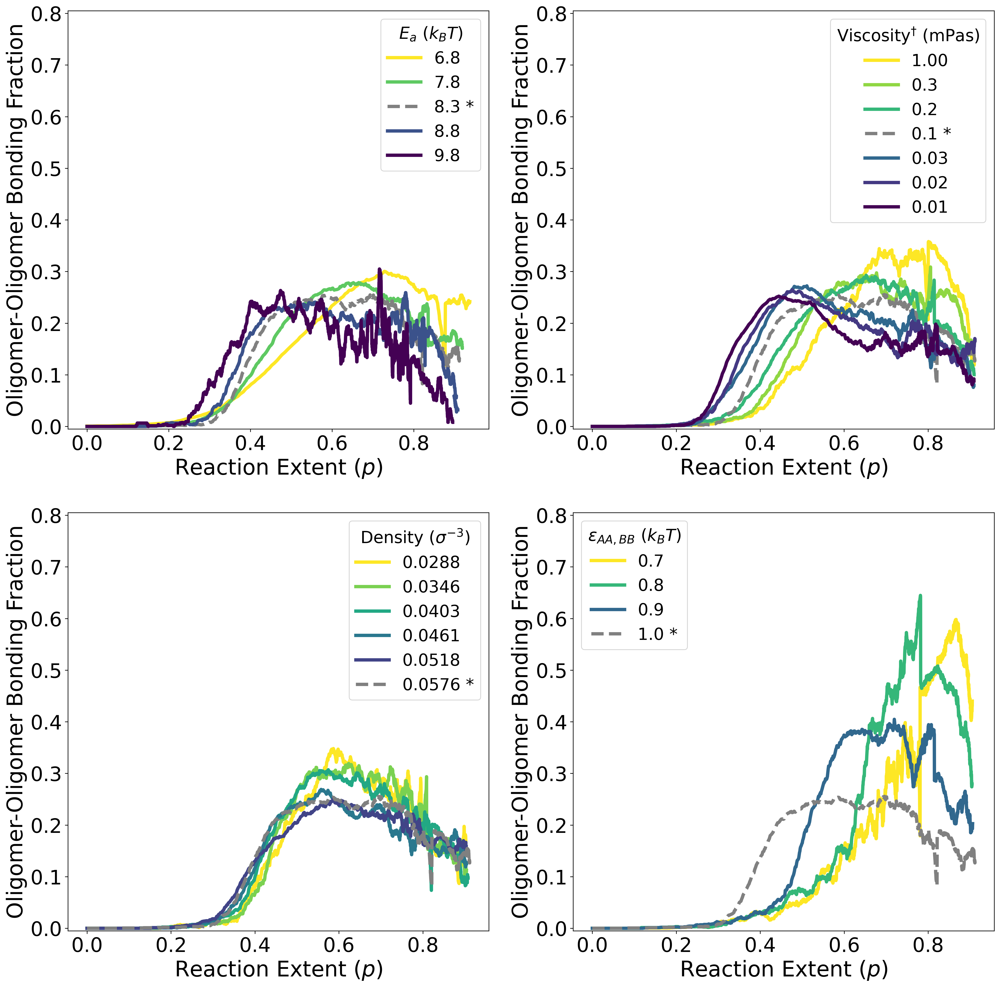

In [12]:
fig,ax = plt.subplots(2,2,figsize=(20,20))


barPlt1 = ax[0,0].plot(sims[1][0],rxn_plot[1][8],color=cmap_cb2(color_ids_Bar[4]),linewidth=lw)
barPlt2 = ax[0,0].plot(sims[2][0],rxn_plot[2][8],color=cmap_cb2(color_ids_Bar[3]),linewidth=lw)
barPltS = ax[0,0].plot(sims[0][0],rxn_plot[0][8],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
barPlt3 = ax[0,0].plot(sims[3][0],rxn_plot[3][8],color=cmap_cb2(color_ids_Bar[1]),linewidth=lw)
barPlt4 = ax[0,0].plot(sims[4][0],rxn_plot[4][8],color=cmap_cb2(color_ids_Bar[0]),linewidth=lw)
#ax[0,0].set_yscale('log')
#ax[0,0].set_xlim((0,30))
ax[0,0].set_ylim((-0.005,0.805))
#ax[0,0].set_xticks([0,10,20,30])
ax[0,0].legend(('6.8','7.8','8.3 *','8.8', '9.8'), title=r'$E_{a} \ (k_{B}T)$')
ax[0,0].set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
ax[0,0].set_ylabel('Oligomer-Oligomer Bonding Fraction',fontsize=26);


dampPlt1 = ax[0,1].plot(sims[10][0],rxn_plot[10][8],color=cmap_cb2(color_ids_Damp[6]),linewidth=lw)
dampPlt1ZZ = ax[0,1].plot(sims[11][0],rxn_plot[11][8],color=cmap_cb2(color_ids_Damp[5]),linewidth=lw)
dampPlt2 = ax[0,1].plot(sims[12][0],rxn_plot[12][8],color=cmap_cb2(color_ids_Damp[4]),linewidth=lw)
dampPltS = ax[0,1].plot(sims[0][0],rxn_plot[0][8],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
dampPlt2ZZ = ax[0,1].plot(sims[13][0],rxn_plot[13][8],color=cmap_cb2(color_ids_Damp[2]),linewidth=lw)
dampPlt3 = ax[0,1].plot(sims[14][0],rxn_plot[14][8],color=cmap_cb2(color_ids_Damp[1]),linewidth=lw)
dampPlt4 = ax[0,1].plot(sims[15][0],rxn_plot[15][8],color=cmap_cb2(color_ids_Damp[0]),linewidth=lw)
# ax[0,1].set_yscale('log')
# ax[0,1].set_xlim((0,30))
ax[0,1].set_ylim((-0.005,0.805))
# ax[0,1].set_xticks([0,10,20,30])
ax[0,1].legend(('1.00','0.3','0.2','0.1 *','0.03','0.02','0.01'), title=r'Viscosity$^{\dagger}$ (mPas)')
ax[0,1].set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
ax[0,1].set_ylabel('Oligomer-Oligomer Bonding Fraction',fontsize=26);

denPlt1 = ax[1,0].plot(sims[5][0],rxn_plot[5][8],color=cmap_cb2(color_ids_Dens[0]),linewidth=lw)
denPlt2 = ax[1,0].plot(sims[6][0],rxn_plot[6][8],color=cmap_cb2(color_ids_Dens[1]),linewidth=lw)
denPlt3 = ax[1,0].plot(sims[7][0],rxn_plot[7][8],color=cmap_cb2(color_ids_Dens[2]),linewidth=lw)
denPlt4 = ax[1,0].plot(sims[8][0],rxn_plot[8][8],color=cmap_cb2(color_ids_Dens[3]),linewidth=lw)
denPlt5 = ax[1,0].plot(sims[9][0],rxn_plot[9][8],color=cmap_cb2(color_ids_Dens[4]),linewidth=lw)
denPltS = ax[1,0].plot(sims[0][0],rxn_plot[0][8],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
# ax[1,0].set_yscale('log')
# ax[1,0].set_xlim((0,30))
ax[1,0].set_ylim((-0.005,0.805))
# ax[1,0].set_xticks([0,10,20,30])
ax[1,0].legend(('0.0288','0.0346','0.0403','0.0461','0.0518','0.0576 *'), title=r'Density ($\sigma^{-3}$)');
ax[1,0].set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
ax[1,0].set_ylabel('Oligomer-Oligomer Bonding Fraction',fontsize=26);


epsPlt1 = ax[1,1].plot(sims[16][0],rxn_plot[16][8],color=cmap_cb2(color_ids_eps[0]),linewidth=lw)
epsPlt2 = ax[1,1].plot(sims[17][0],rxn_plot[17][8],color=cmap_cb2(color_ids_eps[1]),linewidth=lw)
epsPlt3 = ax[1,1].plot(sims[18][0],rxn_plot[18][8],color=cmap_cb2(color_ids_eps[2]),linewidth=lw)
epsPltS = ax[1,1].plot(sims[0][0],rxn_plot[0][8],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
# ax[1,1].set_yscale('log')
# ax[1,1].set_xlim((0,30))
ax[1,1].set_ylim((-0.005,0.805))
# ax[1,1].set_xticks([0,10,20,30])
ax[1,1].legend(('0.7','0.8','0.9','1.0 *'), title=r'$\epsilon_{AA,BB} \ (k_{B}T)$');
ax[1,1].set_xlabel(r'Reaction Extent ($p$)',fontsize=26);
ax[1,1].set_ylabel('Oligomer-Oligomer Bonding Fraction',fontsize=26);
fig.savefig('copoly3_Oligo-Oligo_BondPop.png',dpi=300, bbox_inches='tight')

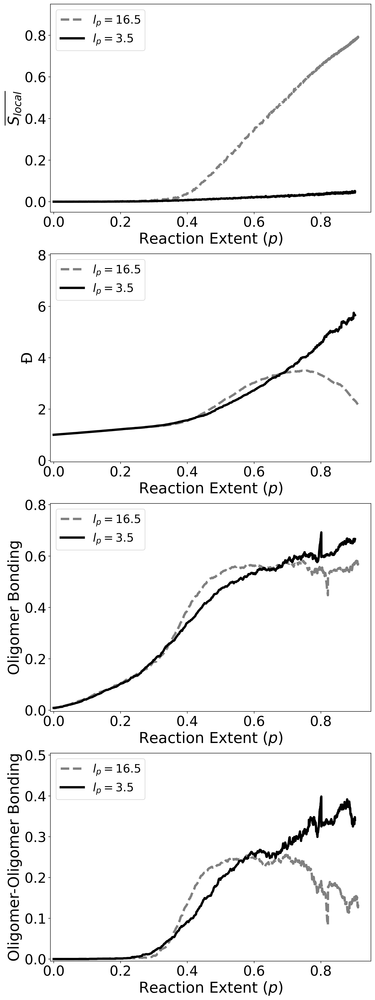

In [13]:
fig,ax = plt.subplots(4,1,figsize=(10,30))
simid=19
end = -1
flex_color='k'


Sloc_PltS = ax[0].plot(sims[0][0],sims[0][1],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
Sloc_PltFlex = ax[0].plot(sims[simid][0],sims[simid][1],color=flex_color,linewidth=lw)

ax[0].set_xlim(-0.01, 0.95)
ax[0].set_ylim((-0.05,0.95))
ax[0].legend((r'$l_p=16.5$',r'$l_p=3.5$'))
ax[0].set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
ax[0].set_ylabel(r'$\overline{S_{local}}$',fontsize=26);


PDI_PltS = ax[1].plot(sims[0][0],sims[0][9],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
PDI_PltFlex = ax[1].plot(sims[simid][0],sims[simid][9],color=flex_color,linewidth=lw)

ax[1].set_xlim(-0.01, 0.95)
ax[1].set_ylim((-0.05,8.05))
ax[1].legend((r'$l_p=16.5$',r'$l_p=3.5$'),loc='upper left')
ax[1].set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
ax[1].set_ylabel(u'\u0110',fontsize=26);




O_PltS = ax[2].plot(sims[0][0][:end],rxn_plot[0][6][:end],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
O_PltFlex = ax[2].plot(sims[simid][0][:end],rxn_plot[simid][6][:end],color=flex_color,linewidth=lw)

ax[2].set_xlim(-0.01, 0.95)
ax[2].set_ylim((-0.005,0.805))
ax[2].legend((r'$l_p=16.5$',r'$l_p=3.5$'))
ax[2].set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
ax[2].set_ylabel('Oligomer Bonding',fontsize=26);

OO_PltS = ax[3].plot(sims[0][0][:end],rxn_plot[0][8][:end],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
OO_PltFlex = ax[3].plot(sims[simid][0][:end],rxn_plot[simid][8][:end],color=flex_color,linewidth=lw)

ax[3].set_ylim((-0.005,0.505))
ax[3].set_xlim(-0.01, 0.95)
ax[3].legend((r'$l_p=16.5$',r'$l_p=3.5$'))
ax[3].set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
ax[3].set_ylabel('Oligomer-Oligomer Bonding',fontsize=26);

fig.savefig('copoly3_Flex-Stiff_Oligo-Oligo_vertical_disp_order.png',dpi=300, bbox_inches='tight')

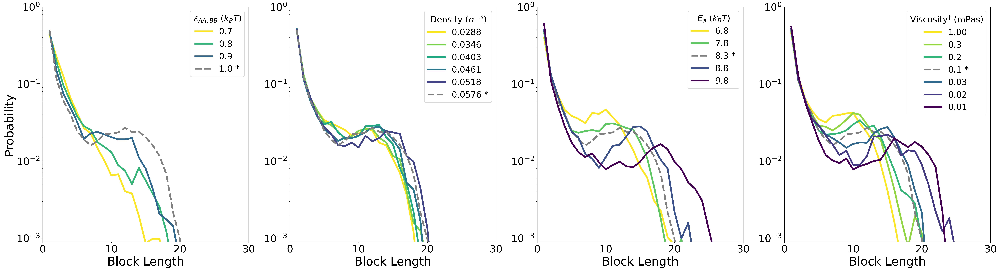

In [14]:
SMALL_SIZE = 20
MEDIUM_SIZE = 24
BIGGER_SIZE = 28

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=BIGGER_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
matplotlib.rcParams['figure.dpi'] = 300

fig,ax = plt.subplots(1,4,figsize=(40,10))



x = np.linspace(1,150,150);
lw = 4.

barPlt1 = ax[2].plot(x,BlockDistB1/np.sum(BlockDistB1),color=cmap_cb2(color_ids_Bar[4]),linewidth=lw)
barPlt2 = ax[2].plot(x,BlockDistB2/np.sum(BlockDistB2),color=cmap_cb2(color_ids_Bar[3]),linewidth=lw)
barPltS = ax[2].plot(x,BlockDistS/np.sum(BlockDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
barPlt3 = ax[2].plot(x,BlockDistB3/np.sum(BlockDistB3),color=cmap_cb2(color_ids_Bar[1]),linewidth=lw)
barPlt4 = ax[2].plot(x,BlockDistB4/np.sum(BlockDistB4),color=cmap_cb2(color_ids_Bar[0]),linewidth=lw)
ax[2].set_yscale('log')
ax[2].set_xlim((0,30))
ax[2].set_ylim((9e-4,1))
ax[2].set_xticks([0,10,20,30])
ax[2].legend(('6.8','7.8','8.3 *','8.8', '9.8'), title=r'$E_{a} \ (k_{B}T)$')
ax[2].set_xlabel('Block Length')
#ax[2].set_ylabel('Probability');


dampPlt1 = ax[3].plot(x,BlockDistD1/np.sum(BlockDistD1),color=cmap_cb2(color_ids_Damp[6]),linewidth=lw)
dampPlt1ZZ = ax[3].plot(x,BlockDistD2/np.sum(BlockDistD2),color=cmap_cb2(color_ids_Damp[5]),linewidth=lw)
dampPlt2 = ax[3].plot(x,BlockDistD3/np.sum(BlockDistD3),color=cmap_cb2(color_ids_Damp[4]),linewidth=lw)
dampPltS = ax[3].plot(x,BlockDistS/np.sum(BlockDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
dampPlt2ZZ = ax[3].plot(x,BlockDistD4/np.sum(BlockDistD4),color=cmap_cb2(color_ids_Damp[2]),linewidth=lw)
dampPlt3 = ax[3].plot(x,BlockDistD5/np.sum(BlockDistD5),color=cmap_cb2(color_ids_Damp[1]),linewidth=lw)
dampPlt4 = ax[3].plot(x,BlockDistD6/np.sum(BlockDistD6),color=cmap_cb2(color_ids_Damp[0]),linewidth=lw)
ax[3].set_yscale('log')
ax[3].set_xlim((0,30))
ax[3].set_ylim((9e-4,1))
ax[3].set_xticks([0,10,20,30])
ax[3].legend(('1.00','0.3','0.2','0.1 *','0.03','0.02','0.01'), title=r'Viscosity$^{\dagger}$ (mPas)')
ax[3].set_xlabel('Block Length')
#ax[3].set_ylabel('Probability');

denPlt1 = ax[1].plot(x,BlockDistDen1/np.sum(BlockDistDen1),color=cmap_cb2(color_ids_Dens[0]),linewidth=lw)
denPlt2 = ax[1].plot(x,BlockDistDen2/np.sum(BlockDistDen2),color=cmap_cb2(color_ids_Dens[1]),linewidth=lw)
denPlt3 = ax[1].plot(x,BlockDistDen3/np.sum(BlockDistDen3),color=cmap_cb2(color_ids_Dens[2]),linewidth=lw)
denPlt4 = ax[1].plot(x,BlockDistDen4/np.sum(BlockDistDen4),color=cmap_cb2(color_ids_Dens[3]),linewidth=lw)
denPlt5 = ax[1].plot(x,BlockDistDen5/np.sum(BlockDistDen5),color=cmap_cb2(color_ids_Dens[4]),linewidth=lw)
denPltS = ax[1].plot(x,BlockDistS/np.sum(BlockDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
ax[1].set_yscale('log')
ax[1].set_xlim((0,30))
ax[1].set_ylim((9e-4,1))
ax[1].set_xticks([0,10,20,30])
ax[1].legend(('0.0288','0.0346','0.0403','0.0461','0.0518','0.0576 *'), title=r'Density ($\sigma^{-3}$)');
ax[1].set_xlabel('Block Length')
#ax[1].set_ylabel('Probability');


epsPlt1 = ax[0].plot(x,BlockDistEps1/np.sum(BlockDistEps1),color=cmap_cb2(color_ids_eps[0]),linewidth=lw)
epsPlt2 = ax[0].plot(x,BlockDistEps2/np.sum(BlockDistEps2),color=cmap_cb2(color_ids_eps[1]),linewidth=lw)
epsPlt3 = ax[0].plot(x,BlockDistEps3/np.sum(BlockDistEps3),color=cmap_cb2(color_ids_eps[2]),linewidth=lw)
epsPltS = ax[0].plot(x,BlockDistS/np.sum(BlockDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
ax[0].set_yscale('log')
ax[0].set_xlim((0,30))
ax[0].set_ylim((9e-4,1))
ax[0].set_xticks([0,10,20,30])
ax[0].legend(('0.7','0.8','0.9','1.0 *'), title=r'$\epsilon_{AA,BB} \ (k_{B}T)$');
ax[0].set_xlabel('Block Length');
ax[0].set_ylabel('Probability');








fig.savefig('copoly3_BlockDist_Shifts.png',dpi=300, bbox_inches='tight')

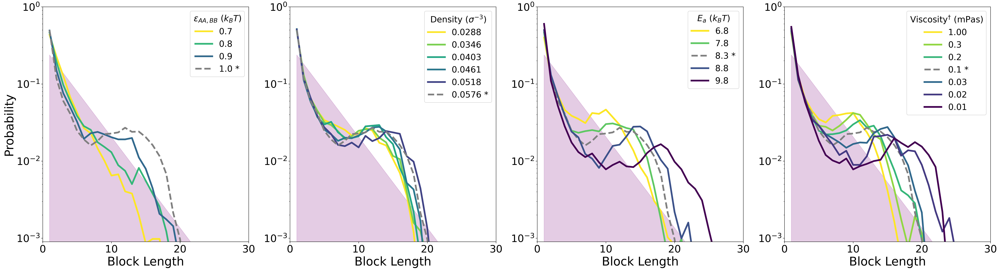

In [15]:
SMALL_SIZE = 20
MEDIUM_SIZE = 24
BIGGER_SIZE = 28

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=BIGGER_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
matplotlib.rcParams['figure.dpi'] = 300

fig,ax = plt.subplots(1,4,figsize=(40,10))



#sim index:
#    0         1          2         3         4            5          6          7                 8           9      10     11       12    13          14
#[extent_avg,order_avg,tstep_avg,probs_avg,blockAtotal,blockBtotal,chaindist,BlockA_PDI_avg,BlockB_PDI_avg,PDI_avg,pA_avg,pB_avg,seqs_all,Xn_avg,TotalBlock_PDI_avg]
# probs_avg index
#[pAA_avg,pAB_avg,pBB_avg]

n_chain = np.linspace(0,150,151)
x = np.linspace(1,150,150);
lw = 4.
#pstar_simid = 16 #for 0.7 kT Markov distribution (purple shaded)
pstar_simid = 0 #for kT Markov distribution (purple shaded)
pstar_M = sims[pstar_simid][0][-1]*(sims[pstar_simid][3][0][-1]+sims[pstar_simid][3][2][-1])
#pstar_M = 0.9*(sims[pstar_simid][3][0][-1]+sims[pstar_simid][3][2][-1])
#pstar_M = 0.9*0.5
Markov_Standard = (1-pstar_M)*pstar_M**(x-1)
#Markov_Standard = (1-pstar_M)*pstar_M**(n_chain-1)


barPlt1 = ax[2].plot(x,BlockDistB1/np.sum(BlockDistB1),color=cmap_cb2(color_ids_Bar[4]),linewidth=lw)
barPlt2 = ax[2].plot(x,BlockDistB2/np.sum(BlockDistB2),color=cmap_cb2(color_ids_Bar[3]),linewidth=lw)
barPltS = ax[2].plot(x,BlockDistS/np.sum(BlockDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
barPlt3 = ax[2].plot(x,BlockDistB3/np.sum(BlockDistB3),color=cmap_cb2(color_ids_Bar[1]),linewidth=lw)
barPlt4 = ax[2].plot(x,BlockDistB4/np.sum(BlockDistB4),color=cmap_cb2(color_ids_Bar[0]),linewidth=lw)
ax[2].set_yscale('log')
ax[2].set_xlim((0,30))
ax[2].set_ylim((9e-4,1))
ax[2].set_xticks([0,10,20,30])
ax[2].legend(('6.8','7.8','8.3 *','8.8', '9.8'), title=r'$E_{a} \ (k_{B}T)$')
ax[2].set_xlabel('Block Length')
#ax[2].set_ylabel('Probability');


dampPlt1 = ax[3].plot(x,BlockDistD1/np.sum(BlockDistD1),color=cmap_cb2(color_ids_Damp[6]),linewidth=lw)
dampPlt1ZZ = ax[3].plot(x,BlockDistD2/np.sum(BlockDistD2),color=cmap_cb2(color_ids_Damp[5]),linewidth=lw)
dampPlt2 = ax[3].plot(x,BlockDistD3/np.sum(BlockDistD3),color=cmap_cb2(color_ids_Damp[4]),linewidth=lw)
dampPltS = ax[3].plot(x,BlockDistS/np.sum(BlockDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
dampPlt2ZZ = ax[3].plot(x,BlockDistD4/np.sum(BlockDistD4),color=cmap_cb2(color_ids_Damp[2]),linewidth=lw)
dampPlt3 = ax[3].plot(x,BlockDistD5/np.sum(BlockDistD5),color=cmap_cb2(color_ids_Damp[1]),linewidth=lw)
dampPlt4 = ax[3].plot(x,BlockDistD6/np.sum(BlockDistD6),color=cmap_cb2(color_ids_Damp[0]),linewidth=lw)
ax[3].set_yscale('log')
ax[3].set_xlim((0,30))
ax[3].set_ylim((9e-4,1))
ax[3].set_xticks([0,10,20,30])
ax[3].legend(('1.00','0.3','0.2','0.1 *','0.03','0.02','0.01'), title=r'Viscosity$^{\dagger}$ (mPas)')
ax[3].set_xlabel('Block Length')
#ax[3].set_ylabel('Probability');

denPlt1 = ax[1].plot(x,BlockDistDen1/np.sum(BlockDistDen1),color=cmap_cb2(color_ids_Dens[0]),linewidth=lw)
denPlt2 = ax[1].plot(x,BlockDistDen2/np.sum(BlockDistDen2),color=cmap_cb2(color_ids_Dens[1]),linewidth=lw)
denPlt3 = ax[1].plot(x,BlockDistDen3/np.sum(BlockDistDen3),color=cmap_cb2(color_ids_Dens[2]),linewidth=lw)
denPlt4 = ax[1].plot(x,BlockDistDen4/np.sum(BlockDistDen4),color=cmap_cb2(color_ids_Dens[3]),linewidth=lw)
denPlt5 = ax[1].plot(x,BlockDistDen5/np.sum(BlockDistDen5),color=cmap_cb2(color_ids_Dens[4]),linewidth=lw)
denPltS = ax[1].plot(x,BlockDistS/np.sum(BlockDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
ax[1].set_yscale('log')
ax[1].set_xlim((0,30))
ax[1].set_ylim((9e-4,1))
ax[1].set_xticks([0,10,20,30])
ax[1].legend(('0.0288','0.0346','0.0403','0.0461','0.0518','0.0576 *'), title=r'Density ($\sigma^{-3}$)');
ax[1].set_xlabel('Block Length')
#ax[1].set_ylabel('Probability');


epsPlt1 = ax[0].plot(x,BlockDistEps1/np.sum(BlockDistEps1),color=cmap_cb2(color_ids_eps[0]),linewidth=lw)
epsPlt2 = ax[0].plot(x,BlockDistEps2/np.sum(BlockDistEps2),color=cmap_cb2(color_ids_eps[1]),linewidth=lw)
epsPlt3 = ax[0].plot(x,BlockDistEps3/np.sum(BlockDistEps3),color=cmap_cb2(color_ids_eps[2]),linewidth=lw)
epsPltS = ax[0].plot(x,BlockDistS/np.sum(BlockDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
ax[0].set_yscale('log')
ax[0].set_xlim((0,30))
ax[0].set_ylim((9e-4,1))
ax[0].set_xticks([0,10,20,30])
ax[0].legend(('0.7','0.8','0.9','1.0 *'), title=r'$\epsilon_{AA,BB} \ (k_{B}T)$');
ax[0].set_xlabel('Block Length');
ax[0].set_ylabel('Probability');






for small_ax in ax:
    #small_ax.bar(x,Markov_Standard,align='center',color='purple',width = 1., alpha=0.2)
    #small_ax.plot(x,Markov_Standard,color='purple',linewidth = lw, alpha=0.2)
    small_ax.fill_between(x,Markov_Standard,9e-4*np.ones(len(Markov_Standard)),color='purple',alpha=0.2)
    #small_ax.fill_between(n_chain,Markov_Standard,9e-4*np.ones(len(Markov_Standard)),color='purple',alpha=0.2)




#fig.savefig('copoly3_BlockDist_Shifts_Markov_0.7kT.png',dpi=300, bbox_inches='tight')
fig.savefig('copoly3_BlockDist_Shifts_Markov_1kT.png',dpi=300, bbox_inches='tight')

In [16]:
SMALL_SIZE = 20
MEDIUM_SIZE = 24
BIGGER_SIZE = 28

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=BIGGER_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
matplotlib.rcParams['figure.dpi'] = 300

fig,ax = plt.subplots(3,4,figsize=(40,30))




x = np.linspace(1,150,150);
lw = 4.


barPlt1 = ax[0,0].plot(x,BlockDistB1/np.sum(BlockDistB1),color=cmap_cb2(color_ids_Bar[4]),linewidth=lw)
barPlt2 = ax[0,0].plot(x,BlockDistB2/np.sum(BlockDistB2),color=cmap_cb2(color_ids_Bar[3]),linewidth=lw)
barPltS = ax[0,0].plot(x,BlockDistS/np.sum(BlockDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
barPlt3 = ax[0,0].plot(x,BlockDistB3/np.sum(BlockDistB3),color=cmap_cb2(color_ids_Bar[1]),linewidth=lw)
barPlt4 = ax[0,0].plot(x,BlockDistB4/np.sum(BlockDistB4),color=cmap_cb2(color_ids_Bar[0]),linewidth=lw)
ax[0,0].set_yscale('log')
ax[0,0].set_xlim((0,30))
ax[0,0].set_ylim((9e-4,1))
ax[0,0].set_xticks([0,10,20,30])
ax[0,0].legend(('6.8','7.8','8.3 *','8.8', '9.8'), title=r'$E_{a} \ (k_{B}T)$')
ax[0,0].set_xlabel('Block Length')
ax[0,0].set_ylabel('Probability');


dampPlt1 = ax[0,1].plot(x,BlockDistD1/np.sum(BlockDistD1),color=cmap_cb2(color_ids_Damp[6]),linewidth=lw)
dampPlt1ZZ = ax[0,1].plot(x,BlockDistD2/np.sum(BlockDistD2),color=cmap_cb2(color_ids_Damp[5]),linewidth=lw)
dampPlt2 = ax[0,1].plot(x,BlockDistD3/np.sum(BlockDistD3),color=cmap_cb2(color_ids_Damp[4]),linewidth=lw)
dampPltS = ax[0,1].plot(x,BlockDistS/np.sum(BlockDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
dampPlt2ZZ = ax[0,1].plot(x,BlockDistD4/np.sum(BlockDistD4),color=cmap_cb2(color_ids_Damp[2]),linewidth=lw)
dampPlt3 = ax[0,1].plot(x,BlockDistD5/np.sum(BlockDistD5),color=cmap_cb2(color_ids_Damp[1]),linewidth=lw)
dampPlt4 = ax[0,1].plot(x,BlockDistD6/np.sum(BlockDistD6),color=cmap_cb2(color_ids_Damp[0]),linewidth=lw)
ax[0,1].set_yscale('log')
ax[0,1].set_xlim((0,30))
ax[0,1].set_ylim((9e-4,1))
ax[0,1].set_xticks([0,10,20,30])
ax[0,1].legend(('1.00','0.3','0.2','0.1 *','0.03','0.02','0.01'), title=r'Viscosity$^{\dagger}$ (mPas)')
ax[0,1].set_xlabel('Block Length')
#ax[0,1].set_ylabel('Probability');

denPlt1 = ax[0,2].plot(x,BlockDistDen1/np.sum(BlockDistDen1),color=cmap_cb2(color_ids_Dens[0]),linewidth=lw)
denPlt2 = ax[0,2].plot(x,BlockDistDen2/np.sum(BlockDistDen2),color=cmap_cb2(color_ids_Dens[1]),linewidth=lw)
denPlt3 = ax[0,2].plot(x,BlockDistDen3/np.sum(BlockDistDen3),color=cmap_cb2(color_ids_Dens[2]),linewidth=lw)
denPlt4 = ax[0,2].plot(x,BlockDistDen4/np.sum(BlockDistDen4),color=cmap_cb2(color_ids_Dens[3]),linewidth=lw)
denPlt5 = ax[0,2].plot(x,BlockDistDen5/np.sum(BlockDistDen5),color=cmap_cb2(color_ids_Dens[4]),linewidth=lw)
denPltS = ax[0,2].plot(x,BlockDistS/np.sum(BlockDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
ax[0,2].set_yscale('log')
ax[0,2].set_xlim((0,30))
ax[0,2].set_ylim((9e-4,1))
ax[0,2].set_xticks([0,10,20,30])
ax[0,2].legend(('0.0288','0.0346','0.0403','0.0461','0.0518','0.0576 *'), title=r'Density ($\sigma^{-3}$)');
ax[0,2].set_xlabel('Block Length')
#ax[0,2].set_ylabel('Probability');


epsPlt1 = ax[0,3].plot(x,BlockDistEps1/np.sum(BlockDistEps1),color=cmap_cb2(color_ids_eps[0]),linewidth=lw)
epsPlt2 = ax[0,3].plot(x,BlockDistEps2/np.sum(BlockDistEps2),color=cmap_cb2(color_ids_eps[1]),linewidth=lw)
epsPlt3 = ax[0,3].plot(x,BlockDistEps3/np.sum(BlockDistEps3),color=cmap_cb2(color_ids_eps[2]),linewidth=lw)
epsPltS = ax[0,3].plot(x,BlockDistS/np.sum(BlockDistS),color=colormap_standard(0.5),linewidth=lw, linestyle='--')
ax[0,3].set_yscale('log')
ax[0,3].set_xlim((0,30))
ax[0,3].set_ylim((9e-4,1))
ax[0,3].set_xticks([0,10,20,30])
ax[0,3].legend(('0.7','0.8','0.9','1.0 *'), title=r'$\epsilon_{AA,BB} \ (k_{B}T)$');
ax[0,3].set_xlabel('Block Length');
#ax[0,3].set_ylabel('Probability');



barPlt1 = ax[1,0].plot(sims[1][0],rxn_plot[1][6],color=cmap_cb2(color_ids_Bar[4]),linewidth=lw)
barPlt2 = ax[1,0].plot(sims[2][0],rxn_plot[2][6],color=cmap_cb2(color_ids_Bar[3]),linewidth=lw)
barPltS = ax[1,0].plot(sims[0][0],rxn_plot[0][6],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
barPlt3 = ax[1,0].plot(sims[3][0],rxn_plot[3][6],color=cmap_cb2(color_ids_Bar[1]),linewidth=lw)
barPlt4 = ax[1,0].plot(sims[4][0],rxn_plot[4][6],color=cmap_cb2(color_ids_Bar[0]),linewidth=lw)
#ax[1,0].set_yscale('log')
#ax[1,0].set_xlim((0,30))
ax[1,0].set_ylim((-0.01,0.95))
#ax[1,0].set_xticks([0,10,20,30])
ax[1,0].legend(('6.8','7.8','8.3 *','8.8', '9.8'), title=r'$E_{a} \ (k_{B}T)$')
ax[1,0].set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
ax[1,0].set_ylabel('Oligomer Bonding',fontsize=26);


dampPlt1 = ax[1,1].plot(sims[10][0],rxn_plot[10][6],color=cmap_cb2(color_ids_Damp[6]),linewidth=lw)
dampPlt1ZZ = ax[1,1].plot(sims[11][0],rxn_plot[11][6],color=cmap_cb2(color_ids_Damp[5]),linewidth=lw)
dampPlt2 = ax[1,1].plot(sims[12][0],rxn_plot[12][6],color=cmap_cb2(color_ids_Damp[4]),linewidth=lw)
dampPltS = ax[1,1].plot(sims[0][0],rxn_plot[0][6],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
dampPlt2ZZ = ax[1,1].plot(sims[13][0],rxn_plot[13][6],color=cmap_cb2(color_ids_Damp[2]),linewidth=lw)
dampPlt3 = ax[1,1].plot(sims[14][0],rxn_plot[14][6],color=cmap_cb2(color_ids_Damp[1]),linewidth=lw)
dampPlt4 = ax[1,1].plot(sims[15][0],rxn_plot[15][6],color=cmap_cb2(color_ids_Damp[0]),linewidth=lw)
# ax[1,1].set_yscale('log')
# ax[1,1].set_xlim((0,30))
ax[1,1].set_ylim((-0.01,0.95))
# ax[1,1].set_xticks([0,10,20,30])
ax[1,1].legend(('1.00','0.3','0.2','0.1 *','0.03','0.02','0.01'), title=r'Viscosity$^{\dagger}$ (mPas)')
ax[1,1].set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
#ax[1,1].set_ylabel('Oligomer-Oligomer Bonding Fraction',fontsize=26);

denPlt1 = ax[1,2].plot(sims[5][0],rxn_plot[5][6],color=cmap_cb2(color_ids_Dens[0]),linewidth=lw)
denPlt2 = ax[1,2].plot(sims[6][0],rxn_plot[6][6],color=cmap_cb2(color_ids_Dens[1]),linewidth=lw)
denPlt3 = ax[1,2].plot(sims[7][0],rxn_plot[7][6],color=cmap_cb2(color_ids_Dens[2]),linewidth=lw)
denPlt4 = ax[1,2].plot(sims[8][0],rxn_plot[8][6],color=cmap_cb2(color_ids_Dens[3]),linewidth=lw)
denPlt5 = ax[1,2].plot(sims[9][0],rxn_plot[9][6],color=cmap_cb2(color_ids_Dens[4]),linewidth=lw)
denPltS = ax[1,2].plot(sims[0][0],rxn_plot[0][6],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
# ax[1,2].set_yscale('log')
# ax[1,2].set_xlim((0,30))
ax[1,2].set_ylim((-0.01,0.95))
# ax[1,2].set_xticks([0,10,20,30])
ax[1,2].legend(('0.0288','0.0346','0.0403','0.0461','0.0518','0.0576 *'), title=r'Density ($\sigma^{-3}$)');
ax[1,2].set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
#ax[1,2].set_ylabel('Oligomer-Oligomer Bonding Fraction',fontsize=26);


epsPlt1 = ax[1,3].plot(sims[16][0],rxn_plot[16][6],color=cmap_cb2(color_ids_eps[0]),linewidth=lw)
epsPlt2 = ax[1,3].plot(sims[17][0],rxn_plot[17][6],color=cmap_cb2(color_ids_eps[1]),linewidth=lw)
epsPlt3 = ax[1,3].plot(sims[18][0],rxn_plot[18][6],color=cmap_cb2(color_ids_eps[2]),linewidth=lw)
epsPltS = ax[1,3].plot(sims[0][0],rxn_plot[0][6],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
# ax[1,3].set_yscale('log')
# ax[1,3].set_xlim((0,30))
ax[1,3].set_ylim((-0.01,0.95))
# ax[1,3].set_xticks([0,10,20,30])
ax[1,3].legend(('0.7','0.8','0.9','1.0 *'), title=r'$\epsilon_{AA,BB} \ (k_{B}T)$');
ax[1,3].set_xlabel(r'Reaction Extent ($p$)',fontsize=26);
#ax[1,3].set_ylabel('Oligomer-Oligomer Bonding Fraction',fontsize=26);



barPlt1 = ax[2,0].plot(sims[1][0],rxn_plot[1][8],color=cmap_cb2(color_ids_Bar[4]),linewidth=lw)
barPlt2 = ax[2,0].plot(sims[2][0],rxn_plot[2][8],color=cmap_cb2(color_ids_Bar[3]),linewidth=lw)
barPltS = ax[2,0].plot(sims[0][0],rxn_plot[0][8],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
barPlt3 = ax[2,0].plot(sims[3][0],rxn_plot[3][8],color=cmap_cb2(color_ids_Bar[1]),linewidth=lw)
barPlt4 = ax[2,0].plot(sims[4][0],rxn_plot[4][8],color=cmap_cb2(color_ids_Bar[0]),linewidth=lw)
#ax[2,0].set_yscale('log')
#ax[2,0].set_xlim((0,30))
ax[2,0].set_ylim((-0.01,0.95))
#ax[2,0].set_xticks([0,10,20,30])
ax[2,0].legend(('6.8','7.8','8.3 *','8.8', '9.8'), title=r'$E_{a} \ (k_{B}T)$')
ax[2,0].set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
ax[2,0].set_ylabel('Oligomer-Oligomer Bonding',fontsize=26);


dampPlt1 = ax[2,1].plot(sims[10][0],rxn_plot[10][8],color=cmap_cb2(color_ids_Damp[6]),linewidth=lw)
dampPlt1ZZ = ax[2,1].plot(sims[11][0],rxn_plot[11][8],color=cmap_cb2(color_ids_Damp[5]),linewidth=lw)
dampPlt2 = ax[2,1].plot(sims[12][0],rxn_plot[12][8],color=cmap_cb2(color_ids_Damp[4]),linewidth=lw)
dampPltS = ax[2,1].plot(sims[0][0],rxn_plot[0][8],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
dampPlt2ZZ = ax[2,1].plot(sims[13][0],rxn_plot[13][8],color=cmap_cb2(color_ids_Damp[2]),linewidth=lw)
dampPlt3 = ax[2,1].plot(sims[14][0],rxn_plot[14][8],color=cmap_cb2(color_ids_Damp[1]),linewidth=lw)
dampPlt4 = ax[2,1].plot(sims[15][0],rxn_plot[15][8],color=cmap_cb2(color_ids_Damp[0]),linewidth=lw)
# ax[2,1].set_yscale('log')
# ax[2,1].set_xlim((0,30))
ax[2,1].set_ylim((-0.01,0.95))
# ax[2,1].set_xticks([0,10,20,30])
ax[2,1].legend(('1.00','0.3','0.2','0.1 *','0.03','0.02','0.01'), title=r'Viscosity$^{\dagger}$ (mPas)')
ax[2,1].set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
#ax[2,1].set_ylabel('Oligomer-Oligomer Bonding Fraction',fontsize=26);

denPlt1 = ax[2,2].plot(sims[5][0],rxn_plot[5][8],color=cmap_cb2(color_ids_Dens[0]),linewidth=lw)
denPlt2 = ax[2,2].plot(sims[6][0],rxn_plot[6][8],color=cmap_cb2(color_ids_Dens[1]),linewidth=lw)
denPlt3 = ax[2,2].plot(sims[7][0],rxn_plot[7][8],color=cmap_cb2(color_ids_Dens[2]),linewidth=lw)
denPlt4 = ax[2,2].plot(sims[8][0],rxn_plot[8][8],color=cmap_cb2(color_ids_Dens[3]),linewidth=lw)
denPlt5 = ax[2,2].plot(sims[9][0],rxn_plot[9][8],color=cmap_cb2(color_ids_Dens[4]),linewidth=lw)
denPltS = ax[2,2].plot(sims[0][0],rxn_plot[0][8],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
# ax[2,2].set_yscale('log')
# ax[2,2].set_xlim((0,30))
ax[2,2].set_ylim((-0.01,0.95))
# ax[2,2].set_xticks([0,10,20,30])
ax[2,2].legend(('0.0288','0.0346','0.0403','0.0461','0.0518','0.0576 *'), title=r'Density ($\sigma^{-3}$)');
ax[2,2].set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
#ax[2,2].set_ylabel('Oligomer-Oligomer Bonding Fraction',fontsize=26);


epsPlt1 = ax[2,3].plot(sims[16][0],rxn_plot[16][8],color=cmap_cb2(color_ids_eps[0]),linewidth=lw)
epsPlt2 = ax[2,3].plot(sims[17][0],rxn_plot[17][8],color=cmap_cb2(color_ids_eps[1]),linewidth=lw)
epsPlt3 = ax[2,3].plot(sims[18][0],rxn_plot[18][8],color=cmap_cb2(color_ids_eps[2]),linewidth=lw)
epsPltS = ax[2,3].plot(sims[0][0],rxn_plot[0][8],color=colormap_standard(0.5),linewidth=lw, linestyle='--')
# ax[2,3].set_yscale('log')
# ax[2,3].set_xlim((0,30))
ax[2,3].set_ylim((-0.01,0.95))
# ax[2,3].set_xticks([0,10,20,30])
ax[2,3].legend(('0.7','0.8','0.9','1.0 *'), title=r'$\epsilon_{AA,BB} \ (k_{B}T)$');
ax[2,3].set_xlabel(r'Reaction Extent ($p$)',fontsize=26);
#ax[2,3].set_ylabel('Oligomer-Oligomer Bonding Fraction',fontsize=26);




fig.savefig('copoly3_Bonding_BlockDist_Shifts_Combined_Both.png',dpi=300, bbox_inches='tight')

## Diffusional and Reaction Timescale

In [17]:
#damp parameter values in Tau units for index of simulation parameters (matching sims)
damp = (0.1*np.ones(len(sims))).tolist()
changed_damp = [0.01,0.03,0.05,0.3,0.5,1.0]
cnt = 0
for i in [10,11,12,13,14,15]:
    damp[i] = changed_damp[cnt]
    cnt+=1

#rxn = [monos_rxn , dimers_rxn, oligos_rxn, all_rxn, all_bond_pairs]
#      0           1        2        3          4           5           6        7                 8           9       10   11       12     13         14              15         16    17
#[extent_avg,order_avg,tstep_avg,probs_avg,blockAtotal,blockBtotal,chaindist,BlockA_PDI_avg,BlockB_PDI_avg,PDI_avg,pA_avg,pB_avg,seqs_all,Xn_avg,TotalBlock_PDI_avg,RDFs_avg,RDF2_avg,rxn]

keff_simple = (0.5*(1.417571299101691*np.exp(-8.3) + 0.6158705582239508*np.exp(-8.3)))*np.ones(len(sims))
changed_bar = [6.8,7.8,8.8,9.8]

for cnt,i in enumerate([1,2,3,4]):
    keff_simple[i] = (0.5*(1.417571299101691*np.exp(-changed_bar[cnt]) + 0.6158705582239508*np.exp(-changed_bar[cnt])))


changed_eps = [0.7,0.8,0.9]
changed_eps_A = [1.1248520971505989,1.2163373607213166,1.3137420030770044]
for cnt,i in enumerate([16,17,18]):
    keff_simple[i] = (0.5*(changed_eps_A[cnt]*np.exp(-8.3) + 0.6158705582239508*np.exp(-8.3)))

D_coeffs_simple = np.zeros(len(sims))
timescale_ratio = np.zeros(len(sims))
timescale = np.copy(timescale_ratio)
for i in range(len(timescale_ratio)):
#     D_coeffs_simple[i] = (damp[i]*8*np.pi*3)
#     timescale_ratio[i] = keff_simple[i]*((damp[i]*8*np.pi*3)**-1)
#     timescale[i] = (keff_simple[i]**-1)*((damp[i]*8*np.pi*3)**-1)
    D_coeffs_simple[i] = (damp[i]*3)
    timescale_ratio[i] = keff_simple[i]*((damp[i]*3)**-1)
    timescale[i] = (keff_simple[i]**-1)*((damp[i]*3)**-1)

temp_cut_len = 0 #length this or greater for calculating Wasserstein of chains/blocks
char_block_len = []
block_emd = []
nblock = np.linspace(0,150,151);
for i,sim in enumerate(sims):
    pstar = (sim[3][0][-1]+sim[3][2][-1])*sim[0][-1]
    Markov = (1-pstar)*pstar**(nblock-1)
    block = sim[4] + sim[5]
    block /= np.sum(block)
    
    #char length by second max only
    second_peak = np.argmax(block[10:])+10
    char_block_len.append(second_peak)
    
    #emd from Markov distribution
    block_emd.append(emd(nblock[temp_cut_len:],nblock[temp_cut_len:],block[temp_cut_len:],Markov[temp_cut_len:]))
    

chain_emd = []
nchain = np.linspace(0,350,351);
for i,sim in enumerate(sims):
    Flory = (1-sim[0][-1])*sim[0][-1]**(nchain-1)
    chain = sim[6]
    chain /= np.sum(chain)
    
    #emd from Markov distribution
    chain_emd.append(emd(nchain[temp_cut_len:],nchain[temp_cut_len:],chain[temp_cut_len:],Flory[temp_cut_len:]))
    
    
    
char_block_len = np.array(char_block_len)
# paabb_mean = np.mean(np.array([(sims[i][3][0][-1]+sims[i][3][2][-1]) for i in [0,1,2,3,4,10,11,12,13,14,15]]))
# paabb_stdev = np.std(np.array([(sims[i][3][0][-1]+sims[i][3][2][-1]) for i in [0,1,2,3,4,10,11,12,13,14,15]]))
# print('{} +- {}'.format(paabb_mean,paabb_stdev))

In [18]:
print(keff_simple)

[2.52672259e-04 1.13239850e-03 4.16586128e-04 1.53253472e-04
 5.63788017e-05 2.52672259e-04 2.52672259e-04 2.52672259e-04
 2.52672259e-04 2.52672259e-04 2.52672259e-04 2.52672259e-04
 2.52672259e-04 2.52672259e-04 2.52672259e-04 2.52672259e-04
 2.16299436e-04 2.27667249e-04 2.39770596e-04 2.52672259e-04]


In [19]:
print(D_coeffs_simple)

[0.3  0.3  0.3  0.3  0.3  0.3  0.3  0.3  0.3  0.3  0.03 0.09 0.15 0.9
 1.5  3.   0.3  0.3  0.3  0.3 ]


In [20]:
smallsize = 14
largesize = 18
font = {'family' : 'sans-serif',
        'weight' : 'normal',
        'size'   : largesize}
matplotlib.rc('font',**font)
matplotlib.rc('axes',labelsize=largesize)


patch1 = patches.Patch(color='gray', label='Standard')
patch2 = patches.Patch(color='green', label=r'$E_{\rm a}$ Changed')
patch3 = patches.Patch(color='blue', label='Viscosity Changed')
patch4 = patches.Patch(color='red', label='Attractions Changed')
patch5 = patches.Patch(color='cyan', label='Density Changed')

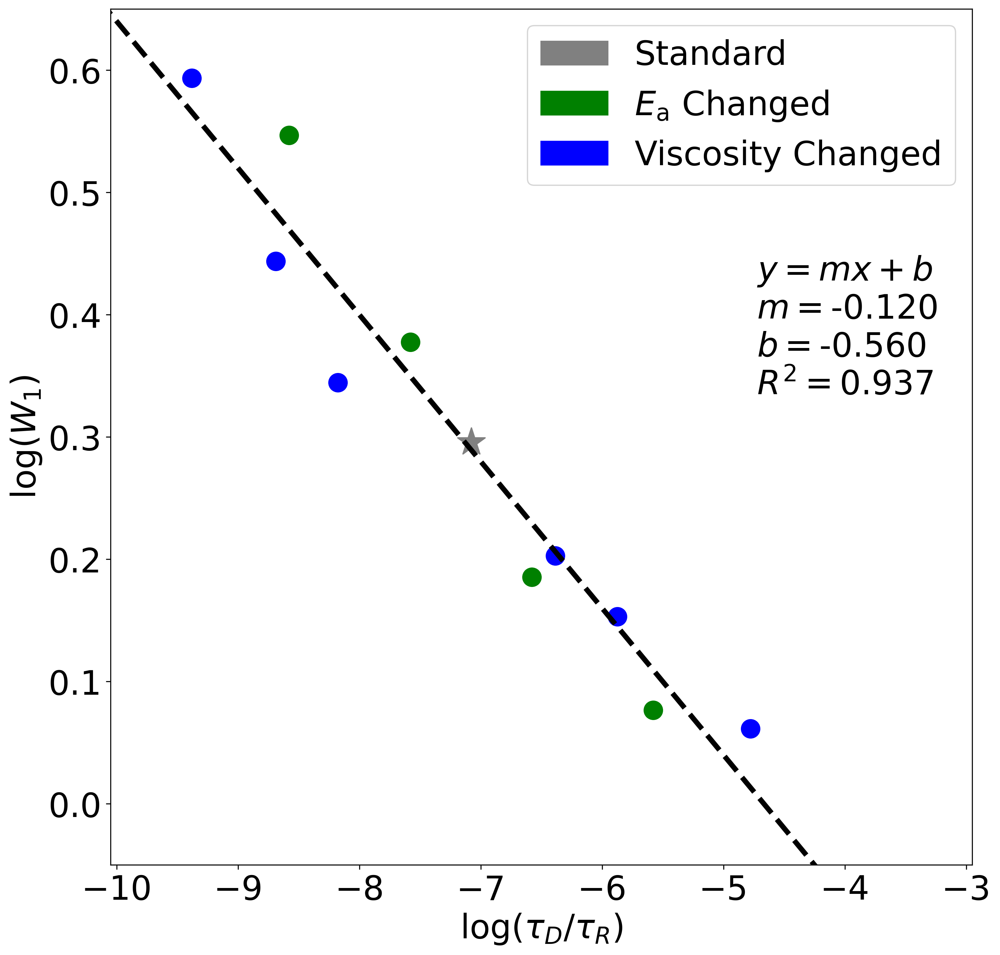

In [21]:
fig, host = plt.subplots(1,1,figsize = (12,12))
host.tick_params(axis='both', which='major', labelsize=26)


host.set_xlabel(r"log$(\tau_{D}/\tau_{R})$",size=26)
host.set_ylabel(r"log$(W_1)$",size=26)

host.legend(handles = [patch1,patch2,patch3],fontsize=26)#,fontsize='small')
#host.legend(handles = [patch1,patch2,patch3,patch4,patch5],fontsize='small')



for i,value in enumerate(char_block_len):
    if i == 0:
        host.scatter(np.log(timescale_ratio[i]),np.log(block_emd[i]),500,color='gray',marker='*')
    if i in [1,2,3,4]:
        host.scatter(np.log(timescale_ratio[i]),np.log(block_emd[i]),200,color='g',marker='o')
    if i in [10,11,12,13,14,15]:
        host.scatter(np.log(timescale_ratio[i]),np.log(block_emd[i]),200,color='b',marker='o')
        
        
selected_trials = [0,1,2,3,4,10,11,12,13,14,15]
xfit_data = np.array([np.log(timescale_ratio[i]) for i in selected_trials])
yfit_data = np.array([np.log(block_emd[i]) for i in selected_trials])

linfit = LinearRegression().fit(xfit_data.reshape(-1,1),yfit_data)
linex = np.linspace(min(xfit_data)-1,max(xfit_data)+1,20)
liney = linfit.intercept_ + linfit.coef_*linex
R2_score = linfit.score(xfit_data.reshape(-1,1),yfit_data)
m = linfit.coef_[0]
b = linfit.intercept_

host.text(0.75,0.55,r'$y = mx + b$'+ '\n'+('$m = ${:.3f}'.format(m)) +'\n'+'$b = ${:.3f}'.format(b) + '\n' + '$R^2 = {:.3f}$'.format(R2_score),transform = host.transAxes,fontsize=26)

host.plot(linex,liney,'--k',linewidth=lw)
host.set_ylim(-0.05, 0.65)
#host.set_xlim(-13.05, -7.05);
host.set_xlim(int(min(xfit_data)-1)-0.05,int(max(xfit_data)+1)+0.05)
fig.savefig('copoly3_timescales_fit.png',dpi=300, bbox_inches='tight')

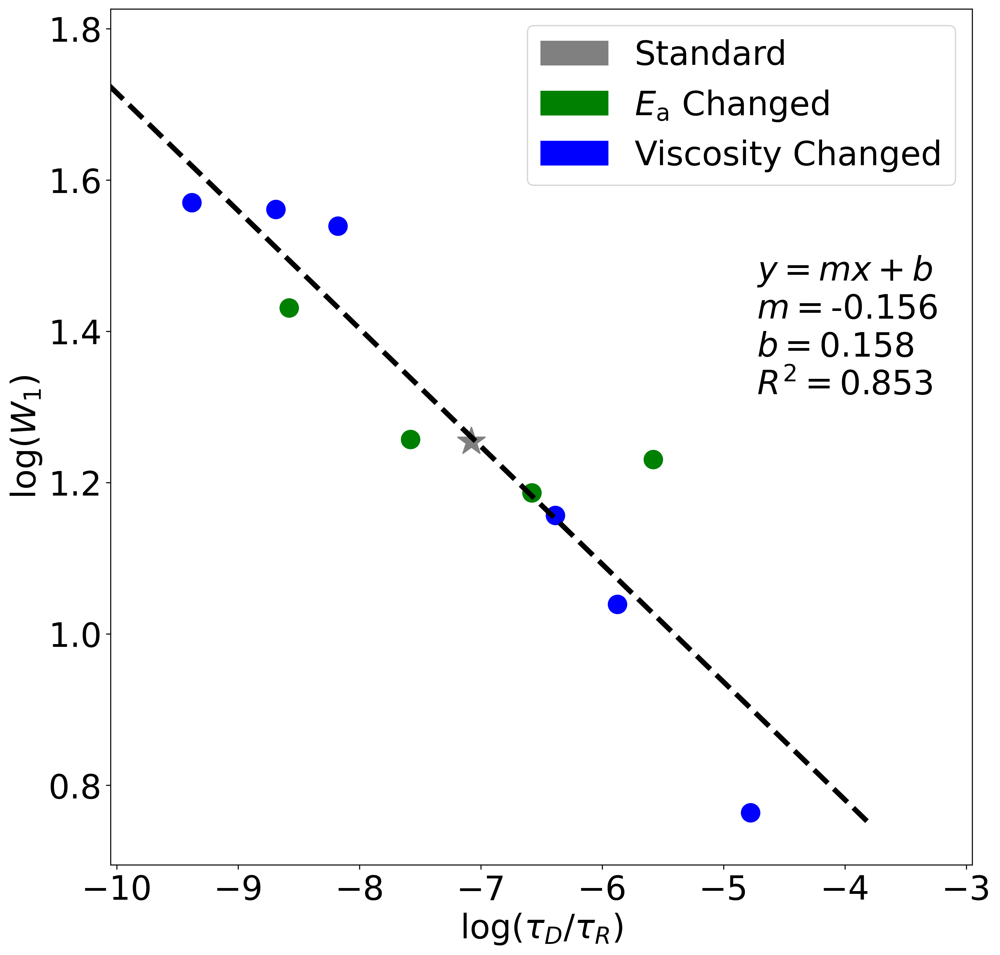

In [22]:
fig, host = plt.subplots(1,1,figsize = (12,12))
host.tick_params(axis='both', which='major', labelsize=26)


host.set_xlabel(r"log$(\tau_{D}/\tau_{R})$",size=26)
host.set_ylabel(r"log$(W_1)$",size=26)

host.legend(handles = [patch1,patch2,patch3],fontsize=26)#,fontsize='small')
#host.legend(handles = [patch1,patch2,patch3,patch4,patch5],fontsize='small')



for i,value in enumerate(char_block_len):
    if i == 0:
        host.scatter(np.log(timescale_ratio[i]),np.log(chain_emd[i]),500,color='gray',marker='*')
    if i in [1,2,3,4]:
        host.scatter(np.log(timescale_ratio[i]),np.log(chain_emd[i]),200,color='g',marker='o')
    if i in [10,11,12,13,14,15]:
        host.scatter(np.log(timescale_ratio[i]),np.log(chain_emd[i]),200,color='b',marker='o')
        
        
selected_trials = [0,1,2,3,4,10,11,12,13,14,15]
xfit_data = np.array([np.log(timescale_ratio[i]) for i in selected_trials])
yfit_data = np.array([np.log(chain_emd[i]) for i in selected_trials])

linfit = LinearRegression().fit(xfit_data.reshape(-1,1),yfit_data)
linex = np.linspace(min(xfit_data)-1,max(xfit_data)+1,20)
liney = linfit.intercept_ + linfit.coef_*linex
R2_score = linfit.score(xfit_data.reshape(-1,1),yfit_data)
m = linfit.coef_[0]
b = linfit.intercept_

host.text(0.75,0.55,r'$y = mx + b$'+ '\n'+('$m = ${:.3f}'.format(m)) +'\n'+'$b = ${:.3f}'.format(b) + '\n' + '$R^2 = {:.3f}$'.format(R2_score),transform = host.transAxes,fontsize=26)

host.plot(linex,liney,'--k',linewidth=lw)
#host.set_ylim(-0.05, 0.65)
#host.set_xlim(-13.05, -7.05);
host.set_xlim(int(min(xfit_data)-1)-0.05,int(max(xfit_data)+1)+0.05);
fig.savefig('copoly3_timescales_fit_chains.png',dpi=300, bbox_inches='tight')

In [23]:
#Colormaps for timescales

#Linear colormap
#c_ids3 = (np.array(timescale_ratio)-np.min(timescale_ratio))/(np.max(timescale_ratio)-np.min(timescale_ratio))
#norm3 = matplotlib.colors.Normalize(vmin=np.min(timescale_ratio),vmax=np.max(timescale_ratio))

#Logscale colormap
c_ids3 = (np.array(np.log(timescale_ratio))-np.min(np.log(timescale_ratio)))/(np.max(np.log(timescale_ratio))-np.min(np.log(timescale_ratio)))
norm3 = matplotlib.colors.Normalize(vmin=np.min(np.log(timescale_ratio)),vmax=np.max(np.log(timescale_ratio)))

cmap3 = truncate_colormap(plt.cm.plasma,0.,0.9)
#cmap3 = truncate_colormap(plt.cm.turbo,0.,1.)



sm3 = plt.cm.ScalarMappable(norm=norm3,cmap=cmap3)
sm3.set_array([])

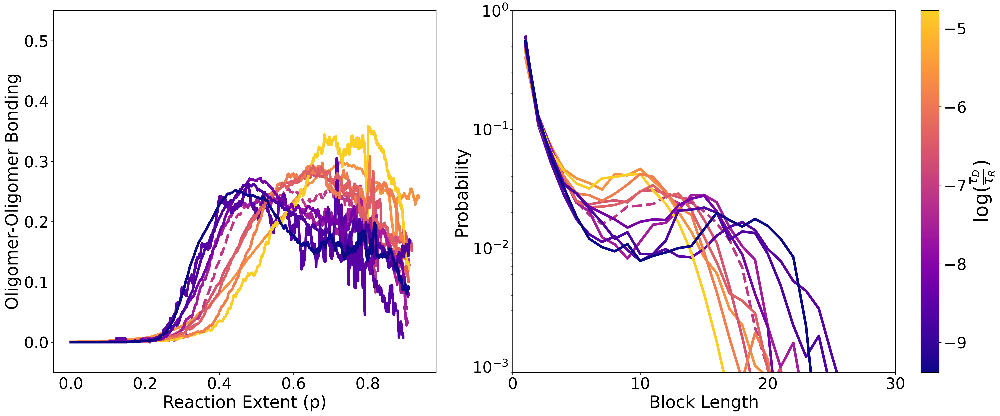

In [24]:
fig,ax = plt.subplots(1,2,figsize=(28,10))

#oligo-oligo bonding
barPlt1 = ax[0].plot(sims[1][0],rxn_plot[1][8],color=cmap3(c_ids3[1]),linewidth=lw)
barPlt2 = ax[0].plot(sims[2][0],rxn_plot[2][8],color=cmap3(c_ids3[2]),linewidth=lw)
Standard = ax[0].plot(sims[0][0],rxn_plot[0][8],color=cmap3(c_ids3[0]),linewidth=lw, linestyle='--')
barPlt3 = ax[0].plot(sims[3][0],rxn_plot[3][8],color=cmap3(c_ids3[3]),linewidth=lw)
barPlt4 = ax[0].plot(sims[4][0],rxn_plot[4][8],color=cmap3(c_ids3[4]),linewidth=lw)
dampPlt1 = ax[0].plot(sims[10][0],rxn_plot[10][8],color=cmap3(c_ids3[10]),linewidth=lw)
dampPlt1ZZ = ax[0].plot(sims[11][0],rxn_plot[11][8],color=cmap3(c_ids3[11]),linewidth=lw)
dampPlt2 = ax[0].plot(sims[12][0],rxn_plot[12][8],color=cmap3(c_ids3[12]),linewidth=lw)
dampPlt2ZZ = ax[0].plot(sims[13][0],rxn_plot[13][8],color=cmap3(c_ids3[13]),linewidth=lw)
dampPlt3 = ax[0].plot(sims[14][0],rxn_plot[14][8],color=cmap3(c_ids3[14]),linewidth=lw)
dampPlt4 = ax[0].plot(sims[15][0],rxn_plot[15][8],color=cmap3(c_ids3[15]),linewidth=lw)
ax[0].set_ylim((-0.05,0.55))
ax[0].set_xlabel('Reaction Extent (p)',fontsize=26)
ax[0].set_ylabel('Oligomer-Oligomer Bonding',fontsize=26);





#block length
barPlt1 = ax[1].plot(x,BlockDistB1/np.sum(BlockDistB1),color=cmap3(c_ids3[1]),linewidth=lw)
barPlt2 = ax[1].plot(x,BlockDistB2/np.sum(BlockDistB2),color=cmap3(c_ids3[2]),linewidth=lw)
barPltS = ax[1].plot(x,BlockDistS/np.sum(BlockDistS),color=cmap3(c_ids3[0]),linewidth=lw, linestyle='--')
barPlt3 = ax[1].plot(x,BlockDistB3/np.sum(BlockDistB3),color=cmap3(c_ids3[3]),linewidth=lw)
barPlt4 = ax[1].plot(x,BlockDistB4/np.sum(BlockDistB4),color=cmap3(c_ids3[4]),linewidth=lw)

dampPlt1 = ax[1].plot(x,BlockDistD1/np.sum(BlockDistD1),color=cmap3(c_ids3[10]),linewidth=lw)
dampPlt1ZZ = ax[1].plot(x,BlockDistD2/np.sum(BlockDistD2),color=cmap3(c_ids3[11]),linewidth=lw)
dampPlt2 = ax[1].plot(x,BlockDistD3/np.sum(BlockDistD3),color=cmap3(c_ids3[12]),linewidth=lw)
dampPlt2ZZ = ax[1].plot(x,BlockDistD4/np.sum(BlockDistD4),color=cmap3(c_ids3[13]),linewidth=lw)
dampPlt3 = ax[1].plot(x,BlockDistD5/np.sum(BlockDistD5),color=cmap3(c_ids3[14]),linewidth=lw)
dampPlt4 = ax[1].plot(x,BlockDistD6/np.sum(BlockDistD6),color=cmap3(c_ids3[15]),linewidth=lw)

ax[1].set_yscale('log')
ax[1].set_xlim((0,30))
ax[1].set_ylim((9e-4,1))
ax[1].set_xticks([0,10,20,30])
ax[1].set_xlabel('Block Length',fontsize=26)
ax[1].set_ylabel('Probability',fontsize=26);


cbar = plt.colorbar(sm3,ax=ax.ravel().tolist(),pad=0.025)#,label=r'$\frac{\tau_D}{\tau_R}$');
#cbar.formatter.set_powerlimits((0, 0))
cbar.set_label(label=r'log$(\frac{\tau_D}{\tau_R})$',size=30)
#cbar.ax.set_yticklabels('')



fig.savefig('copoly3_Timescales_Oligo-Oligo_Pop_Dist.png',dpi=300, bbox_inches='tight')

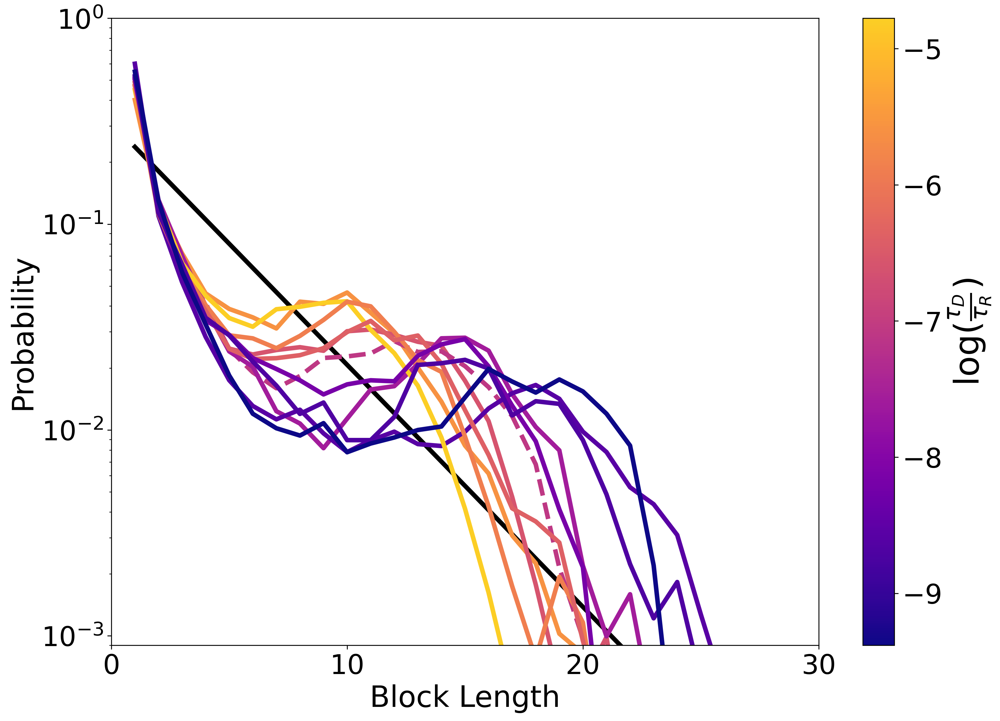

In [25]:
fig,ax = plt.subplots(1,1,figsize=(14,10))

simid=0
ax.plot(x,((1-2*sims[simid][0][-1]*sims[simid][3][0][-1])*(2*sims[simid][0][-1]*sims[simid][3][0][-1])**(x-1)),'-k',linewidth=lw)



#block length
barPlt1 = ax.plot(x,BlockDistB1/np.sum(BlockDistB1),color=cmap3(c_ids3[1]),linewidth=lw)
barPlt2 = ax.plot(x,BlockDistB2/np.sum(BlockDistB2),color=cmap3(c_ids3[2]),linewidth=lw)
barPltS = ax.plot(x,BlockDistS/np.sum(BlockDistS),color=cmap3(c_ids3[0]),linewidth=lw, linestyle='--')
barPlt3 = ax.plot(x,BlockDistB3/np.sum(BlockDistB3),color=cmap3(c_ids3[3]),linewidth=lw)
barPlt4 = ax.plot(x,BlockDistB4/np.sum(BlockDistB4),color=cmap3(c_ids3[4]),linewidth=lw)

dampPlt1 = ax.plot(x,BlockDistD1/np.sum(BlockDistD1),color=cmap3(c_ids3[10]),linewidth=lw)
dampPlt1ZZ = ax.plot(x,BlockDistD2/np.sum(BlockDistD2),color=cmap3(c_ids3[11]),linewidth=lw)
dampPlt2 = ax.plot(x,BlockDistD3/np.sum(BlockDistD3),color=cmap3(c_ids3[12]),linewidth=lw)
dampPlt2ZZ = ax.plot(x,BlockDistD4/np.sum(BlockDistD4),color=cmap3(c_ids3[13]),linewidth=lw)
dampPlt3 = ax.plot(x,BlockDistD5/np.sum(BlockDistD5),color=cmap3(c_ids3[14]),linewidth=lw)
dampPlt4 = ax.plot(x,BlockDistD6/np.sum(BlockDistD6),color=cmap3(c_ids3[15]),linewidth=lw)

ax.set_yscale('log')
ax.set_xlim((0,30))
ax.set_ylim((9e-4,1))
ax.set_xticks([0,10,20,30])
ax.set_xlabel('Block Length',fontsize=26)
ax.set_ylabel('Probability',fontsize=26);


cbar = plt.colorbar(sm3,ax=ax)#,label=r'$\frac{\tau_D}{\tau_R}$');
#cbar.formatter.set_powerlimits((0, 0))
cbar.set_label(label=r'log$(\frac{\tau_D}{\tau_R})$',size=30)
#cbar.ax.set_yticklabels('')



fig.savefig('copoly3_Timescales_Block_Dist.png',dpi=300, bbox_inches='tight')

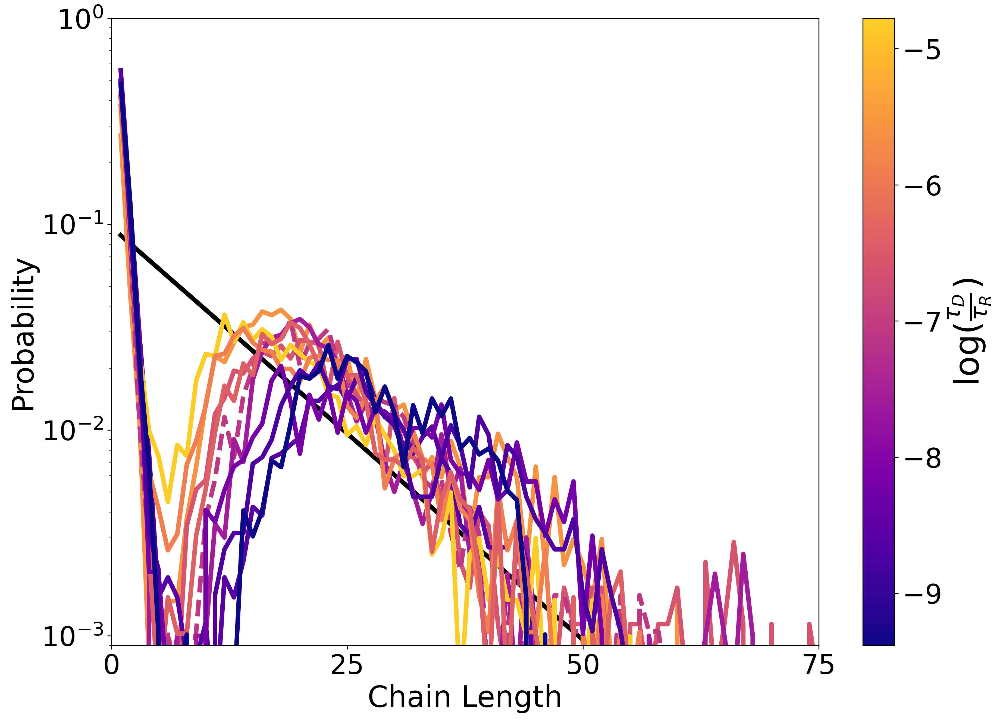

In [26]:
fig,ax = plt.subplots(1,1,figsize=(14,10))

x_chain = np.linspace(1,350,350)
simid=0
ax.plot(x_chain,((1-sims[simid][0][-1])*(sims[simid][0][-1])**(x_chain-1)),'-k',linewidth=lw)



#Chain length
barPlt1 = ax.plot(x_chain,ChainDistB1/np.sum(ChainDistB1),color=cmap3(c_ids3[1]),linewidth=lw)
barPlt2 = ax.plot(x_chain,ChainDistB2/np.sum(ChainDistB2),color=cmap3(c_ids3[2]),linewidth=lw)
barPltS = ax.plot(x_chain,ChainDistS/np.sum(ChainDistS),color=cmap3(c_ids3[0]),linewidth=lw, linestyle='--')
barPlt3 = ax.plot(x_chain,ChainDistB3/np.sum(ChainDistB3),color=cmap3(c_ids3[3]),linewidth=lw)
barPlt4 = ax.plot(x_chain,ChainDistB4/np.sum(ChainDistB4),color=cmap3(c_ids3[4]),linewidth=lw)

dampPlt1 = ax.plot(x_chain,ChainDistD1/np.sum(ChainDistD1),color=cmap3(c_ids3[10]),linewidth=lw)
dampPlt1ZZ = ax.plot(x_chain,ChainDistD2/np.sum(ChainDistD2),color=cmap3(c_ids3[11]),linewidth=lw)
dampPlt2 = ax.plot(x_chain,ChainDistD3/np.sum(ChainDistD3),color=cmap3(c_ids3[12]),linewidth=lw)
dampPlt2ZZ = ax.plot(x_chain,ChainDistD4/np.sum(ChainDistD4),color=cmap3(c_ids3[13]),linewidth=lw)
dampPlt3 = ax.plot(x_chain,ChainDistD5/np.sum(ChainDistD5),color=cmap3(c_ids3[14]),linewidth=lw)
dampPlt4 = ax.plot(x_chain,ChainDistD6/np.sum(ChainDistD6),color=cmap3(c_ids3[15]),linewidth=lw)

ax.set_yscale('log')
ax.set_xlim((0,75))
ax.set_ylim((9e-4,1))
ax.set_xticks([0,25,50,75])
ax.set_xlabel('Chain Length',fontsize=26)
ax.set_ylabel('Probability',fontsize=26);


cbar = plt.colorbar(sm3,ax=ax)#,label=r'$\frac{\tau_D}{\tau_R}$');
#cbar.formatter.set_powerlimits((0, 0))
cbar.set_label(label=r'log$(\frac{\tau_D}{\tau_R})$',size=30)
#cbar.ax.set_yticklabels('')



fig.savefig('copoly3_Timescales_Chain_Dist.png',dpi=300, bbox_inches='tight')

## Bond and Chain End Clustering

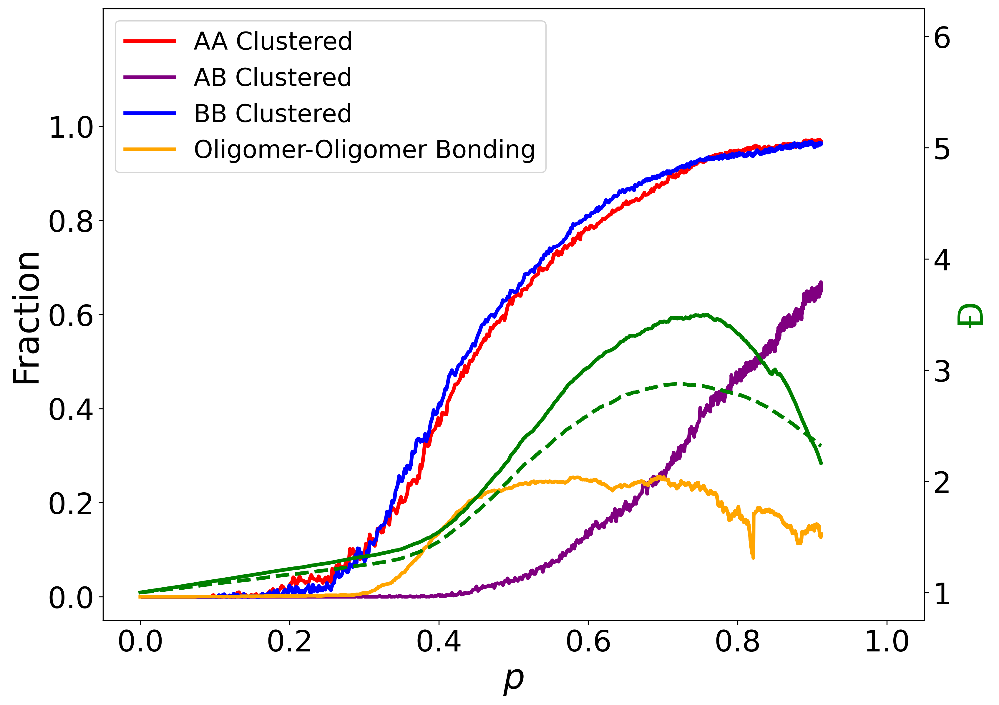

In [27]:
SMALL_SIZE = 20
MEDIUM_SIZE = 24
BIGGER_SIZE = 28

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=BIGGER_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
matplotlib.rcParams['figure.dpi'] = 300

lw = 3.

fig, ax = plt.subplots(1,1,figsize=(12,9))

ax.set_xlim(-0.05, 1.05)
ax.set_ylim(-0.05, 1.25)
ax.set_yticks([0,0.2,0.4,0.6,0.8,1.0])
ax.set_xlabel(r"$p$")
ax.set_ylabel(r"Fraction")
par1 = ax.twinx()
par1.set_ylabel(u"\u0110",color='green')
par1.set_ylim(0.75,6.25)


ax.plot(sims[0][0],sims[0][18][0],'r',label='AA Clustered',linewidth=lw)
ax.plot(sims[0][0],sims[0][18][1],color='purple', label='AB Clustered',linewidth=lw)
ax.plot(sims[0][0],sims[0][18][2],'b',label='BB Clustered',linewidth=lw)
#ax.plot(sims[0][0],sims[0][18][3],color='cyan',label='Chain Ends Clustered',linewidth=lw)
par1.plot(sims[0][0],sims[0][9],'g',label='PDI',linewidth=lw)
par1.plot(sims[0][0],((sims[0][7]+sims[0][8])/2),'--g',label='Block PDI',linewidth=lw)


ax.plot(sims[0][0],rxn_plot[0][8],color='orange',linewidth=lw,label='Oligomer-Oligomer Bonding')


#ax.plot([-0.05,1.05],[0.5,0.5],'--k',linewidth=lw)
#ax.plot(sims[0][0],(sims[0][3][0]+sims[0][3][2]),'k',label=r'$p_{AABB}$',linewidth=lw)





#par2 = ax.twinx()
#par2.set_ylabel("Number of Clusters")
#par2.spines['right'].set_position(('outward', 60))
#par2.plot(reader.trajs['extent'][first_cluster_step:],all_num_cluster[first_cluster_step:],'r',label='Number of AB Clusters')


ax.legend(loc='upper left')#,ncol=2)
plt.show()

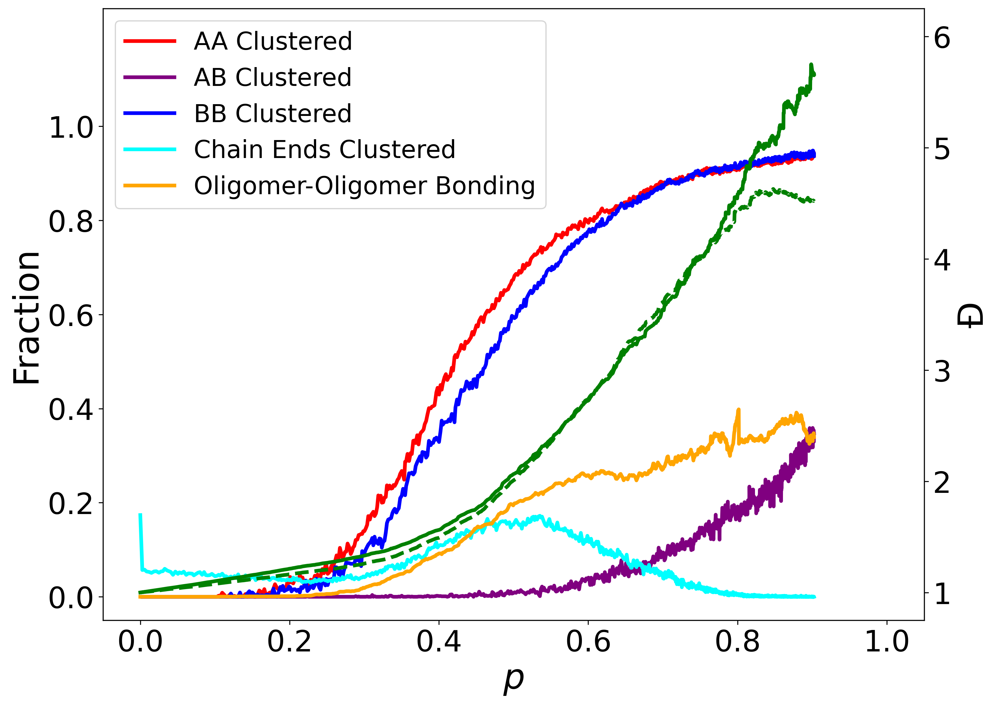

In [28]:
SMALL_SIZE = 20
MEDIUM_SIZE = 24
BIGGER_SIZE = 28

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=BIGGER_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
matplotlib.rcParams['figure.dpi'] = 300

lw = 3.

fig, ax = plt.subplots(1,1,figsize=(12,9))

ax.set_xlim(-0.05, 1.05)
ax.set_ylim(-0.05, 1.25)
ax.set_yticks([0,0.2,0.4,0.6,0.8,1.0])
ax.set_xlabel(r"$p$")
ax.set_ylabel(r"Fraction")
par1 = ax.twinx()
par1.set_ylabel(u"\u0110")
par1.set_ylim(0.75,6.25)


ax.plot(sims[19][0],sims[19][18][0],'r',label='AA Clustered',linewidth=lw)
ax.plot(sims[19][0],sims[19][18][1],color='purple', label='AB Clustered',linewidth=lw)
ax.plot(sims[19][0],sims[19][18][2],'b',label='BB Clustered',linewidth=lw)
ax.plot(sims[19][0],sims[19][18][3],color='cyan',label='Chain Ends Clustered',linewidth=lw)
par1.plot(sims[19][0],sims[19][9],'g',label='PDI',linewidth=lw)
par1.plot(sims[19][0],((sims[19][7]+sims[19][8])/2),'--g',label='Block PDI',linewidth=lw)

ax.plot(sims[19][0],rxn_plot[19][8],color='orange',linewidth=lw,label='Oligomer-Oligomer Bonding')



#ax.plot([-0.05,1.05],[0.5,0.5],'--k',linewidth=lw)
#ax.plot(sims[19][0],(sims[19][3][0]+sims[19][3][2]),'k',label=r'$p_{AABB}$',linewidth=lw)





#par2 = ax.twinx()
#par2.set_ylabel("Number of Clusters")
#par2.spines['right'].set_position(('outward', 60))
#par2.plot(reader.trajs['extent'][first_cluster_step:],all_num_cluster[first_cluster_step:],'r',label='Number of AB Clusters')


ax.legend(loc='upper left')#,ncol=2)
plt.show()

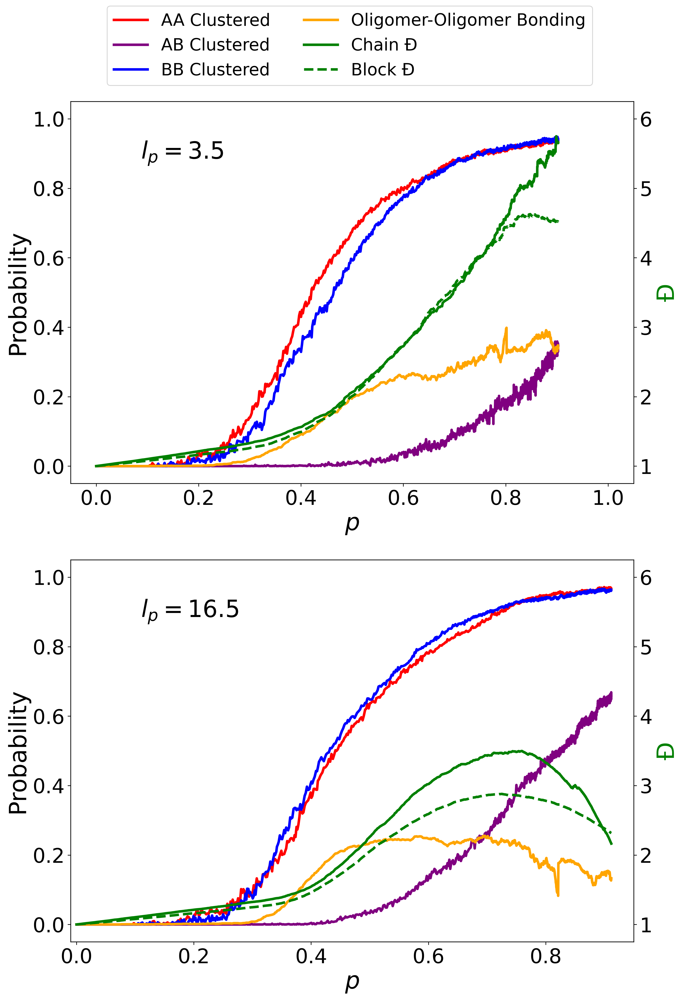

In [29]:
SMALL_SIZE = 20
MEDIUM_SIZE = 24
BIGGER_SIZE = 28

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=BIGGER_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
matplotlib.rcParams['figure.dpi'] = 300

lw = 3.

fig, ax = plt.subplots(2,1,figsize=(12,18))


ax[0].set_xlim(-0.05, 1.05)
ax[0].set_ylim(-0.05, 1.05)
ax[0].set_yticks([0,0.2,0.4,0.6,0.8,1.0])
ax[0].set_xlabel(r"$p$")
ax[0].set_ylabel(r"Probability")
par1 = ax[0].twinx()
par1.set_ylabel(u"\u0110",color='green')
par1.set_ylim(0.75,6.25)


ax[0].plot(sims[19][0],sims[19][18][0],'r',label='AA Clustered',linewidth=lw)
ax[0].plot(sims[19][0],sims[19][18][1],color='purple', label='AB Clustered',linewidth=lw)
ax[0].plot(sims[19][0],sims[19][18][2],'b',label='BB Clustered',linewidth=lw)
#ax[0].plot(sims[19][0],sims[19][18][3],color='cyan',label='Chain Ends Clustered',linewidth=lw)
par1.plot(sims[19][0],sims[19][9],'g',label='PDI',linewidth=lw)
par1.plot(sims[19][0],((sims[19][7]+sims[19][8])/2),'--g',label='Block PDI',linewidth=lw)

ax[0].plot(sims[19][0],rxn_plot[19][8],color='orange',linewidth=lw,label='Oligomer-Oligomer Bonding')



ax[1].set_xlim(-0.01, 0.95)
ax[1].set_ylim(-0.05, 1.05)
ax[1].set_yticks([0,0.2,0.4,0.6,0.8,1.0])
ax[1].set_xlabel(r"$p$")
ax[1].set_ylabel(r"Probability")
par2 = ax[1].twinx()
par2.set_ylabel(u"\u0110",color='green')
par2.set_ylim(0.75,6.25)


ax[1].plot(sims[0][0],sims[0][18][0],'r',label='AA Clustered',linewidth=lw)
ax[1].plot(sims[0][0],sims[0][18][1],color='purple', label='AB Clustered',linewidth=lw)
ax[1].plot(sims[0][0],sims[0][18][2],'b',label='BB Clustered',linewidth=lw)
#ax[1].plot(sims[0][0],sims[0][18][3],color='cyan',label='Chain Ends Clustered',linewidth=lw)
par2.plot(sims[0][0],sims[0][9],'g',label='PDI',linewidth=lw)
par2.plot(sims[0][0],((sims[0][7]+sims[0][8])/2),'--g',label='Block PDI',linewidth=lw)


ax[1].plot(sims[0][0],rxn_plot[0][8],color='orange',linewidth=lw,label='Oligomer-Oligomer Bonding')

label1 = 'Chain '+u'\u0110'
label2 = 'Block '+u'\u0110'
ax[0].plot([],[],'g',label=label1,linewidth=lw)
ax[0].plot([],[],'--g',label=label2,linewidth=lw)

#ax[1].legend(loc='upper left')#,ncol=2)
#ax[0].legend(loc='upper left')#,ncol=2);
ax[0].legend(loc='lower left', bbox_to_anchor=(0.05,1.02),ncol=2);
ax[0].text(0.125,0.85,r'$l_p = 3.5$',transform = ax[0].transAxes,fontsize=BIGGER_SIZE)
ax[1].text(0.125,0.85,r'$l_p = 16.5$',transform = ax[1].transAxes,fontsize=BIGGER_SIZE)

fig.savefig('copoly3_bond_clustering_compare.png',transparent=True,bbox_inches='tight',dpi=300)

plt.show()

(-0.01, 0.95)


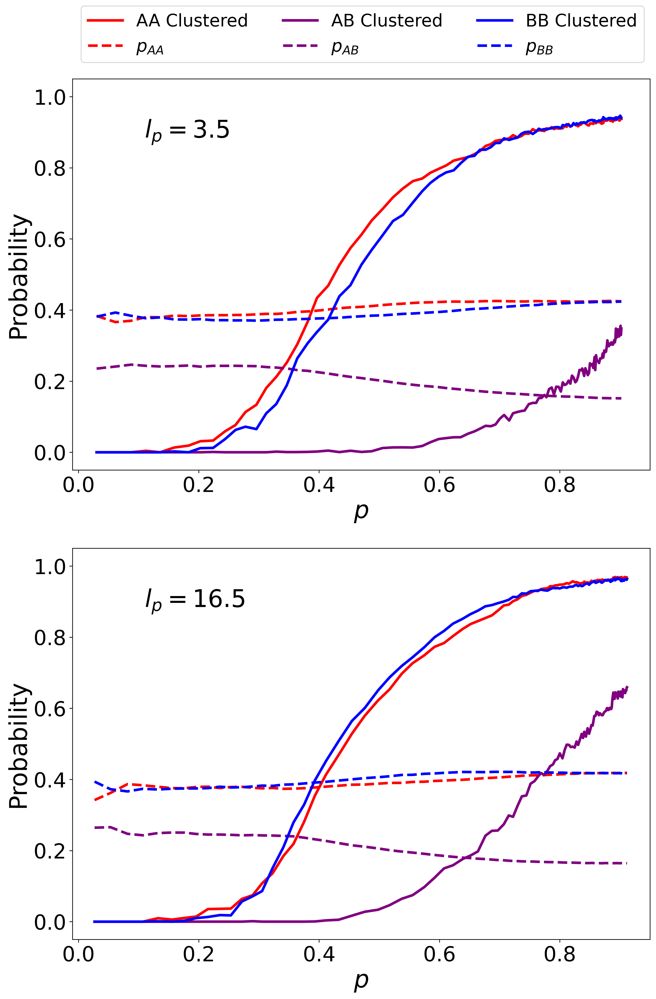

In [30]:
SMALL_SIZE = 20
MEDIUM_SIZE = 24
BIGGER_SIZE = 28

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=BIGGER_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
matplotlib.rcParams['figure.dpi'] = 300

lw = 3.
ds = 10
fig, ax = plt.subplots(2,1,figsize=(12,18))


ax[0].set_xlim(-0.01, 0.95)
ax[0].set_ylim(-0.05, 1.05)
ax[0].set_yticks([0,0.2,0.4,0.6,0.8,1.0])
ax[0].set_xlabel(r"$p$")
ax[0].set_ylabel(r"Probability")



ax[0].plot(sims[19][0][::ds],sims[19][18][0][::ds],'-r',label='AA Clustered',linewidth=lw)
ax[0].plot(sims[19][0][::ds],sims[19][3][0][::ds],'--r',label=r'$p_{AA}$',linewidth=lw)
ax[0].plot(sims[19][0][::ds],sims[19][18][1][::ds],'-',color='purple', label='AB Clustered',linewidth=lw)
ax[0].plot(sims[19][0][::ds],sims[19][3][1][::ds],'--',color='purple',label=r'$p_{AB}$',linewidth=lw)
ax[0].plot(sims[19][0][::ds],sims[19][18][2][::ds],'-b',label='BB Clustered',linewidth=lw)
ax[0].plot(sims[19][0][::ds],sims[19][3][2][::ds],'--b',linewidth=lw,label=r'$p_{BB}$')



ax[1].set_xlim(-0.01, 0.95)
ax[1].set_ylim(-0.05, 1.05)
ax[1].set_yticks([0,0.2,0.4,0.6,0.8,1.0])
ax[1].set_xlabel(r"$p$")
ax[1].set_ylabel(r"Probability")



ax[1].plot(sims[0][0][::ds],sims[0][18][0][::ds],'-r',label='AA Clustered',linewidth=lw)
ax[1].plot(sims[0][0][::ds],sims[0][3][0][::ds],'--r',label=r'$p_{AA}$',linewidth=lw)
ax[1].plot(sims[0][0][::ds],sims[0][18][1][::ds],'-',color='purple', label='AB Clustered',linewidth=lw)
ax[1].plot(sims[0][0][::ds],sims[0][3][1][::ds],'--',color='purple',label=r'$p_{AB}$',linewidth=lw)
ax[1].plot(sims[0][0][::ds],sims[0][18][2][::ds],'-b',label='BB Clustered',linewidth=lw)
ax[1].plot(sims[0][0][::ds],sims[0][3][2][::ds],'--b',linewidth=lw,label=r'$p_{BB}$')







#ax[1].legend(loc='upper left')#,ncol=2)
#ax[0].legend(loc='upper left')#,ncol=2);
ax[0].legend(loc='lower left', bbox_to_anchor=(0.0,1.02),ncol=3);
ax[0].text(0.125,0.85,r'$l_p = 3.5$',transform = ax[0].transAxes,fontsize=BIGGER_SIZE)
ax[1].text(0.125,0.85,r'$l_p = 16.5$',transform = ax[1].transAxes,fontsize=BIGGER_SIZE)

fig.savefig('copoly3_bond_clustering_compare_alt.png',transparent=True,bbox_inches='tight',dpi=300)
print(ax[0].get_xlim())
plt.show()

In [31]:
#Max difference in sequence neighbor probs between stiff and flexible (after p~0.2 where sufficient bonding occurs for probs to be well sampled vals)
#print(np.where(sims[0][0]>0.2))
start_val = 80
print('AA max',np.nanmax(np.abs(np.array(sims[0][3][0][start_val:])-np.array(sims[19][3][0][start_val:]))))
print('AB max',np.nanmax(np.abs(np.array(sims[0][3][1][start_val:])-np.array(sims[19][3][1][start_val:]))))
print('BB max',np.nanmax(np.abs(np.array(sims[0][3][2][start_val:])-np.array(sims[19][3][2][start_val:]))))

print('AA mean',np.nanmean(np.abs(np.array(sims[0][3][0][start_val:])-np.array(sims[19][3][0][start_val:]))))
print('AB mean',np.nanmean(np.abs(np.array(sims[0][3][1][start_val:])-np.array(sims[19][3][1][start_val:]))))
print('BB mean',np.nanmean(np.abs(np.array(sims[0][3][2][start_val:])-np.array(sims[19][3][2][start_val:]))))

AA max 0.026417484328133067
AB max 0.012888909100564672
BB max 0.026630841165707797
AA mean 0.011253549936196242
AB mean 0.007855636153815368
BB mean 0.008172843497453248


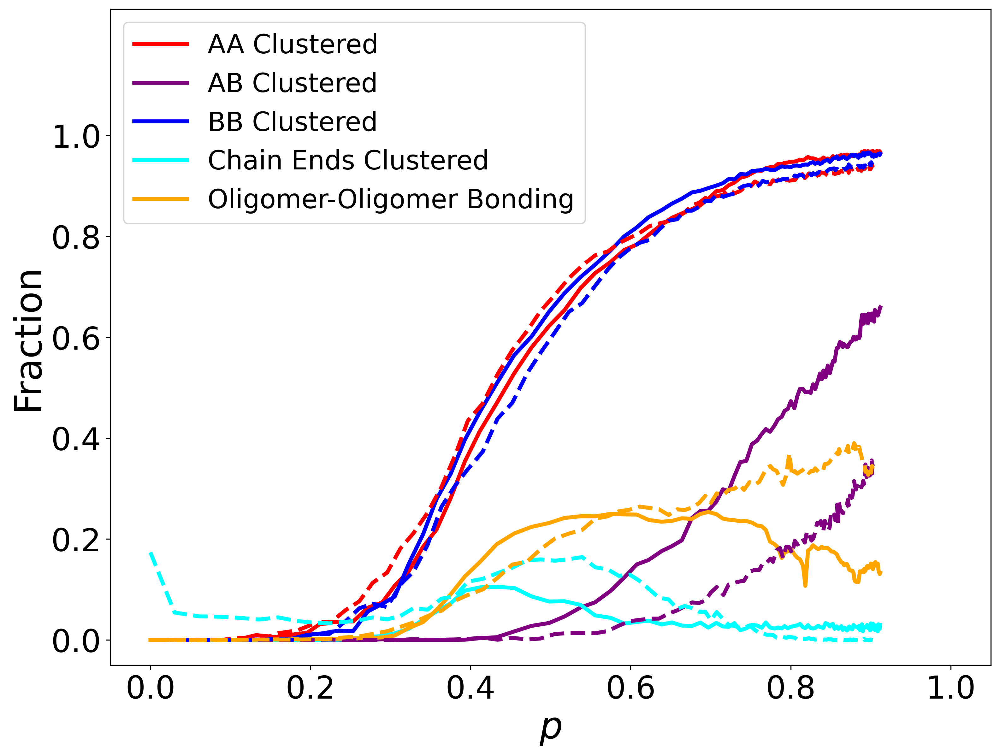

In [32]:
SMALL_SIZE = 20
MEDIUM_SIZE = 24
BIGGER_SIZE = 28

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=BIGGER_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
matplotlib.rcParams['figure.dpi'] = 300

lw = 3.

fig, ax = plt.subplots(1,1,figsize=(12,9))

ax.set_xlim(-0.05, 1.05)
ax.set_ylim(-0.05, 1.25)
ax.set_yticks([0,0.2,0.4,0.6,0.8,1.0])
ax.set_xlabel(r"$p$")
ax.set_ylabel(r"Fraction")
# par1 = ax.twinx()
# par1.set_ylabel("PDI")
# par1.set_ylim(0.75,6.25)
stride=10



#Sitff
ax.plot(sims[0][0][::stride],sims[0][18][0][::stride],'r',label='AA Clustered',linewidth=lw)
ax.plot(sims[0][0][::stride],sims[0][18][1][::stride],color='purple', label='AB Clustered',linewidth=lw)
ax.plot(sims[0][0][::stride],sims[0][18][2][::stride],'b',label='BB Clustered',linewidth=lw)
ax.plot(sims[0][0][::stride],sims[0][18][3][::stride],color='cyan',label='Chain Ends Clustered',linewidth=lw)
# par1.plot(sims[0][0][::stride],sims[0][9][::stride],'g',label='PDI',linewidth=lw)
# par1.plot(sims[0][0][::stride],((sims[0][7]+sims[19][8])/2)[::stride],'--g',label='Block PDI',linewidth=lw)
ax.plot(sims[0][0][::stride],rxn_plot[0][8][::stride],color='orange',linewidth=lw,label='Oligomer-Oligomer Bonding')

ax.legend(loc='upper left')


#Flexible
ax.plot(sims[19][0][::stride],sims[19][18][0][::stride],'r',label='AA Clustered',linewidth=lw,linestyle='--')
ax.plot(sims[19][0][::stride],sims[19][18][1][::stride],color='purple', label='AB Clustered',linewidth=lw,linestyle='--')
ax.plot(sims[19][0][::stride],sims[19][18][2][::stride],'b',label='BB Clustered',linewidth=lw,linestyle='--')
ax.plot(sims[19][0][::stride],sims[19][18][3][::stride],color='cyan',label='Chain Ends Clustered',linewidth=lw,linestyle='--')
# par1.plot(sims[19][0][::stride],sims[19][9][::stride],'g',label='PDI',linewidth=lw)
# par1.plot(sims[19][0][::stride],((sims[19][7]+sims[19][8])/2)[::stride],'--g',label='Block PDI',linewidth=lw)
ax.plot(sims[19][0][::stride],rxn_plot[19][8][::stride],color='orange',linewidth=lw,label='Oligomer-Oligomer Bonding',linestyle='--')
#ax.plot(sims[19][0][::stride],(sims[0][3][0]+sims[19][3][2])[::stride],'k',label=r'$p_{AABB}$',linewidth=lw)




#ax.plot([-0.05,1.05],[0.5,0.5],'--k',linewidth=lw)
#ax.plot(sims[0][0][::stride],(sims[0][3][0]+sims[0][3][2])[::stride],'k',label=r'$p_{AABB}$',linewidth=lw)





#par2 = ax.twinx()
#par2.set_ylabel("Number of Clusters")
#par2.spines['right'].set_position(('outward', 60))
#par2.plot(reader.trajs['extent'][first_cluster_step:],all_num_cluster[first_cluster_step:],'r',label='Number of AB Clusters')


#ax.legend(loc='upper left')#,ncol=2)
plt.show()

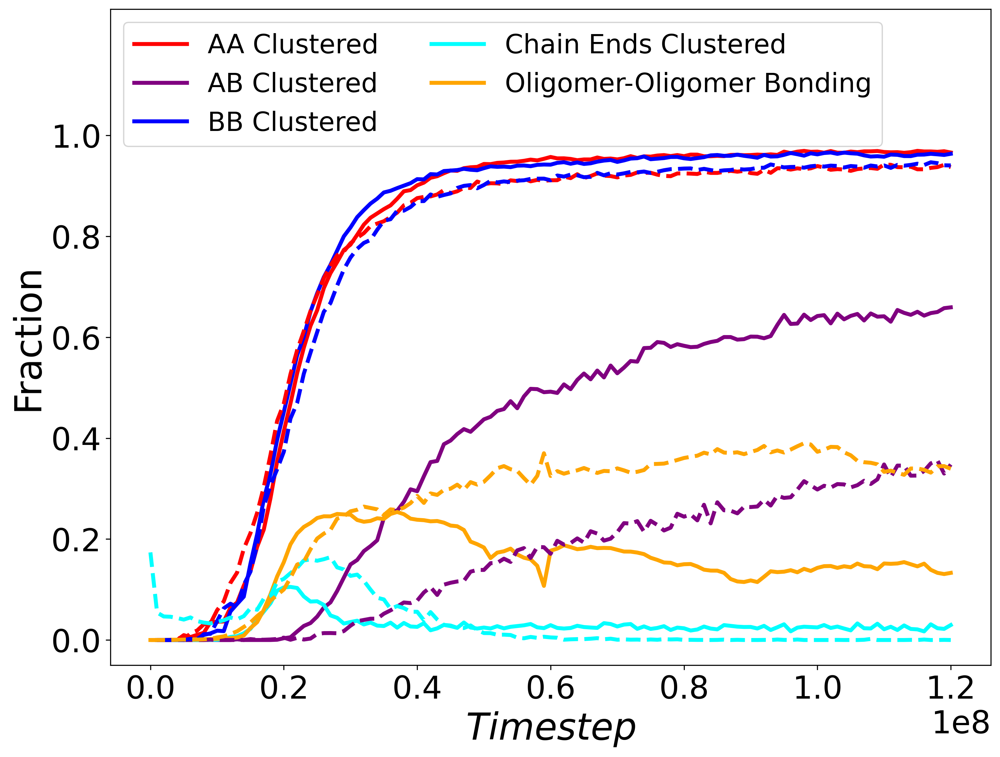

In [33]:
SMALL_SIZE = 20
MEDIUM_SIZE = 24
BIGGER_SIZE = 28

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=BIGGER_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
matplotlib.rcParams['figure.dpi'] = 300

lw = 3.

fig, ax = plt.subplots(1,1,figsize=(12,9))

#ax.set_xlim(-0.05, 1.05)
ax.set_ylim(-0.05, 1.25)
ax.set_yticks([0,0.2,0.4,0.6,0.8,1.0])
ax.set_xlabel(r"$Timestep$")
ax.set_ylabel(r"Fraction")
# par1 = ax.twinx()
# par1.set_ylabel("PDI")
# par1.set_ylim(0.75,6.25)
stride=10



#Sitff
ax.plot(sims[0][2][::stride],sims[0][18][0][::stride],'r',label='AA Clustered',linewidth=lw)
ax.plot(sims[0][2][::stride],sims[0][18][1][::stride],color='purple', label='AB Clustered',linewidth=lw)
ax.plot(sims[0][2][::stride],sims[0][18][2][::stride],'b',label='BB Clustered',linewidth=lw)
ax.plot(sims[0][2][::stride],sims[0][18][3][::stride],color='cyan',label='Chain Ends Clustered',linewidth=lw)
# par1.plot(sims[0][2][::stride],sims[0][9][::stride],'g',label='PDI',linewidth=lw)
# par1.plot(sims[0][2][::stride],((sims[0][7]+sims[19][8])/2)[::stride],'--g',label='Block PDI',linewidth=lw)
ax.plot(sims[0][2][::stride],rxn_plot[0][8][::stride],color='orange',linewidth=lw,label='Oligomer-Oligomer Bonding')

ax.legend(loc='upper left',ncol=2)


#Flexible
ax.plot(sims[19][2][::stride],sims[19][18][0][::stride],'r',label='AA Clustered',linewidth=lw,linestyle='--')
ax.plot(sims[19][2][::stride],sims[19][18][1][::stride],color='purple', label='AB Clustered',linewidth=lw,linestyle='--')
ax.plot(sims[19][2][::stride],sims[19][18][2][::stride],'b',label='BB Clustered',linewidth=lw,linestyle='--')
ax.plot(sims[19][2][::stride],sims[19][18][3][::stride],color='cyan',label='Chain Ends Clustered',linewidth=lw,linestyle='--')
# par1.plot(sims[19][2][::stride],sims[19][9][::stride],'g',label='PDI',linewidth=lw)
# par1.plot(sims[19][2][::stride],((sims[19][7]+sims[19][8])/2)[::stride],'--g',label='Block PDI',linewidth=lw)
ax.plot(sims[19][2][::stride],rxn_plot[19][8][::stride],color='orange',linewidth=lw,label='Oligomer-Oligomer Bonding',linestyle='--')
#ax.plot(sims[19][2][::stride],(sims[0][3][0]+sims[19][3][2])[::stride],'k',label=r'$p_{AABB}$',linewidth=lw)




#ax.plot([-0.05,1.05],[0.5,0.5],'--k',linewidth=lw)
#ax.plot(sims[0][0][::stride],(sims[0][3][0]+sims[0][3][2])[::stride],'k',label=r'$p_{AABB}$',linewidth=lw)





#par2 = ax.twinx()
#par2.set_ylabel("Number of Clusters")
#par2.spines['right'].set_position(('outward', 60))
#par2.plot(reader.trajs['extent'][first_cluster_step:],all_num_cluster[first_cluster_step:],'r',label='Number of AB Clusters')


#ax.legend(loc='upper left')#,ncol=2)
plt.show()

## Kinetics Figure

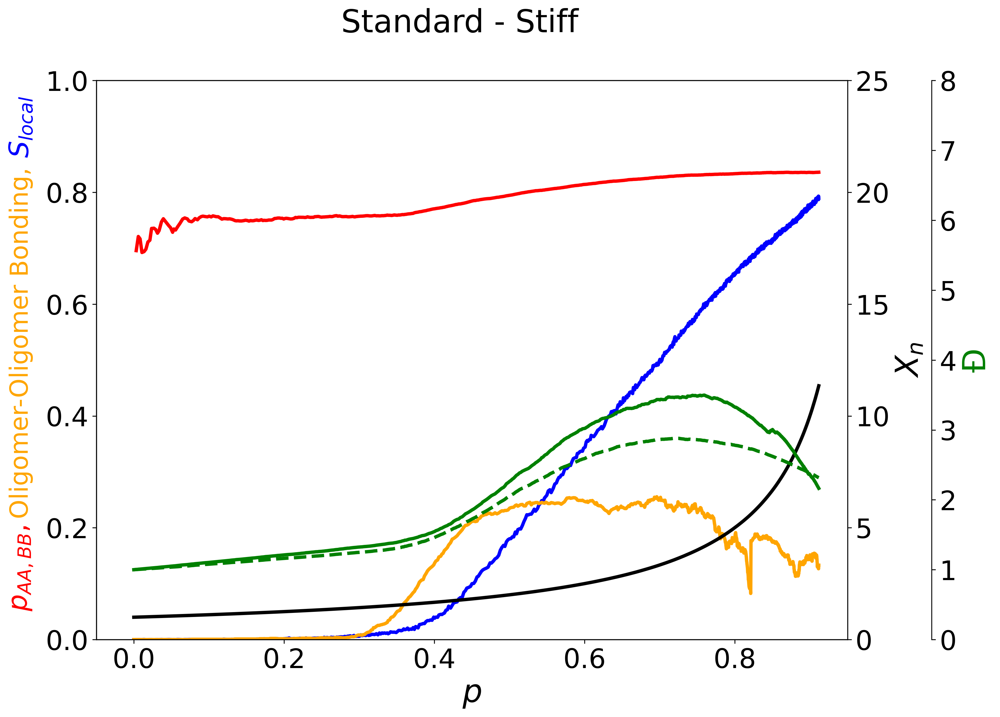

In [34]:
#Stiff standard
simid = 0
sim = sims[simid]



fig, host = plt.subplots(1,1,figsize=(12,9))
fig.suptitle('Standard - Stiff',fontsize=BIGGER_SIZE)
#fig.suptitle('$\epsilon_{AA} = 0.5 k_BT$, $\epsilon_{AB} = 0.2 k_BT$,  $\epsilon_{BB} = 0.1 k_BT$',fontsize=20)

par1 = host.twinx()
par2 = host.twinx()


host.set_xlim(-0.05, 0.95)
host.set_ylim(0, 1)
par1.set_ylim(0, 25)
par2.set_ylim(0, 8)

host.set_xlabel(r"$p$")
par1.set_ylabel(r"$X_n$")
par2.set_ylabel(u'\u0110')



# y-axis label
ybox1 = TextArea("$p_{AA,BB}$,", textprops=dict(color="r", size=MEDIUM_SIZE ,rotation='vertical',ha='left',va='bottom'))
ybox2 = TextArea("Oligomer-Oligomer Bonding,", textprops=dict(color="orange", size=MEDIUM_SIZE-2,rotation='vertical',ha='left',va='bottom'))
ybox3 = TextArea("$S_{local}$", textprops=dict(color="b", size=MEDIUM_SIZE,rotation='vertical',ha='left',va='bottom'))
ybox = VPacker(children= [ybox3, ybox2, ybox1], align="center", pad=0, sep=8)


anchored_ybox = AnchoredOffsetbox(loc='center', child=ybox, pad=0., frameon=False,bbox_to_anchor=(-0.1, 0.5),bbox_transform=host.transAxes, borderpad=1.)



#sim index:
#    0         1          2         3         4            5          6          7                 8           9      10     11       12    13          14
#[extent_avg,order_avg,tstep_avg,probs_avg,blockAtotal,blockBtotal,chaindist,BlockA_PDI_avg,BlockB_PDI_avg,PDI_avg,pA_avg,pB_avg,seqs_all,Xn_avg,TotalBlock_PDI_avg]
# probs_avg index
#[pAA_avg,pAB_avg,pBB_avg]


p1, = host.plot(sim[0], (sim[3][0]+sim[3][2]), label="pAA,BB", color='r', linewidth=lw)
p2, = host.plot(sim[0], sim[1], label="$S_{local}$", color = 'b', linewidth=lw)
p_extra, = host.plot(sim[0],rxn_plot[simid][8],color='orange',label='Oligomer-Oligomer Bonding, ', linewidth=lw)
p3, = par1.plot(sim[0],sim[13] , label=r"X_n", color='k', linewidth=lw) 
p4, = par2.plot(sim[0], sim[9], label=u"\u0110", color='g', linewidth=lw)
p5, = par2.plot(sim[0],((sim[7]+sim[8])/2), label=u"Block \u0110", color='g', linestyle='dashed', linewidth=lw)
lns = [p1, p2, p_extra, p3, p4, p5]







# right, left, top, bottom
par2.spines['right'].set_position(('outward', 75))

host.add_artist(anchored_ybox)
par1.yaxis.label.set_color(p3.get_color())
par2.yaxis.label.set_color(p4.get_color())
#host.legend(handles=lns, loc='best');

#fig.savefig('220725_standard_kinetics',transparent=True,bbox_inches='tight',dpi=300)
        
plt.show()

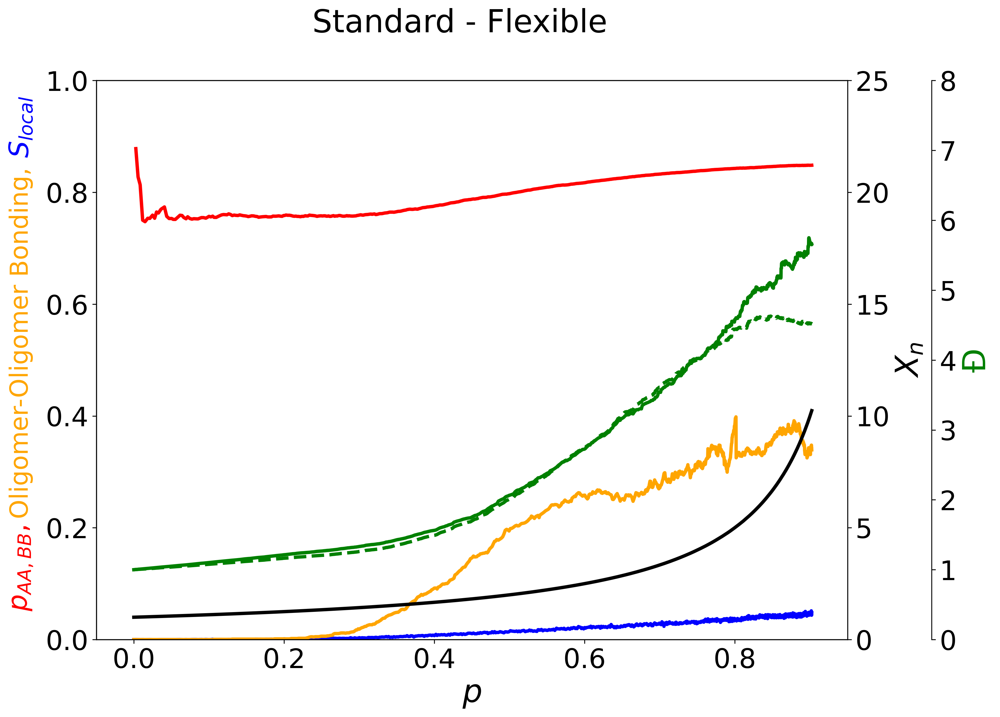

In [35]:
#Flexible - standard
simid = 19
sim = sims[simid]



fig, host = plt.subplots(1,1,figsize=(12,9))
fig.suptitle('Standard - Flexible',fontsize=BIGGER_SIZE)
#fig.suptitle('$\epsilon_{AA} = 0.5 k_BT$, $\epsilon_{AB} = 0.2 k_BT$,  $\epsilon_{BB} = 0.1 k_BT$',fontsize=20)

par1 = host.twinx()
par2 = host.twinx()


host.set_xlim(-0.05, 0.95)
host.set_ylim(0, 1)
par1.set_ylim(0, 25)
par2.set_ylim(0, 8)

host.set_xlabel(r"$p$")
par1.set_ylabel(r"$X_n$")
par2.set_ylabel(u'\u0110')



# y-axis label
ybox1 = TextArea("$p_{AA,BB}$,", textprops=dict(color="r", size=MEDIUM_SIZE ,rotation='vertical',ha='left',va='bottom'))
ybox2 = TextArea("Oligomer-Oligomer Bonding,", textprops=dict(color="orange", size=MEDIUM_SIZE-2,rotation='vertical',ha='left',va='bottom'))
ybox3 = TextArea("$S_{local}$", textprops=dict(color="b", size=MEDIUM_SIZE,rotation='vertical',ha='left',va='bottom'))
ybox = VPacker(children= [ybox3, ybox2, ybox1], align="center", pad=0, sep=8)


anchored_ybox = AnchoredOffsetbox(loc='center', child=ybox, pad=0., frameon=False,bbox_to_anchor=(-0.1, 0.5),bbox_transform=host.transAxes, borderpad=1.)



#sim index:
#    0         1          2         3         4            5          6          7                 8           9      10     11       12    13          14
#[extent_avg,order_avg,tstep_avg,probs_avg,blockAtotal,blockBtotal,chaindist,BlockA_PDI_avg,BlockB_PDI_avg,PDI_avg,pA_avg,pB_avg,seqs_all,Xn_avg,TotalBlock_PDI_avg]
# probs_avg index
#[pAA_avg,pAB_avg,pBB_avg]


p1, = host.plot(sim[0], (sim[3][0]+sim[3][2]), label="pAA,BB", color='r', linewidth=lw)
p2, = host.plot(sim[0], sim[1], label="$S_{local}$", color = 'b', linewidth=lw)
p_extra, = host.plot(sim[0],rxn_plot[simid][8],color='orange',label='Oligomer-Oligomer Bonding', linewidth=lw)
p3, = par1.plot(sim[0],sim[13] , label=r"X_n", color='k', linewidth=lw) 
p4, = par2.plot(sim[0], sim[9], label=u"\u0110", color='g', linewidth=lw)
p5, = par2.plot(sim[0],((sim[7]+sim[8])/2), label=u"Block \u0110", color='g', linestyle='dashed', linewidth=lw)
lns = [p1, p2, p_extra, p3, p4, p5]







# right, left, top, bottom
par2.spines['right'].set_position(('outward', 75))

host.add_artist(anchored_ybox)
par1.yaxis.label.set_color(p3.get_color())
par2.yaxis.label.set_color(p4.get_color())
#host.legend(handles=lns, loc='best');

#fig.savefig('220725_standard_kinetics',transparent=True,bbox_inches='tight',dpi=300)
        
plt.show()

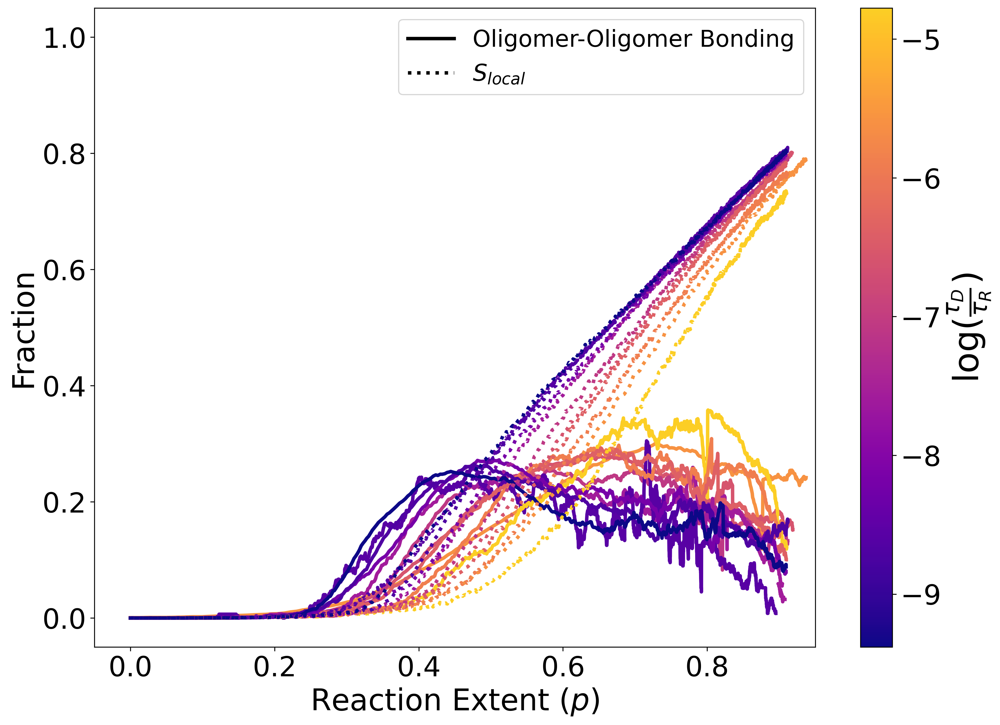

In [36]:
fig,ax = plt.subplots(1,1,figsize=(14,10))

ax.plot([-12,-11],[-12,-11],'-k',linewidth=lw)
ax.plot([-12,-11],[-12,-11],':k',linewidth=lw)



#oligo-oligo bonding
barPlt1 = ax.plot(sims[1][0],rxn_plot[1][8],color=cmap3(c_ids3[1]),linewidth=lw)
barPlt2 = ax.plot(sims[2][0],rxn_plot[2][8],color=cmap3(c_ids3[2]),linewidth=lw)
Standard = ax.plot(sims[0][0],rxn_plot[0][8],color=cmap3(c_ids3[0]),linewidth=lw)
barPlt3 = ax.plot(sims[3][0],rxn_plot[3][8],color=cmap3(c_ids3[3]),linewidth=lw)
barPlt4 = ax.plot(sims[4][0],rxn_plot[4][8],color=cmap3(c_ids3[4]),linewidth=lw)
dampPlt1 = ax.plot(sims[10][0],rxn_plot[10][8],color=cmap3(c_ids3[10]),linewidth=lw)
dampPlt1ZZ = ax.plot(sims[11][0],rxn_plot[11][8],color=cmap3(c_ids3[11]),linewidth=lw)
dampPlt2 = ax.plot(sims[12][0],rxn_plot[12][8],color=cmap3(c_ids3[12]),linewidth=lw)
dampPlt2ZZ = ax.plot(sims[13][0],rxn_plot[13][8],color=cmap3(c_ids3[13]),linewidth=lw)
dampPlt3 = ax.plot(sims[14][0],rxn_plot[14][8],color=cmap3(c_ids3[14]),linewidth=lw)
dampPlt4 = ax.plot(sims[15][0],rxn_plot[15][8],color=cmap3(c_ids3[15]),linewidth=lw)


#S_local
ax.plot(sims[1][0],sims[1][1],color=cmap3(c_ids3[1]),linewidth=lw,linestyle=':')
ax.plot(sims[2][0],sims[2][1],color=cmap3(c_ids3[2]),linewidth=lw,linestyle=':')
ax.plot(sims[0][0],sims[0][1],color=cmap3(c_ids3[0]),linewidth=lw,linestyle=':')
ax.plot(sims[3][0],sims[3][1],color=cmap3(c_ids3[3]),linewidth=lw,linestyle=':')
ax.plot(sims[4][0],sims[4][1],color=cmap3(c_ids3[4]),linewidth=lw,linestyle=':')
ax.plot(sims[10][0],sims[10][1],color=cmap3(c_ids3[10]),linewidth=lw,linestyle=':')
ax.plot(sims[11][0],sims[11][1],color=cmap3(c_ids3[11]),linewidth=lw,linestyle=':')
ax.plot(sims[12][0],sims[12][1],color=cmap3(c_ids3[12]),linewidth=lw,linestyle=':')
ax.plot(sims[13][0],sims[13][1],color=cmap3(c_ids3[13]),linewidth=lw,linestyle=':')
ax.plot(sims[14][0],sims[14][1],color=cmap3(c_ids3[14]),linewidth=lw,linestyle=':')
ax.plot(sims[15][0],sims[15][1],color=cmap3(c_ids3[15]),linewidth=lw,linestyle=':')

#colorbar
cbar = plt.colorbar(sm3,ax=ax)#,label=r'$\frac{\tau_D}{\tau_R}$');
#cbar.formatter.set_powerlimits((0, 0))
cbar.set_label(label=r'log$(\frac{\tau_D}{\tau_R})$',size=30)
ax.yaxis.offsetText.set_fontsize(30)
#cbar.ax.set_yticklabels('')


ax.set_xlim(-0.05, 0.95)
ax.set_ylim((-0.05,1.05))
ax.set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
ax.set_ylabel('Fraction',fontsize=26);
ax.legend(('Oligomer-Oligomer Bonding','$S_{local}$'));

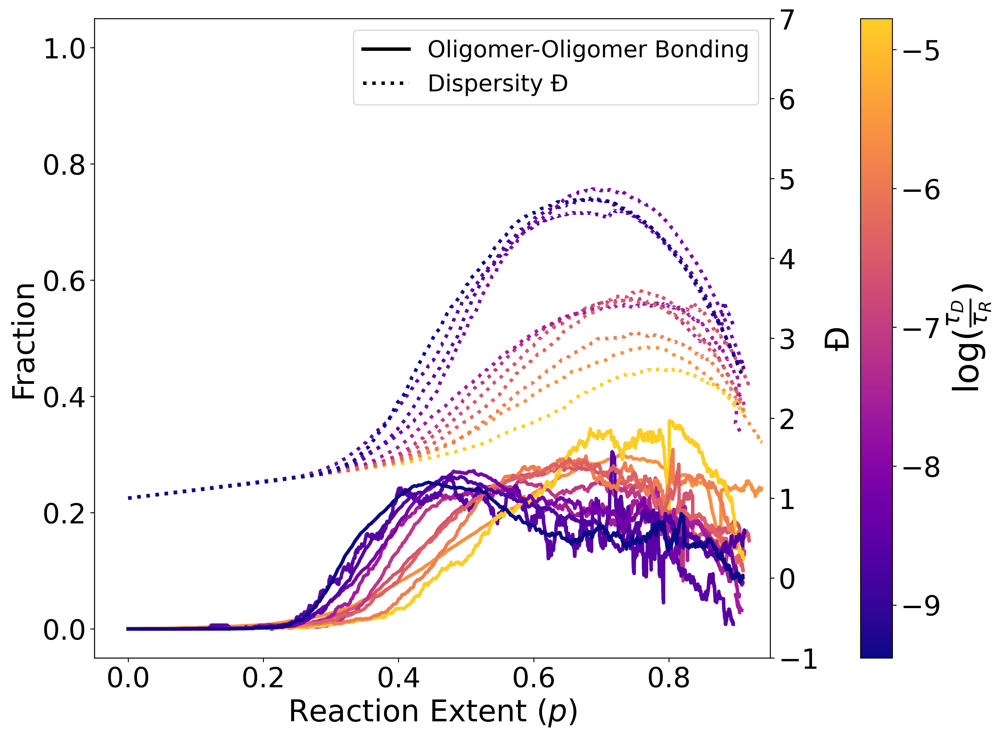

In [37]:
fig,ax = plt.subplots(1,1,figsize=(14,10))

ax.plot([-12,-11],[-12,-11],'-k',linewidth=lw)
ax.plot([-12,-11],[-12,-11],':k',linewidth=lw)

par = ax.twinx()
par.set_ylim(-1, 7)
par.set_ylabel(u'\u0110')


#oligo-oligo bonding
barPlt1 = ax.plot(sims[1][0],rxn_plot[1][8],color=cmap3(c_ids3[1]),linewidth=lw)
barPlt2 = ax.plot(sims[2][0],rxn_plot[2][8],color=cmap3(c_ids3[2]),linewidth=lw)
Standard = ax.plot(sims[0][0],rxn_plot[0][8],color=cmap3(c_ids3[0]),linewidth=lw)
barPlt3 = ax.plot(sims[3][0],rxn_plot[3][8],color=cmap3(c_ids3[3]),linewidth=lw)
barPlt4 = ax.plot(sims[4][0],rxn_plot[4][8],color=cmap3(c_ids3[4]),linewidth=lw)
dampPlt1 = ax.plot(sims[10][0],rxn_plot[10][8],color=cmap3(c_ids3[10]),linewidth=lw)
dampPlt1ZZ = ax.plot(sims[11][0],rxn_plot[11][8],color=cmap3(c_ids3[11]),linewidth=lw)
dampPlt2 = ax.plot(sims[12][0],rxn_plot[12][8],color=cmap3(c_ids3[12]),linewidth=lw)
dampPlt2ZZ = ax.plot(sims[13][0],rxn_plot[13][8],color=cmap3(c_ids3[13]),linewidth=lw)
dampPlt3 = ax.plot(sims[14][0],rxn_plot[14][8],color=cmap3(c_ids3[14]),linewidth=lw)
dampPlt4 = ax.plot(sims[15][0],rxn_plot[15][8],color=cmap3(c_ids3[15]),linewidth=lw)


#dispersity
par.plot(sims[1][0],sims[1][9],color=cmap3(c_ids3[1]),linewidth=lw,linestyle=':')
par.plot(sims[2][0],sims[2][9],color=cmap3(c_ids3[2]),linewidth=lw,linestyle=':')
par.plot(sims[0][0],sims[0][9],color=cmap3(c_ids3[0]),linewidth=lw,linestyle=':')
par.plot(sims[3][0],sims[3][9],color=cmap3(c_ids3[3]),linewidth=lw,linestyle=':')
par.plot(sims[4][0],sims[4][9],color=cmap3(c_ids3[4]),linewidth=lw,linestyle=':')
par.plot(sims[10][0],sims[10][9],color=cmap3(c_ids3[10]),linewidth=lw,linestyle=':')
par.plot(sims[11][0],sims[11][9],color=cmap3(c_ids3[11]),linewidth=lw,linestyle=':')
par.plot(sims[12][0],sims[12][9],color=cmap3(c_ids3[12]),linewidth=lw,linestyle=':')
par.plot(sims[13][0],sims[13][9],color=cmap3(c_ids3[13]),linewidth=lw,linestyle=':')
par.plot(sims[14][0],sims[14][9],color=cmap3(c_ids3[14]),linewidth=lw,linestyle=':')
par.plot(sims[15][0],sims[15][9],color=cmap3(c_ids3[15]),linewidth=lw,linestyle=':')

#colorbar
cbar = plt.colorbar(sm3,ax=ax, pad=0.1)#,label=r'$\frac{\tau_D}{\tau_R}$');
#cbar.formatter.set_powerlimits((0, 0))
cbar.set_label(label=r'log$(\frac{\tau_D}{\tau_R})$',size=30)
#cbar.ax.set_yticklabels('')


ax.set_xlim(-0.05, 0.95)
ax.set_ylim((-0.05,1.05))
ax.set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
ax.set_ylabel('Fraction',fontsize=26);
ax.legend(('Oligomer-Oligomer Bonding',u'Dispersity \u0110'));

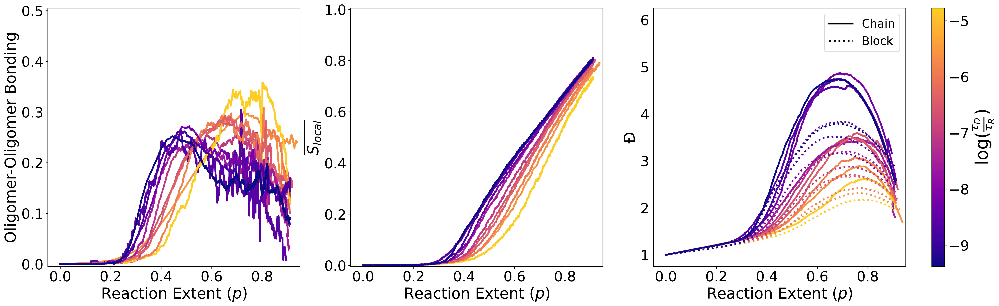

In [38]:
fig,ax = plt.subplots(1,3,figsize=(32,8))

ax[2].plot([-12,-11],[-12,-11],'-k',linewidth=lw)
ax[2].plot([-12,-11],[-12,-11],':k',linewidth=lw)




#oligo-oligo bonding
barPlt1 = ax[0].plot(sims[1][0],rxn_plot[1][8],color=cmap3(c_ids3[1]),linewidth=lw)
barPlt2 = ax[0].plot(sims[2][0],rxn_plot[2][8],color=cmap3(c_ids3[2]),linewidth=lw)
Standard = ax[0].plot(sims[0][0],rxn_plot[0][8],color=cmap3(c_ids3[0]),linewidth=lw)
barPlt3 = ax[0].plot(sims[3][0],rxn_plot[3][8],color=cmap3(c_ids3[3]),linewidth=lw)
barPlt4 = ax[0].plot(sims[4][0],rxn_plot[4][8],color=cmap3(c_ids3[4]),linewidth=lw)
dampPlt1 = ax[0].plot(sims[10][0],rxn_plot[10][8],color=cmap3(c_ids3[10]),linewidth=lw)
dampPlt1ZZ = ax[0].plot(sims[11][0],rxn_plot[11][8],color=cmap3(c_ids3[11]),linewidth=lw)
dampPlt2 = ax[0].plot(sims[12][0],rxn_plot[12][8],color=cmap3(c_ids3[12]),linewidth=lw)
dampPlt2ZZ = ax[0].plot(sims[13][0],rxn_plot[13][8],color=cmap3(c_ids3[13]),linewidth=lw)
dampPlt3 = ax[0].plot(sims[14][0],rxn_plot[14][8],color=cmap3(c_ids3[14]),linewidth=lw)
dampPlt4 = ax[0].plot(sims[15][0],rxn_plot[15][8],color=cmap3(c_ids3[15]),linewidth=lw)


#S_local
ax[1].plot(sims[1][0],sims[1][1],color=cmap3(c_ids3[1]),linewidth=lw,linestyle='-')
ax[1].plot(sims[2][0],sims[2][1],color=cmap3(c_ids3[2]),linewidth=lw,linestyle='-')
ax[1].plot(sims[0][0],sims[0][1],color=cmap3(c_ids3[0]),linewidth=lw,linestyle='-')
ax[1].plot(sims[3][0],sims[3][1],color=cmap3(c_ids3[3]),linewidth=lw,linestyle='-')
ax[1].plot(sims[4][0],sims[4][1],color=cmap3(c_ids3[4]),linewidth=lw,linestyle='-')
ax[1].plot(sims[10][0],sims[10][1],color=cmap3(c_ids3[10]),linewidth=lw,linestyle='-')
ax[1].plot(sims[11][0],sims[11][1],color=cmap3(c_ids3[11]),linewidth=lw,linestyle='-')
ax[1].plot(sims[12][0],sims[12][1],color=cmap3(c_ids3[12]),linewidth=lw,linestyle='-')
ax[1].plot(sims[13][0],sims[13][1],color=cmap3(c_ids3[13]),linewidth=lw,linestyle='-')
ax[1].plot(sims[14][0],sims[14][1],color=cmap3(c_ids3[14]),linewidth=lw,linestyle='-')
ax[1].plot(sims[15][0],sims[15][1],color=cmap3(c_ids3[15]),linewidth=lw,linestyle='-')


#dispersity
ax[2].plot(sims[1][0],sims[1][9],color=cmap3(c_ids3[1]),linewidth=lw,linestyle='-')
ax[2].plot(sims[2][0],sims[2][9],color=cmap3(c_ids3[2]),linewidth=lw,linestyle='-')
ax[2].plot(sims[0][0],sims[0][9],color=cmap3(c_ids3[0]),linewidth=lw,linestyle='-')
ax[2].plot(sims[3][0],sims[3][9],color=cmap3(c_ids3[3]),linewidth=lw,linestyle='-')
ax[2].plot(sims[4][0],sims[4][9],color=cmap3(c_ids3[4]),linewidth=lw,linestyle='-')
ax[2].plot(sims[10][0],sims[10][9],color=cmap3(c_ids3[10]),linewidth=lw,linestyle='-')
ax[2].plot(sims[11][0],sims[11][9],color=cmap3(c_ids3[11]),linewidth=lw,linestyle='-')
ax[2].plot(sims[12][0],sims[12][9],color=cmap3(c_ids3[12]),linewidth=lw,linestyle='-')
ax[2].plot(sims[13][0],sims[13][9],color=cmap3(c_ids3[13]),linewidth=lw,linestyle='-')
ax[2].plot(sims[14][0],sims[14][9],color=cmap3(c_ids3[14]),linewidth=lw,linestyle='-')
ax[2].plot(sims[15][0],sims[15][9],color=cmap3(c_ids3[15]),linewidth=lw,linestyle='-')

#(sim[7]+sim[8])/2

ax[2].plot(sims[1][0],(sims[1][7]+sims[1][8])/2,color=cmap3(c_ids3[1]),linewidth=lw,linestyle=':')
ax[2].plot(sims[2][0],(sims[2][7]+sims[2][8])/2,color=cmap3(c_ids3[2]),linewidth=lw,linestyle=':')
ax[2].plot(sims[0][0],(sims[0][7]+sims[0][8])/2,color=cmap3(c_ids3[0]),linewidth=lw,linestyle=':')
ax[2].plot(sims[3][0],(sims[3][7]+sims[3][8])/2,color=cmap3(c_ids3[3]),linewidth=lw,linestyle=':')
ax[2].plot(sims[4][0],(sims[4][7]+sims[4][8])/2,color=cmap3(c_ids3[4]),linewidth=lw,linestyle=':')
ax[2].plot(sims[10][0],(sims[10][7]+sims[10][8])/2,color=cmap3(c_ids3[10]),linewidth=lw,linestyle=':')
ax[2].plot(sims[11][0],(sims[11][7]+sims[11][8])/2,color=cmap3(c_ids3[11]),linewidth=lw,linestyle=':')
ax[2].plot(sims[12][0],(sims[12][7]+sims[12][8])/2,color=cmap3(c_ids3[12]),linewidth=lw,linestyle=':')
ax[2].plot(sims[13][0],(sims[13][7]+sims[13][8])/2,color=cmap3(c_ids3[13]),linewidth=lw,linestyle=':')
ax[2].plot(sims[14][0],(sims[14][7]+sims[14][8])/2,color=cmap3(c_ids3[14]),linewidth=lw,linestyle=':')
ax[2].plot(sims[15][0],(sims[15][7]+sims[15][8])/2,color=cmap3(c_ids3[15]),linewidth=lw,linestyle=':')


#colorbar
cbar = plt.colorbar(sm3,ax=ax.ravel().tolist(),pad=0.025)#,label=r'$\frac{\tau_D}{\tau_R}$');
#cbar.formatter.set_powerlimits((0, 0))
cbar.set_label(label=r'log$(\frac{\tau_D}{\tau_R})$',size=30)
#ax.yaxis.offsetText.set_fontsize(30)
#cbar.ax.set_yticklabels('')

for curax in ax.ravel().tolist():
    curax.set_xlim(-0.05, 0.95)
    curax.set_xlabel(r'Reaction Extent ($p$)',fontsize=26)
ax[0].set_ylim((-0.005,0.505))
ax[1].set_ylim((-0.005,1.005))
ax[2].set_ylim((0.75,6.25))

ax[0].set_ylabel('Oligomer-Oligomer Bonding',fontsize=26);
ax[1].set_ylabel(r'$\overline{S_{local}}$',fontsize=26);
ax[2].set_ylabel(u'\u0110',fontsize=26);
ax[2].legend(('Chain','Block'));

fig.savefig('copoly3_Timescales_Shifts_Oligo_Order_Disp.png',dpi=300, bbox_inches='tight')

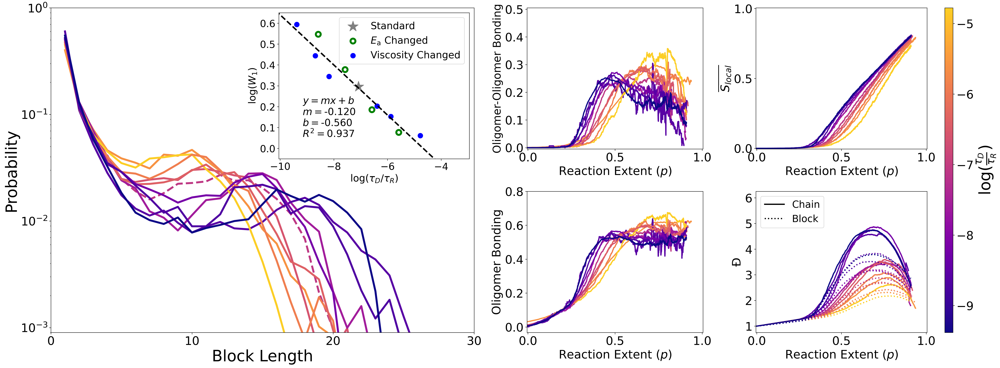

In [39]:
fig = plt.figure(figsize=(34,12))
gs = fig.add_gridspec(ncols=4,nrows=2, width_ratios=[1,1,0.95,1.2], height_ratios = [1,1], hspace = 0.3, wspace=0.275)
ax1 = fig.add_subplot(gs[:2,:2])
ax2 = fig.add_subplot(gs[0,2])
ax5 = fig.add_subplot(gs[1,2])
ax3 = fig.add_subplot(gs[0,3])
ax4 = fig.add_subplot(gs[1,3])

side_font_size = 22+2
main_font_size = 30+2
lw =4.
inset_font_size=18+2
inset_lw = 3.


#block length
barPlt1 = ax1.plot(x,BlockDistB1/np.sum(BlockDistB1),color=cmap3(c_ids3[1]),linewidth=lw)
barPlt2 = ax1.plot(x,BlockDistB2/np.sum(BlockDistB2),color=cmap3(c_ids3[2]),linewidth=lw)
barPltS = ax1.plot(x,BlockDistS/np.sum(BlockDistS),color=cmap3(c_ids3[0]),linewidth=lw, linestyle='--')
barPlt3 = ax1.plot(x,BlockDistB3/np.sum(BlockDistB3),color=cmap3(c_ids3[3]),linewidth=lw)
barPlt4 = ax1.plot(x,BlockDistB4/np.sum(BlockDistB4),color=cmap3(c_ids3[4]),linewidth=lw)

dampPlt1 = ax1.plot(x,BlockDistD1/np.sum(BlockDistD1),color=cmap3(c_ids3[10]),linewidth=lw)
dampPlt1ZZ = ax1.plot(x,BlockDistD2/np.sum(BlockDistD2),color=cmap3(c_ids3[11]),linewidth=lw)
dampPlt2 = ax1.plot(x,BlockDistD3/np.sum(BlockDistD3),color=cmap3(c_ids3[12]),linewidth=lw)
dampPlt2ZZ = ax1.plot(x,BlockDistD4/np.sum(BlockDistD4),color=cmap3(c_ids3[13]),linewidth=lw)
dampPlt3 = ax1.plot(x,BlockDistD5/np.sum(BlockDistD5),color=cmap3(c_ids3[14]),linewidth=lw)
dampPlt4 = ax1.plot(x,BlockDistD6/np.sum(BlockDistD6),color=cmap3(c_ids3[15]),linewidth=lw)

ax1.set_yscale('log')
ax1.set_xlim((0,30))
ax1.set_ylim((9e-4,1))
ax1.set_xticks([0,10,20,30])
ax1.set_xlabel('Block Length',fontsize=main_font_size)
ax1.set_ylabel('Probability',fontsize=main_font_size);


#insert for fitting Wasserstein to timescale ratio
host = inset_axes(ax1, width='45%', height='45%', loc='upper right',borderpad=0.5)
host.tick_params(axis='both', which='major', labelsize=inset_font_size)
host.set_ylim(-0.05, 0.65)
host.set_xlabel(r"log$(\tau_{D}/\tau_{R})$",size=inset_font_size)
host.set_ylabel(r"log$(W_1)$",size=inset_font_size)


for i,value in enumerate(char_block_len):
    if i == 0:
        ins_leg1=host.scatter(np.log(timescale_ratio[i]),np.log(block_emd[i]),500,color='gray',marker='*')
    if i in [1,2,3,4]:
        ins_leg2=host.scatter(np.log(timescale_ratio[i]),np.log(block_emd[i]),100,linewidth=lw,edgecolor='g',facecolor='none',marker='o')
    if i in [10,11,12,13,14,15]:
        ins_leg3=host.scatter(np.log(timescale_ratio[i]),np.log(block_emd[i]),100,color='b',marker='o')

#patch1 = patches.Patch(color='gray', label='Standard')
#patch2 = patches.Patch(color='green', label=r'$E_{\rm a}$ Changed')
#patch3 = patches.Patch(color='blue', label='Viscosity Changed')
#host.legend(handles = [patch1,patch2,patch3],fontsize=inset_font_size)
host.legend(handles = [ins_leg1,ins_leg2,ins_leg3],labels=['Standard',r'$E_{\rm a}$ Changed','Viscosity Changed'],fontsize=inset_font_size)        
        
selected_trials = [0,1,2,3,4,10,11,12,13,14,15]
xfit_data = np.array([np.log(timescale_ratio[i]) for i in selected_trials])
yfit_data = np.array([np.log(block_emd[i]) for i in selected_trials])
linfit = LinearRegression().fit(xfit_data.reshape(-1,1),yfit_data)
linex = np.linspace(min(xfit_data)-1,max(xfit_data)+1,20)
liney = linfit.intercept_ + linfit.coef_*linex
R2_score = linfit.score(xfit_data.reshape(-1,1),yfit_data)
m = linfit.coef_[0]
b = linfit.intercept_
host.text(0.125,0.15,r'$y = mx + b$'+ '\n'+('$m = ${:.3f}'.format(m)) +'\n'+'$b = ${:.3f}'.format(b) + '\n' + '$R^2 = {:.3f}$'.format(R2_score),transform = host.transAxes,fontsize=inset_font_size)
host.plot(linex,liney,'--k',linewidth=inset_lw)
#host.set_xlim(-13.05, -7.05);
host.set_xlim(int(min(xfit_data)-1)-0.05,int(max(xfit_data)+1)+0.05)               

    


lw=2.5
ax4.plot([-12,-11],[-12,-11],'-k',linewidth=lw)
ax4.plot([-12,-11],[-12,-11],':k',linewidth=lw)



#oligo bonding
barPlt1 = ax5.plot(sims[1][0],rxn_plot[1][6],color=cmap3(c_ids3[1]),linewidth=lw)
barPlt2 = ax5.plot(sims[2][0],rxn_plot[2][6],color=cmap3(c_ids3[2]),linewidth=lw)
Standard = ax5.plot(sims[0][0],rxn_plot[0][6],color=cmap3(c_ids3[0]),linewidth=lw)
barPlt3 = ax5.plot(sims[3][0],rxn_plot[3][6],color=cmap3(c_ids3[3]),linewidth=lw)
barPlt4 = ax5.plot(sims[4][0],rxn_plot[4][6],color=cmap3(c_ids3[4]),linewidth=lw)
dampPlt1 = ax5.plot(sims[10][0],rxn_plot[10][6],color=cmap3(c_ids3[10]),linewidth=lw)
dampPlt1ZZ = ax5.plot(sims[11][0],rxn_plot[11][6],color=cmap3(c_ids3[11]),linewidth=lw)
dampPlt2 = ax5.plot(sims[12][0],rxn_plot[12][6],color=cmap3(c_ids3[12]),linewidth=lw)
dampPlt2ZZ = ax5.plot(sims[13][0],rxn_plot[13][6],color=cmap3(c_ids3[13]),linewidth=lw)
dampPlt3 = ax5.plot(sims[14][0],rxn_plot[14][6],color=cmap3(c_ids3[14]),linewidth=lw)
dampPlt4 = ax5.plot(sims[15][0],rxn_plot[15][6],color=cmap3(c_ids3[15]),linewidth=lw)



#oligo-oligo bonding
barPlt1 = ax2.plot(sims[1][0],rxn_plot[1][8],color=cmap3(c_ids3[1]),linewidth=lw)
barPlt2 = ax2.plot(sims[2][0],rxn_plot[2][8],color=cmap3(c_ids3[2]),linewidth=lw)
Standard = ax2.plot(sims[0][0],rxn_plot[0][8],color=cmap3(c_ids3[0]),linewidth=lw)
barPlt3 = ax2.plot(sims[3][0],rxn_plot[3][8],color=cmap3(c_ids3[3]),linewidth=lw)
barPlt4 = ax2.plot(sims[4][0],rxn_plot[4][8],color=cmap3(c_ids3[4]),linewidth=lw)
dampPlt1 = ax2.plot(sims[10][0],rxn_plot[10][8],color=cmap3(c_ids3[10]),linewidth=lw)
dampPlt1ZZ = ax2.plot(sims[11][0],rxn_plot[11][8],color=cmap3(c_ids3[11]),linewidth=lw)
dampPlt2 = ax2.plot(sims[12][0],rxn_plot[12][8],color=cmap3(c_ids3[12]),linewidth=lw)
dampPlt2ZZ = ax2.plot(sims[13][0],rxn_plot[13][8],color=cmap3(c_ids3[13]),linewidth=lw)
dampPlt3 = ax2.plot(sims[14][0],rxn_plot[14][8],color=cmap3(c_ids3[14]),linewidth=lw)
dampPlt4 = ax2.plot(sims[15][0],rxn_plot[15][8],color=cmap3(c_ids3[15]),linewidth=lw)


#S_local
ax3.plot(sims[1][0],sims[1][1],color=cmap3(c_ids3[1]),linewidth=lw,linestyle='-')
ax3.plot(sims[2][0],sims[2][1],color=cmap3(c_ids3[2]),linewidth=lw,linestyle='-')
ax3.plot(sims[0][0],sims[0][1],color=cmap3(c_ids3[0]),linewidth=lw,linestyle='-')
ax3.plot(sims[3][0],sims[3][1],color=cmap3(c_ids3[3]),linewidth=lw,linestyle='-')
ax3.plot(sims[4][0],sims[4][1],color=cmap3(c_ids3[4]),linewidth=lw,linestyle='-')
ax3.plot(sims[10][0],sims[10][1],color=cmap3(c_ids3[10]),linewidth=lw,linestyle='-')
ax3.plot(sims[11][0],sims[11][1],color=cmap3(c_ids3[11]),linewidth=lw,linestyle='-')
ax3.plot(sims[12][0],sims[12][1],color=cmap3(c_ids3[12]),linewidth=lw,linestyle='-')
ax3.plot(sims[13][0],sims[13][1],color=cmap3(c_ids3[13]),linewidth=lw,linestyle='-')
ax3.plot(sims[14][0],sims[14][1],color=cmap3(c_ids3[14]),linewidth=lw,linestyle='-')
ax3.plot(sims[15][0],sims[15][1],color=cmap3(c_ids3[15]),linewidth=lw,linestyle='-')


#dispersity
ax4.plot(sims[1][0],sims[1][9],color=cmap3(c_ids3[1]),linewidth=lw,linestyle='-')
ax4.plot(sims[2][0],sims[2][9],color=cmap3(c_ids3[2]),linewidth=lw,linestyle='-')
ax4.plot(sims[0][0],sims[0][9],color=cmap3(c_ids3[0]),linewidth=lw,linestyle='-')
ax4.plot(sims[3][0],sims[3][9],color=cmap3(c_ids3[3]),linewidth=lw,linestyle='-')
ax4.plot(sims[4][0],sims[4][9],color=cmap3(c_ids3[4]),linewidth=lw,linestyle='-')
ax4.plot(sims[10][0],sims[10][9],color=cmap3(c_ids3[10]),linewidth=lw,linestyle='-')
ax4.plot(sims[11][0],sims[11][9],color=cmap3(c_ids3[11]),linewidth=lw,linestyle='-')
ax4.plot(sims[12][0],sims[12][9],color=cmap3(c_ids3[12]),linewidth=lw,linestyle='-')
ax4.plot(sims[13][0],sims[13][9],color=cmap3(c_ids3[13]),linewidth=lw,linestyle='-')
ax4.plot(sims[14][0],sims[14][9],color=cmap3(c_ids3[14]),linewidth=lw,linestyle='-')
ax4.plot(sims[15][0],sims[15][9],color=cmap3(c_ids3[15]),linewidth=lw,linestyle='-')

#(sim[7]+sim[8])/2

ax4.plot(sims[1][0],(sims[1][7]+sims[1][8])/2,color=cmap3(c_ids3[1]),linewidth=lw,linestyle=':')
ax4.plot(sims[2][0],(sims[2][7]+sims[2][8])/2,color=cmap3(c_ids3[2]),linewidth=lw,linestyle=':')
ax4.plot(sims[0][0],(sims[0][7]+sims[0][8])/2,color=cmap3(c_ids3[0]),linewidth=lw,linestyle=':')
ax4.plot(sims[3][0],(sims[3][7]+sims[3][8])/2,color=cmap3(c_ids3[3]),linewidth=lw,linestyle=':')
ax4.plot(sims[4][0],(sims[4][7]+sims[4][8])/2,color=cmap3(c_ids3[4]),linewidth=lw,linestyle=':')
ax4.plot(sims[10][0],(sims[10][7]+sims[10][8])/2,color=cmap3(c_ids3[10]),linewidth=lw,linestyle=':')
ax4.plot(sims[11][0],(sims[11][7]+sims[11][8])/2,color=cmap3(c_ids3[11]),linewidth=lw,linestyle=':')
ax4.plot(sims[12][0],(sims[12][7]+sims[12][8])/2,color=cmap3(c_ids3[12]),linewidth=lw,linestyle=':')
ax4.plot(sims[13][0],(sims[13][7]+sims[13][8])/2,color=cmap3(c_ids3[13]),linewidth=lw,linestyle=':')
ax4.plot(sims[14][0],(sims[14][7]+sims[14][8])/2,color=cmap3(c_ids3[14]),linewidth=lw,linestyle=':')
ax4.plot(sims[15][0],(sims[15][7]+sims[15][8])/2,color=cmap3(c_ids3[15]),linewidth=lw,linestyle=':')




for curax in [ax2,ax3,ax4,ax5]:
    curax.set_xlim(-0.005, 1.005)
    curax.set_xticks([0,0.5,1.0])
    curax.set_xlabel(r'Reaction Extent ($p$)',fontsize=side_font_size)
    curax.tick_params(axis='both', which='major', labelsize=side_font_size)
ax2.set_ylim((-0.005,0.505))
ax2.set_yticks([0,0.1,0.2,0.3,0.4,0.5])
ax5.set_yticks([0,0.2,0.4,0.6,0.8])
ax3.set_ylim((-0.005,1.005))
ax3.set_yticks([0,0.5,1.0])
ax4.set_ylim((0.75,6.25))

ax5.set_ylabel('Oligomer Bonding',fontsize=side_font_size);
ax2.set_ylabel('Oligomer-Oligomer Bonding',fontsize=side_font_size-2);
ax3.set_ylabel(r'$\overline{S_{local}}$',fontsize=side_font_size);
ax4.set_ylabel(u'\u0110',fontsize=side_font_size);
ax4.legend(('Chain','Block'), fontsize=inset_font_size);


cbar = plt.colorbar(sm3,ax=[ax3,ax4],aspect=40,pad=0.08)
cbar.set_label(label=r'log$(\frac{\tau_D}{\tau_R})$',size=main_font_size);


plt.show()
fig.savefig('copoly3_Timescales_Combinedv3.png',dpi=300, bbox_inches='tight')

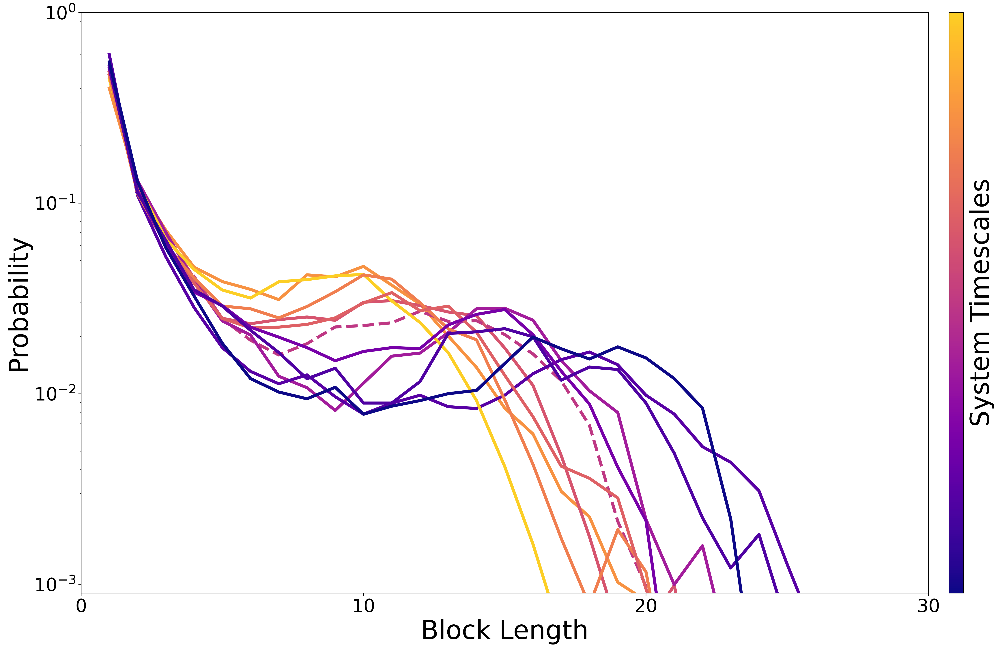

In [40]:
fig = plt.figure(figsize=(24,13.75))
gs = fig.add_gridspec(ncols=2,nrows=2, width_ratios=[1,1], height_ratios = [1,1], hspace = 0.3, wspace=0.275)
ax1 = fig.add_subplot(gs[:2,:2])


side_font_size = 22+2
main_font_size = 32+2
lw =4.



#block length
barPlt1 = ax1.plot(x,BlockDistB1/np.sum(BlockDistB1),color=cmap3(c_ids3[1]),linewidth=lw)
barPlt2 = ax1.plot(x,BlockDistB2/np.sum(BlockDistB2),color=cmap3(c_ids3[2]),linewidth=lw)
barPltS = ax1.plot(x,BlockDistS/np.sum(BlockDistS),color=cmap3(c_ids3[0]),linewidth=lw, linestyle='--')
barPlt3 = ax1.plot(x,BlockDistB3/np.sum(BlockDistB3),color=cmap3(c_ids3[3]),linewidth=lw)
barPlt4 = ax1.plot(x,BlockDistB4/np.sum(BlockDistB4),color=cmap3(c_ids3[4]),linewidth=lw)

dampPlt1 = ax1.plot(x,BlockDistD1/np.sum(BlockDistD1),color=cmap3(c_ids3[10]),linewidth=lw)
dampPlt1ZZ = ax1.plot(x,BlockDistD2/np.sum(BlockDistD2),color=cmap3(c_ids3[11]),linewidth=lw)
dampPlt2 = ax1.plot(x,BlockDistD3/np.sum(BlockDistD3),color=cmap3(c_ids3[12]),linewidth=lw)
dampPlt2ZZ = ax1.plot(x,BlockDistD4/np.sum(BlockDistD4),color=cmap3(c_ids3[13]),linewidth=lw)
dampPlt3 = ax1.plot(x,BlockDistD5/np.sum(BlockDistD5),color=cmap3(c_ids3[14]),linewidth=lw)
dampPlt4 = ax1.plot(x,BlockDistD6/np.sum(BlockDistD6),color=cmap3(c_ids3[15]),linewidth=lw)

ax1.set_yscale('log')
ax1.set_xlim((0,30))
ax1.set_ylim((9e-4,1))
ax1.set_xticks([0,10,20,30])
ax1.set_xlabel('Block Length',fontsize=main_font_size)
ax1.set_ylabel('Probability',fontsize=main_font_size);




cbar = plt.colorbar(sm3,ax=ax1,aspect=40,pad=0.02)
cbar.set_label(label=r'System Timescales',size=main_font_size);
cbar.set_ticks([])

plt.show()
fig.savefig('copoly3_ToC_Plot.png',dpi=300, bbox_inches='tight')

In [41]:
#           0          1           2      3            4            5         6          7                   8        9     10      11    12        13         14              15     16      17     18             
#data = [extent_avg,order_avg,tstep_avg,probs_avg,blockAtotal,blockBtotal,chaindist,BlockA_PDI_avg,BlockB_PDI_avg,PDI_avg,pA_avg,pB_avg,seqs_all,Xn_avg,TotalBlock_PDI_avg,RDFs_avg,RDF2_avg,rxn,clustering]
#print(np.where(sims[0][2]==5000000))
#print(reader.frames[0].keys())
#print(reader.frames[1000]['step'])
snap_steps = np.array([5,10,15,20,25,30,35,40,50,60,80,100]).tolist()
snap_steps_id = [int(10*entry) for entry in snap_steps]
color_ids_snap_steps = (np.array([5,10,15,20,25,30,35,40,50,60,80,100])-5)/95
snap_steps_norm = matplotlib.colors.Normalize(vmin=np.min(snap_steps),vmax=np.max(snap_steps))
snap_steps_cmap = plt.cm.viridis
#snap_steps_cmap = truncate_colormap(plt.cm.viridis,0.,0.9)
snap_steps_sm = plt.cm.ScalarMappable(norm=snap_steps_norm,cmap=snap_steps_cmap)
snap_steps_sm.set_array([])

In [42]:
# simnames = ['200813_copoly3_standard-1', '200817_copoly3_standard-2', '200820_copoly3_standard-3']
# snap_steps_chaindist = [np.zeros(351) for i in snap_steps]
# snap_steps_blockdist = [np.zeros(151) for i in snap_steps]
# for i,simname in enumerate(simnames):
#     reader = chainanalysis.BondReader('./'+simname+'/'+simname)
#     reader.calc()
#     for i,frameid in enumerate(snap_steps_id):
#         ChainDist = reader.frames[frameid]['chaindist']
#         BlockADist = reader.frames[frameid]['blockAdist']
#         BlockBDist = reader.frames[frameid]['blockBdist']
#         for idnum,val in enumerate(ChainDist[0]):
#             snap_steps_chaindist[i][val] += ChainDist[1][idnum]
#         for idnum,val in enumerate(BlockADist[0]):
#             snap_steps_blockdist[i][val] += BlockADist[1][idnum]
#         for idnum,val in enumerate(BlockBDist[0]):
#             snap_steps_blockdist[i][val] += BlockBDist[1][idnum]
# with open('./chain_frames.pickle','wb') as f:
#     pickle.dump(snap_steps_chaindist,f)
# with open('./block_frames.pickle','wb') as f:
#     pickle.dump(snap_steps_blockdist,f)
    
with open('./chain_frames.pickle','rb') as f:
    snap_steps_chaindist=pickle.load(f)
with open('./block_frames.pickle','rb') as f:
    snap_steps_blockdist=pickle.load(f)

In [43]:
# simnames = ['210619_copoly_flexible-1', '220705_copoly_flexible-2', '220705_copoly_flexible-3']
# snap_steps_chaindist_flex = [np.zeros(351) for i in snap_steps]
# snap_steps_blockdist_flex = [np.zeros(151) for i in snap_steps]
# for i,simname in enumerate(simnames):
#     reader = chainanalysis.BondReader('./'+simname+'/'+simname)
#     reader.calc()
#     for i,frameid in enumerate(snap_steps_id):
#         ChainDist = reader.frames[frameid]['chaindist']
#         BlockADist = reader.frames[frameid]['blockAdist']
#         BlockBDist = reader.frames[frameid]['blockBdist']
#         for idnum,val in enumerate(ChainDist[0]):
#             snap_steps_chaindist_flex[i][val] += ChainDist[1][idnum]
#         for idnum,val in enumerate(BlockADist[0]):
#             snap_steps_blockdist_flex[i][val] += BlockADist[1][idnum]
#         for idnum,val in enumerate(BlockBDist[0]):
#             snap_steps_blockdist_flex[i][val] += BlockBDist[1][idnum]
# with open('./chain_frames_flex.pickle','wb') as f:
#     pickle.dump(snap_steps_chaindist_flex,f)
# with open('./block_frames_flex.pickle','wb') as f:
#     pickle.dump(snap_steps_blockdist_flex,f)
    
with open('./chain_frames_flex.pickle','rb') as f:
    snap_steps_chaindist_flex=pickle.load(f)
with open('./block_frames_flex.pickle','rb') as f:
    snap_steps_blockdist_flex=pickle.load(f)

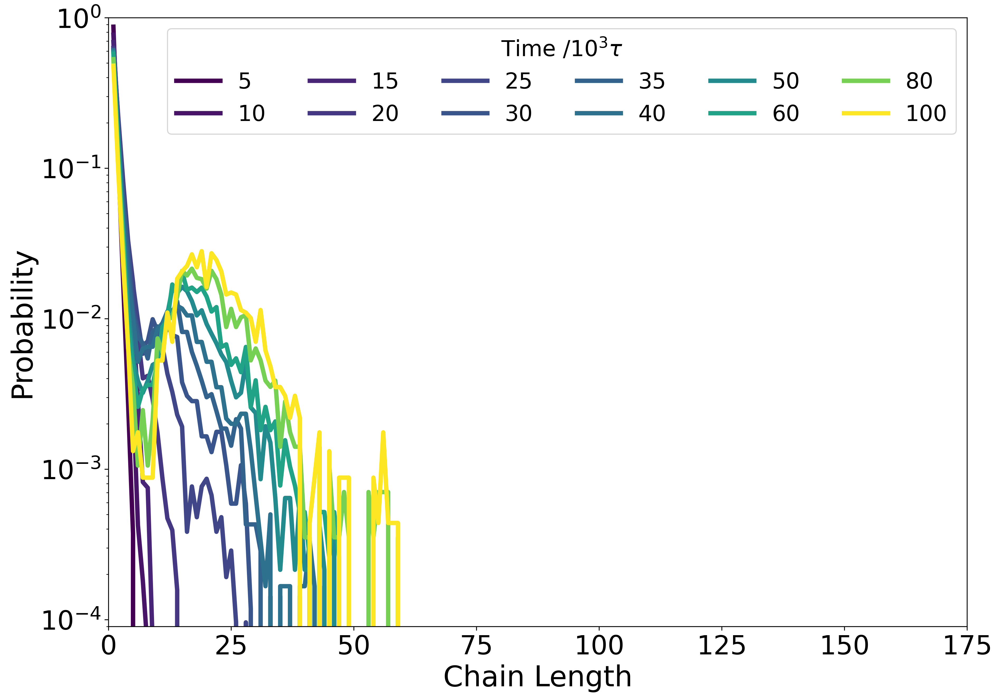

In [44]:
fig,ax = plt.subplots(1,1,figsize=(14,10))

x_chain = np.linspace(1,350,350)
simid=0

#Chain length
for i in range(len(snap_steps)):
    ax.plot(x_chain,snap_steps_chaindist[i][1:]/np.sum(snap_steps_chaindist[i][1:]),color=snap_steps_cmap(color_ids_snap_steps[i]),linewidth=lw)
ax.set_yscale('log')
ax.set_xlim((0,175))
ax.set_ylim((9e-5,1))
ax.set_xticks([0,25,50,75,100,125,150,175])
ax.legend(('5','10','15','20','25','30','35','40','50','60','80','100'), title=r'Time $/ 10^3\tau$',ncol=6);
ax.set_xlabel('Chain Length',fontsize=26)
ax.set_ylabel('Probability',fontsize=26);
fig.savefig('copoly3_poster_chaindist.png',transparent=True,bbox_inches='tight',dpi=300)


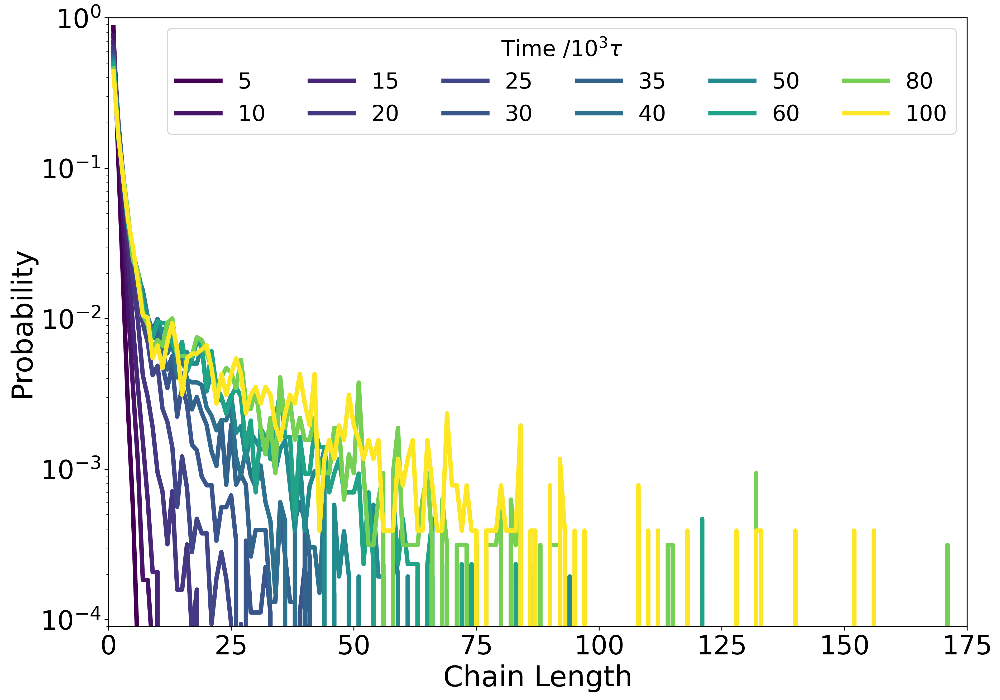

In [45]:
fig,ax = plt.subplots(1,1,figsize=(14,10))

x_chain = np.linspace(1,350,350)
simid=19

#Chain length
for i in range(len(snap_steps)):
    ax.plot(x_chain,snap_steps_chaindist_flex[i][1:]/np.sum(snap_steps_chaindist_flex[i][1:]),color=snap_steps_cmap(color_ids_snap_steps[i]),linewidth=lw)
ax.set_yscale('log')
ax.set_xlim((0,175))
ax.set_ylim((9e-5,1))
ax.set_xticks([0,25,50,75,100,125,150,175])
ax.legend(('5','10','15','20','25','30','35','40','50','60','80','100'), title=r'Time $/ 10^3\tau$',ncol=6);
ax.set_xlabel('Chain Length',fontsize=26)
ax.set_ylabel('Probability',fontsize=26);
fig.savefig('copoly3_poster_chaindist_flex.png',transparent=True,bbox_inches='tight',dpi=300)


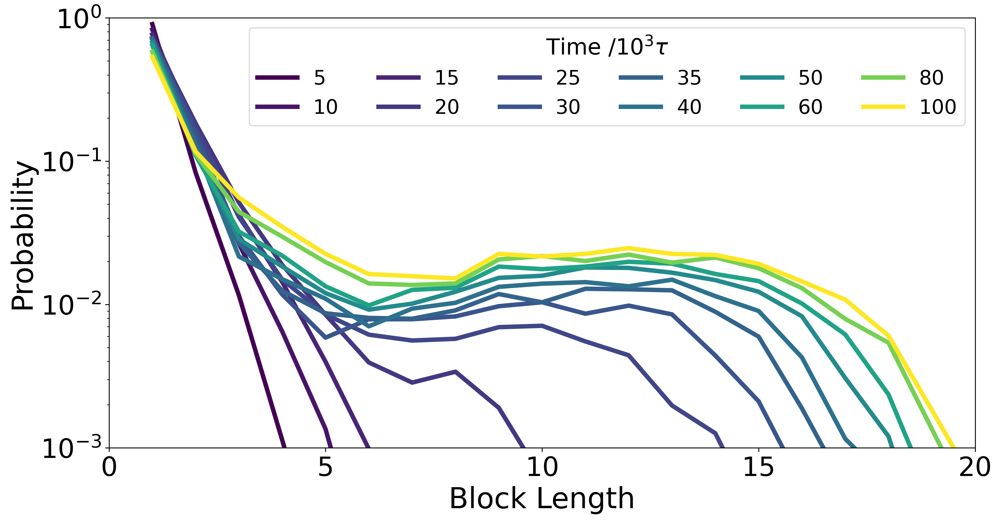

In [46]:
fig,ax = plt.subplots(1,1,figsize=(14,7))

n_block = np.linspace(1,150,150)
simid=0
lw=4.
#Chain length
for i in range(len(snap_steps)):
    ax.plot(n_block,snap_steps_blockdist[i][1:]/np.sum(snap_steps_blockdist[i][1:]),color=snap_steps_cmap(color_ids_snap_steps[i]),linewidth=lw)
ax.set_yscale('log')
ax.set_xlim((0,20))
ax.set_ylim((9.99e-4,1))
ax.set_xticks([0,5,10,15,20])
ax.legend(('5','10','15','20','25','30','35','40','50','60','80','100'), title=r'Time $/ 10^3\tau$',ncol=6,fontsize=18);
ax.set_xlabel('Block Length',fontsize=26)
ax.set_ylabel('Probability',fontsize=26);
fig.savefig('copoly3_ZZrecreated_blockdist.png',transparent=True,bbox_inches='tight',dpi=300)

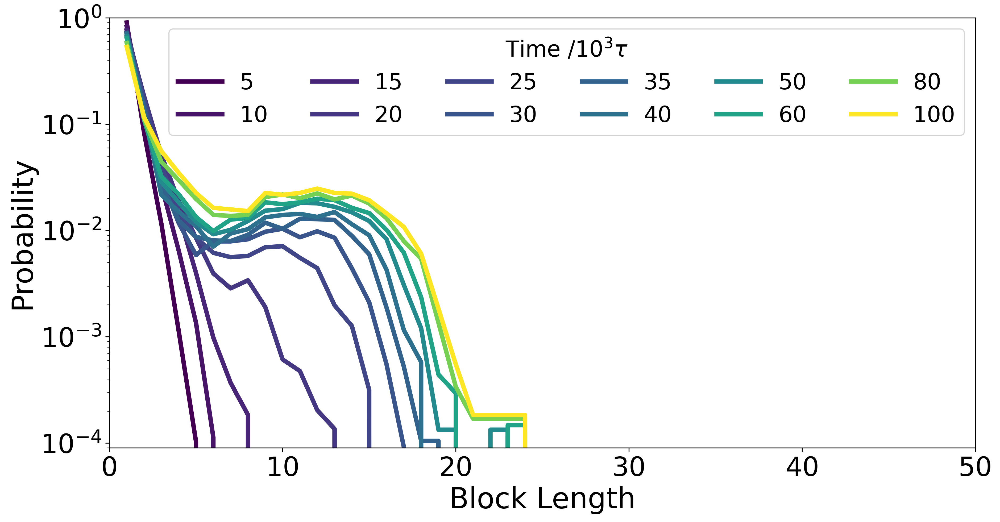

In [47]:
fig,ax = plt.subplots(1,1,figsize=(14,7))

n_block = np.linspace(1,150,150)
simid=0

#Chain length
for i in range(len(snap_steps)):
    ax.plot(n_block,snap_steps_blockdist[i][1:]/np.sum(snap_steps_blockdist[i][1:]),color=snap_steps_cmap(color_ids_snap_steps[i]),linewidth=lw)
ax.set_yscale('log')
ax.set_xlim((0,50))
ax.set_ylim((9e-5,1))
ax.set_xticks([0,10,20,30,40,50])
ax.legend(('5','10','15','20','25','30','35','40','50','60','80','100'), title=r'Time $/ 10^3\tau$',ncol=6);
ax.set_xlabel('Block Length',fontsize=26)
ax.set_ylabel('Probability',fontsize=26);
fig.savefig('copoly3_poster_blockdist.png',transparent=True,bbox_inches='tight',dpi=300)

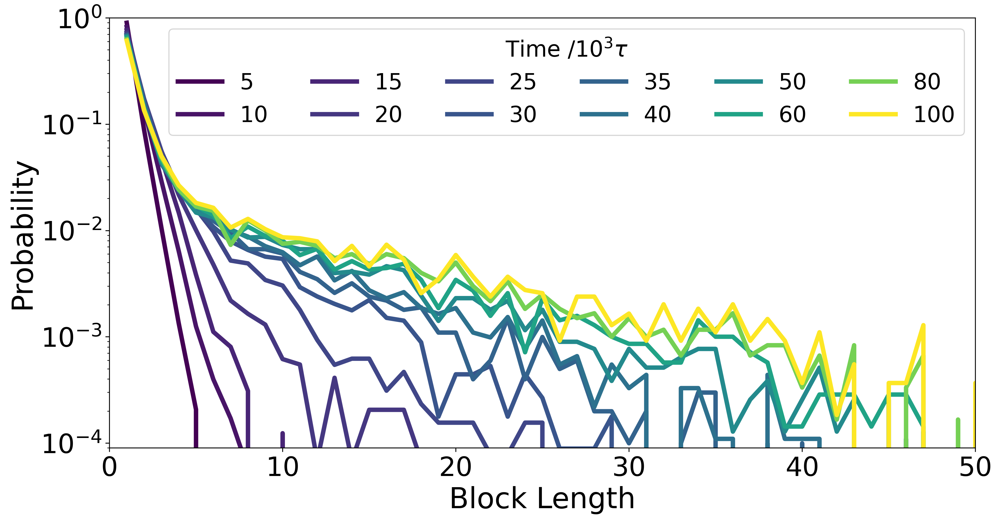

In [48]:
fig,ax = plt.subplots(1,1,figsize=(14,7))

n_block = np.linspace(1,150,150)
simid=19

#Chain length
for i in range(len(snap_steps)):
    ax.plot(n_block,snap_steps_blockdist_flex[i][1:]/np.sum(snap_steps_blockdist_flex[i][1:]),color=snap_steps_cmap(color_ids_snap_steps[i]),linewidth=lw)
ax.set_yscale('log')
ax.set_xlim((0,50))
ax.set_ylim((9e-5,1))
ax.set_xticks([0,10,20,30,40,50])
ax.legend(('5','10','15','20','25','30','35','40','50','60','80','100'), title=r'Time $/ 10^3\tau$',ncol=6);
ax.set_xlabel('Block Length',fontsize=26)
ax.set_ylabel('Probability',fontsize=26);
fig.savefig('copoly3_poster_blockdist_flex.png',transparent=True,bbox_inches='tight',dpi=300)

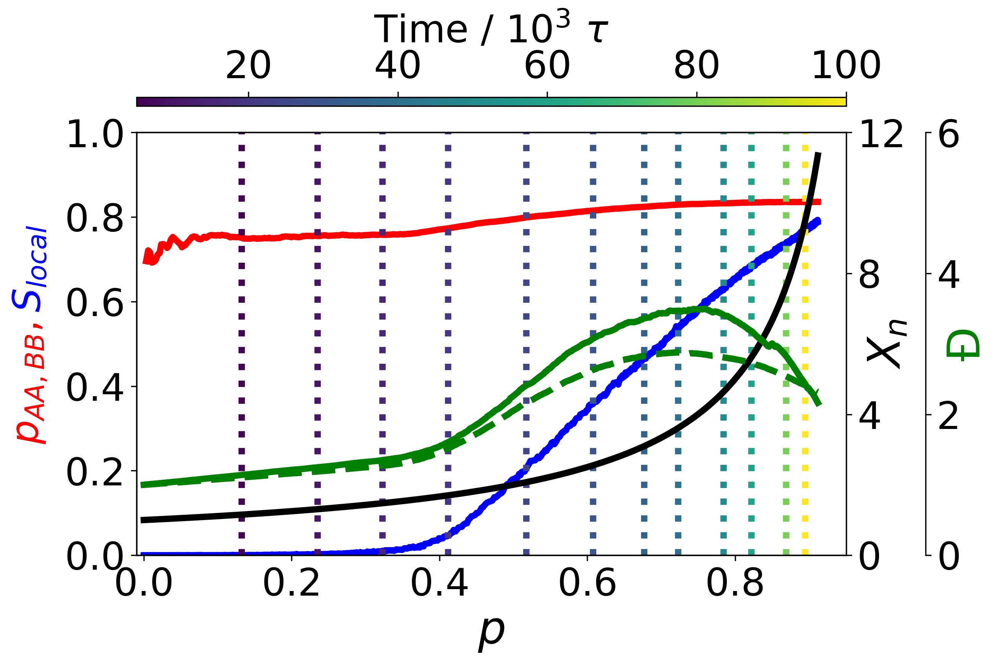

In [49]:
#Stiff standard
simid = 0
sim = sims[simid]

lw=4.

fig, host = plt.subplots(1,1,figsize=(8,8*(3/4)))
#fig.suptitle('Standard - Stiff',fontsize=BIGGER_SIZE)
#fig.suptitle('$\epsilon_{AA} = 0.5 k_BT$, $\epsilon_{AB} = 0.2 k_BT$,  $\epsilon_{BB} = 0.1 k_BT$',fontsize=20)

par1 = host.twinx()
par2 = host.twinx()


host.set_xlim((-0.01, 0.95))
host.set_ylim(0, 1)
par1.set_ylim(0, 12)
#par2.set_ylim(0, 8)
par2.set_ylim(0, 6)

host.set_xlabel(r"$p$")
par1.set_ylabel(r"$X_n$",labelpad=-25)
par2.set_ylabel(u'\u0110',labelpad=-10)



# y-axis label
ybox1 = TextArea("$p_{AA,BB}$,", textprops=dict(color="r", size=MEDIUM_SIZE ,rotation='vertical',ha='left',va='bottom'))
#ybox2 = TextArea("Oligomer-Oligomer Bonding,", textprops=dict(color="orange", size=MEDIUM_SIZE-2,rotation='vertical',ha='left',va='bottom'))
ybox3 = TextArea("$S_{local}$", textprops=dict(color="b", size=MEDIUM_SIZE,rotation='vertical',ha='left',va='bottom'))
#ybox = VPacker(children= [ybox3, ybox2, ybox1], align="center", pad=0, sep=8)
ybox = VPacker(children= [ybox3, ybox1], align="center", pad=0, sep=8)


anchored_ybox = AnchoredOffsetbox(loc='center', child=ybox, pad=0., frameon=False,bbox_to_anchor=(-0.15, 0.5),bbox_transform=host.transAxes, borderpad=1.)



#sim index:
#    0         1          2         3         4            5          6          7                 8           9      10     11       12    13          14
#[extent_avg,order_avg,tstep_avg,probs_avg,blockAtotal,blockBtotal,chaindist,BlockA_PDI_avg,BlockB_PDI_avg,PDI_avg,pA_avg,pB_avg,seqs_all,Xn_avg,TotalBlock_PDI_avg]
# probs_avg index
#[pAA_avg,pAB_avg,pBB_avg]


p1, = host.plot(sim[0], (sim[3][0]+sim[3][2]), label="pAA,BB", color='r', linewidth=lw)
p2, = host.plot(sim[0], sim[1], label="$S_{local}$", color = 'b', linewidth=lw)
#p_extra, = host.plot(sim[0],rxn_plot[simid][8],color='orange',label='Oligomer-Oligomer Bonding, ', linewidth=lw)
p3, = par1.plot(sim[0],sim[13] , label=r"X_n", color='k', linewidth=lw) 
p4, = par2.plot(sim[0], sim[9], label=u"\u0110", color='g', linewidth=lw)
p5, = par2.plot(sim[0],((sim[7]+sim[8])/2), label=u"Block \u0110", color='g', linestyle='dashed', linewidth=lw)
#lns = [p1, p2, p_extra, p3, p4, p5]
lns = [p1, p2, p3, p4, p5]



for i,val in enumerate(snap_steps_id):
    #host.plot([sim[0][val],sim[0][val]],[0,1],color=snap_steps_cmap(color_ids_snap_steps[i]),linewidth=lw,linestyle=(0, (1, 10)))
    host.plot([sim[0][val],sim[0][val]],[0,1],color=snap_steps_cmap(color_ids_snap_steps[i]),linewidth=lw,linestyle=':')


# right, left, top, bottom
par2.spines['right'].set_position(('outward', 50))

host.add_artist(anchored_ybox)
par1.yaxis.label.set_color(p3.get_color())
par2.yaxis.label.set_color(p4.get_color())
par1.set_yticks([0,4,8,12])
#host.legend(handles=lns, loc='best');

#colorbar
cbar = fig.colorbar(snap_steps_sm,ax=host,location='top',aspect=80,pad=0.05)#,label=r'$\frac{\tau_D}{\tau_R}$');
#cbar.formatter.set_powerlimits((0, 0))
cbar.set_label(label=r"Time / $10^3 \ \tau$",size=MEDIUM_SIZE)
cbar.ax.tick_params(labelsize=MEDIUM_SIZE)
cbar.ax.yaxis.offsetText.set_fontsize(MEDIUM_SIZE)
cbar.ax.xaxis.offsetText.set_fontsize(MEDIUM_SIZE)
#cbar.ax.set_yticklabels('')

fig.savefig('copoly3_ZZrecreated_kinetics_extent.png',transparent=True,bbox_inches='tight',dpi=300)
        
plt.show()

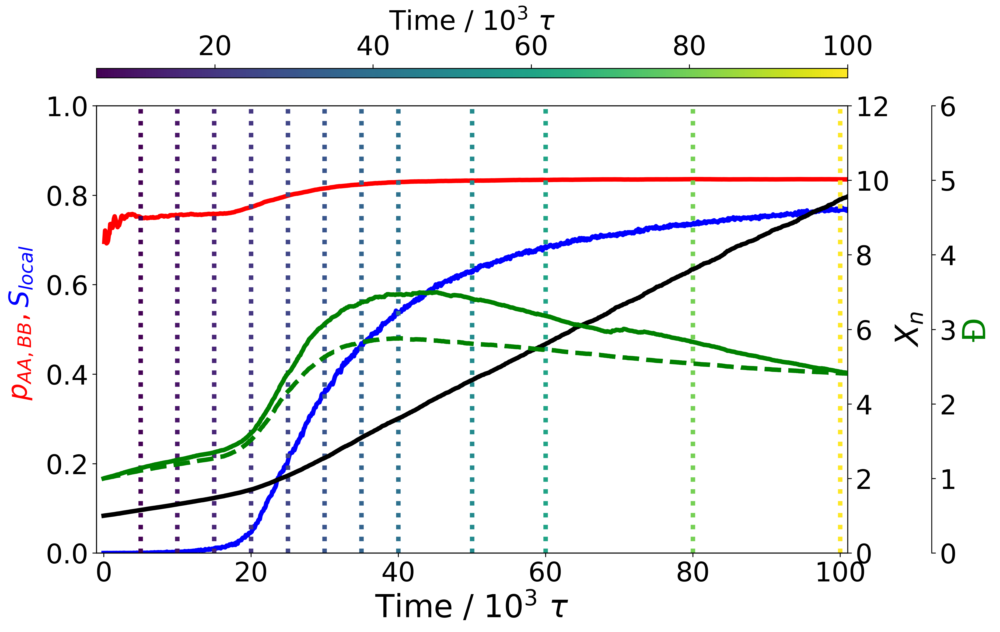

In [50]:
#Stiff standard
simid = 0
sim = sims[simid]



fig, host = plt.subplots(1,1,figsize=(12,9))
#fig.suptitle('Standard - Stiff',fontsize=BIGGER_SIZE)
#fig.suptitle('$\epsilon_{AA} = 0.5 k_BT$, $\epsilon_{AB} = 0.2 k_BT$,  $\epsilon_{BB} = 0.1 k_BT$',fontsize=20)

par1 = host.twinx()
par2 = host.twinx()


host.set_xlim(-1, 101)
host.set_ylim(0, 1)
par1.set_ylim(0, 12)
#par2.set_ylim(0, 8)
par2.set_ylim(0, 6)

host.set_xlabel(r"Time / $10^3 \ \tau$")
par1.set_ylabel(r"$X_n$")
par2.set_ylabel(u'\u0110')



# y-axis label
ybox1 = TextArea("$p_{AA,BB}$,", textprops=dict(color="r", size=MEDIUM_SIZE ,rotation='vertical',ha='left',va='bottom'))
#ybox2 = TextArea("Oligomer-Oligomer Bonding,", textprops=dict(color="orange", size=MEDIUM_SIZE-2,rotation='vertical',ha='left',va='bottom'))
ybox3 = TextArea("$S_{local}$", textprops=dict(color="b", size=MEDIUM_SIZE,rotation='vertical',ha='left',va='bottom'))
#ybox = VPacker(children= [ybox3, ybox2, ybox1], align="center", pad=0, sep=8)
ybox = VPacker(children= [ybox3, ybox1], align="center", pad=0, sep=8)


anchored_ybox = AnchoredOffsetbox(loc='center', child=ybox, pad=0., frameon=False,bbox_to_anchor=(-0.1, 0.5),bbox_transform=host.transAxes, borderpad=1.)



#sim index:
#    0         1          2         3         4            5          6          7                 8           9      10     11       12    13          14
#[extent_avg,order_avg,tstep_avg,probs_avg,blockAtotal,blockBtotal,chaindist,BlockA_PDI_avg,BlockB_PDI_avg,PDI_avg,pA_avg,pB_avg,seqs_all,Xn_avg,TotalBlock_PDI_avg]
# probs_avg index
#[pAA_avg,pAB_avg,pBB_avg]


p1, = host.plot(10**(-6)*sim[2], (sim[3][0]+sim[3][2]), label="pAA,BB", color='r', linewidth=lw)
p2, = host.plot(10**(-6)*sim[2], sim[1], label="$S_{local}$", color = 'b', linewidth=lw)
#p_extra, = host.plot(10**(-6)*sim[2],rxn_plot[simid][8],color='orange',label='Oligomer-Oligomer Bonding, ', linewidth=lw)
p3, = par1.plot(10**(-6)*sim[2],sim[13] , label=r"X_n", color='k', linewidth=lw) 
p4, = par2.plot(10**(-6)*sim[2], sim[9], label=u"\u0110", color='g', linewidth=lw)
p5, = par2.plot(10**(-6)*sim[2],((sim[7]+sim[8])/2), label=u"Block \u0110", color='g', linestyle='dashed', linewidth=lw)
#lns = [p1, p2, p_extra, p3, p4, p5]
lns = [p1, p2, p3, p4, p5]



for i,val in enumerate(snap_steps_id):
    host.plot([10**(-6)*sim[2][val],10**(-6)*sim[2][val]],[0,1],color=snap_steps_cmap(color_ids_snap_steps[i]),linewidth=lw,linestyle=':')


# right, left, top, bottom
par2.spines['right'].set_position(('outward', 75))

host.add_artist(anchored_ybox)
par1.yaxis.label.set_color(p3.get_color())
par2.yaxis.label.set_color(p4.get_color())
#host.legend(handles=lns, loc='best');

#colorbar
cbar = fig.colorbar(snap_steps_sm,ax=host,location='top',aspect=80,pad=0.05)#,label=r'$\frac{\tau_D}{\tau_R}$');
#cbar.formatter.set_powerlimits((0, 0))
cbar.set_label(label=r"Time / $10^3 \ \tau$",size=MEDIUM_SIZE)
cbar.ax.tick_params(labelsize=MEDIUM_SIZE)
cbar.ax.yaxis.offsetText.set_fontsize(MEDIUM_SIZE)
cbar.ax.xaxis.offsetText.set_fontsize(MEDIUM_SIZE)
#cbar.ax.set_yticklabels('')

#fig.savefig('220725_standard_kinetics',transparent=True,bbox_inches='tight',dpi=300)
        
plt.show()

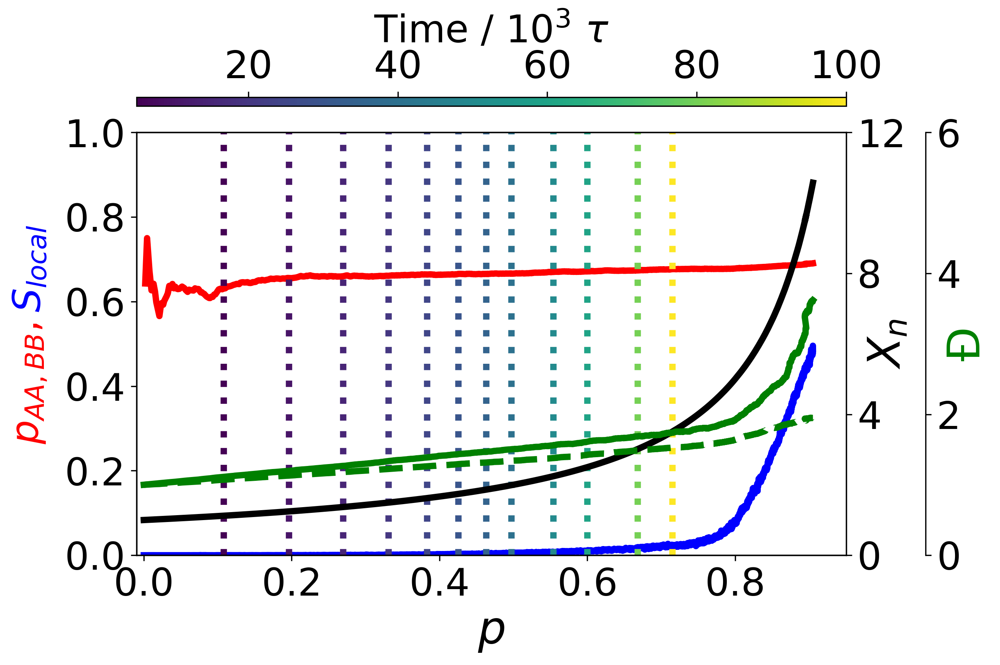

In [51]:
#Stiff weakest epsilon
simid = 16
sim = sims[simid]

lw=4.

fig, host = plt.subplots(1,1,figsize=(8,8*(3/4)))
#fig.suptitle('Standard - Stiff',fontsize=BIGGER_SIZE)
#fig.suptitle('$\epsilon_{AA} = 0.5 k_BT$, $\epsilon_{AB} = 0.2 k_BT$,  $\epsilon_{BB} = 0.1 k_BT$',fontsize=20)

par1 = host.twinx()
par2 = host.twinx()


host.set_xlim((-0.01, 0.95))
host.set_ylim(0, 1)
par1.set_ylim(0, 12)
#par2.set_ylim(0, 8)
par2.set_ylim(0, 6)

host.set_xlabel(r"$p$")
par1.set_ylabel(r"$X_n$",labelpad=-25)
par2.set_ylabel(u'\u0110',labelpad=-10)



# y-axis label
ybox1 = TextArea("$p_{AA,BB}$,", textprops=dict(color="r", size=MEDIUM_SIZE ,rotation='vertical',ha='left',va='bottom'))
#ybox2 = TextArea("Oligomer-Oligomer Bonding,", textprops=dict(color="orange", size=MEDIUM_SIZE-2,rotation='vertical',ha='left',va='bottom'))
ybox3 = TextArea("$S_{local}$", textprops=dict(color="b", size=MEDIUM_SIZE,rotation='vertical',ha='left',va='bottom'))
#ybox = VPacker(children= [ybox3, ybox2, ybox1], align="center", pad=0, sep=8)
ybox = VPacker(children= [ybox3, ybox1], align="center", pad=0, sep=8)


anchored_ybox = AnchoredOffsetbox(loc='center', child=ybox, pad=0., frameon=False,bbox_to_anchor=(-0.15, 0.5),bbox_transform=host.transAxes, borderpad=1.)



#sim index:
#    0         1          2         3         4            5          6          7                 8           9      10     11       12    13          14
#[extent_avg,order_avg,tstep_avg,probs_avg,blockAtotal,blockBtotal,chaindist,BlockA_PDI_avg,BlockB_PDI_avg,PDI_avg,pA_avg,pB_avg,seqs_all,Xn_avg,TotalBlock_PDI_avg]
# probs_avg index
#[pAA_avg,pAB_avg,pBB_avg]


p1, = host.plot(sim[0], (sim[3][0]+sim[3][2]), label="pAA,BB", color='r', linewidth=lw)
p2, = host.plot(sim[0], sim[1], label="$S_{local}$", color = 'b', linewidth=lw)
#p_extra, = host.plot(sim[0],rxn_plot[simid][8],color='orange',label='Oligomer-Oligomer Bonding, ', linewidth=lw)
p3, = par1.plot(sim[0],sim[13] , label=r"X_n", color='k', linewidth=lw) 
p4, = par2.plot(sim[0], sim[9], label=u"\u0110", color='g', linewidth=lw)
p5, = par2.plot(sim[0],((sim[7]+sim[8])/2), label=u"Block \u0110", color='g', linestyle='dashed', linewidth=lw)
#lns = [p1, p2, p_extra, p3, p4, p5]
lns = [p1, p2, p3, p4, p5]



for i,val in enumerate(snap_steps_id):
    #host.plot([sim[0][val],sim[0][val]],[0,1],color=snap_steps_cmap(color_ids_snap_steps[i]),linewidth=lw,linestyle=(0, (1, 10)))
    host.plot([sim[0][val],sim[0][val]],[0,1],color=snap_steps_cmap(color_ids_snap_steps[i]),linewidth=lw,linestyle=':')


# right, left, top, bottom
par2.spines['right'].set_position(('outward', 50))

host.add_artist(anchored_ybox)
par1.yaxis.label.set_color(p3.get_color())
par2.yaxis.label.set_color(p4.get_color())
par1.set_yticks([0,4,8,12])
#host.legend(handles=lns, loc='best');

#colorbar
cbar = fig.colorbar(snap_steps_sm,ax=host,location='top',aspect=80,pad=0.05)#,label=r'$\frac{\tau_D}{\tau_R}$');
#cbar.formatter.set_powerlimits((0, 0))
cbar.set_label(label=r"Time / $10^3 \ \tau$",size=MEDIUM_SIZE)
cbar.ax.tick_params(labelsize=MEDIUM_SIZE)
cbar.ax.yaxis.offsetText.set_fontsize(MEDIUM_SIZE)
cbar.ax.xaxis.offsetText.set_fontsize(MEDIUM_SIZE)
#cbar.ax.set_yticklabels('')

fig.savefig('230621_Flory_principle_check_extent.png',transparent=True,bbox_inches='tight',dpi=300)
        
plt.show()

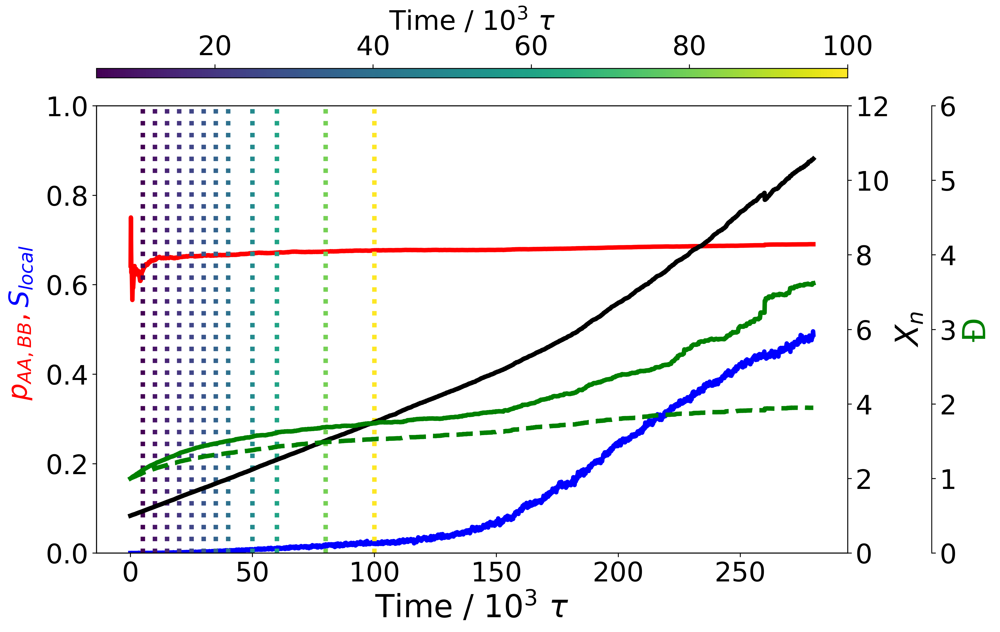

In [52]:
#Stiff weakest epsilon
simid = 16
sim = sims[simid]



fig, host = plt.subplots(1,1,figsize=(12,9))
#fig.suptitle('Standard - Stiff',fontsize=BIGGER_SIZE)
#fig.suptitle('$\epsilon_{AA} = 0.5 k_BT$, $\epsilon_{AB} = 0.2 k_BT$,  $\epsilon_{BB} = 0.1 k_BT$',fontsize=20)

par1 = host.twinx()
par2 = host.twinx()


#host.set_xlim(-1, 101)
host.set_ylim(0, 1)
par1.set_ylim(0, 12)
#par2.set_ylim(0, 8)
par2.set_ylim(0, 6)

host.set_xlabel(r"Time / $10^3 \ \tau$")
par1.set_ylabel(r"$X_n$")
par2.set_ylabel(u'\u0110')



# y-axis label
ybox1 = TextArea("$p_{AA,BB}$,", textprops=dict(color="r", size=MEDIUM_SIZE ,rotation='vertical',ha='left',va='bottom'))
#ybox2 = TextArea("Oligomer-Oligomer Bonding,", textprops=dict(color="orange", size=MEDIUM_SIZE-2,rotation='vertical',ha='left',va='bottom'))
ybox3 = TextArea("$S_{local}$", textprops=dict(color="b", size=MEDIUM_SIZE,rotation='vertical',ha='left',va='bottom'))
#ybox = VPacker(children= [ybox3, ybox2, ybox1], align="center", pad=0, sep=8)
ybox = VPacker(children= [ybox3, ybox1], align="center", pad=0, sep=8)


anchored_ybox = AnchoredOffsetbox(loc='center', child=ybox, pad=0., frameon=False,bbox_to_anchor=(-0.1, 0.5),bbox_transform=host.transAxes, borderpad=1.)



#sim index:
#    0         1          2         3         4            5          6          7                 8           9      10     11       12    13          14
#[extent_avg,order_avg,tstep_avg,probs_avg,blockAtotal,blockBtotal,chaindist,BlockA_PDI_avg,BlockB_PDI_avg,PDI_avg,pA_avg,pB_avg,seqs_all,Xn_avg,TotalBlock_PDI_avg]
# probs_avg index
#[pAA_avg,pAB_avg,pBB_avg]


p1, = host.plot(10**(-6)*sim[2], (sim[3][0]+sim[3][2]), label="pAA,BB", color='r', linewidth=lw)
p2, = host.plot(10**(-6)*sim[2], sim[1], label="$S_{local}$", color = 'b', linewidth=lw)
#p_extra, = host.plot(10**(-6)*sim[2],rxn_plot[simid][8],color='orange',label='Oligomer-Oligomer Bonding, ', linewidth=lw)
p3, = par1.plot(10**(-6)*sim[2],sim[13] , label=r"X_n", color='k', linewidth=lw) 
p4, = par2.plot(10**(-6)*sim[2], sim[9], label=u"\u0110", color='g', linewidth=lw)
p5, = par2.plot(10**(-6)*sim[2],((sim[7]+sim[8])/2), label=u"Block \u0110", color='g', linestyle='dashed', linewidth=lw)
#lns = [p1, p2, p_extra, p3, p4, p5]
lns = [p1, p2, p3, p4, p5]



for i,val in enumerate(snap_steps_id):
    host.plot([10**(-6)*sim[2][val],10**(-6)*sim[2][val]],[0,1],color=snap_steps_cmap(color_ids_snap_steps[i]),linewidth=lw,linestyle=':')


# right, left, top, bottom
par2.spines['right'].set_position(('outward', 75))

host.add_artist(anchored_ybox)
par1.yaxis.label.set_color(p3.get_color())
par2.yaxis.label.set_color(p4.get_color())
#host.legend(handles=lns, loc='best');

#colorbar
cbar = fig.colorbar(snap_steps_sm,ax=host,location='top',aspect=80,pad=0.05)#,label=r'$\frac{\tau_D}{\tau_R}$');
#cbar.formatter.set_powerlimits((0, 0))
cbar.set_label(label=r"Time / $10^3 \ \tau$",size=MEDIUM_SIZE)
cbar.ax.tick_params(labelsize=MEDIUM_SIZE)
cbar.ax.yaxis.offsetText.set_fontsize(MEDIUM_SIZE)
cbar.ax.xaxis.offsetText.set_fontsize(MEDIUM_SIZE)
#cbar.ax.set_yticklabels('')

fig.savefig('230621_Flory_principle_check_time',transparent=True,bbox_inches='tight',dpi=300)
        
plt.show()

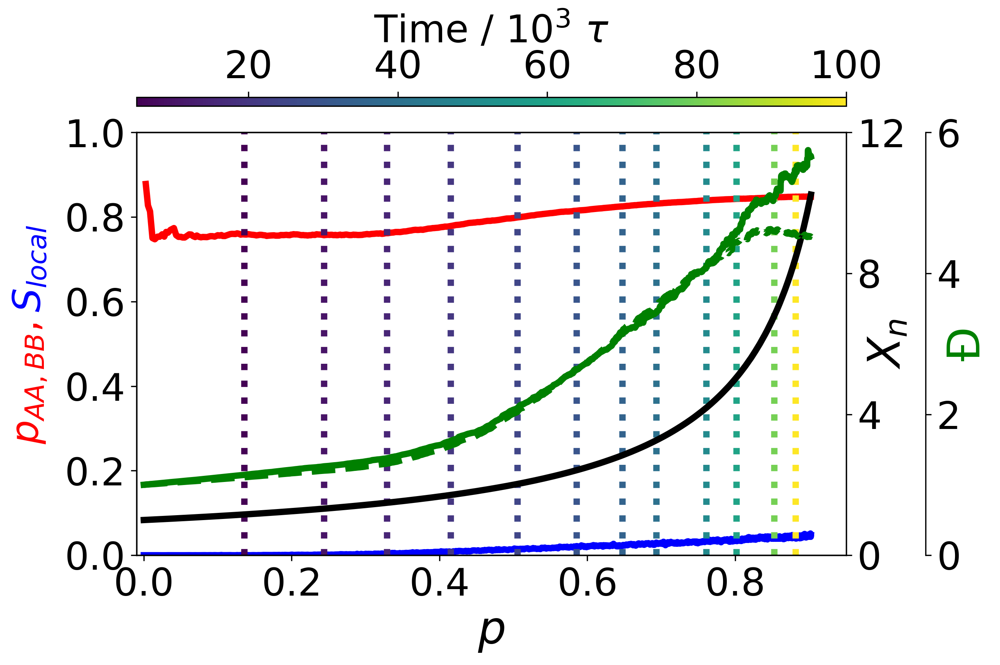

In [53]:
#Flex standard
simid = 19
sim = sims[simid]

lw=4.

fig, host = plt.subplots(1,1,figsize=(8,8*(3/4)))
#fig.suptitle('Standard - Stiff',fontsize=BIGGER_SIZE)
#fig.suptitle('$\epsilon_{AA} = 0.5 k_BT$, $\epsilon_{AB} = 0.2 k_BT$,  $\epsilon_{BB} = 0.1 k_BT$',fontsize=20)

par1 = host.twinx()
par2 = host.twinx()


host.set_xlim((-0.01, 0.95))
host.set_ylim(0, 1)
host.set_yticks([0.0,0.2,0.4,0.6,0.8,1.0])
par1.set_ylim(0, 12)
#par2.set_ylim(0, 8)
par2.set_ylim(0, 6)

host.set_xlabel(r"$p$")
par1.set_ylabel(r"$X_n$",labelpad=-25)
par2.set_ylabel(u'\u0110',labelpad=-10)



# y-axis label
ybox1 = TextArea("$p_{AA,BB}$,", textprops=dict(color="r", size=MEDIUM_SIZE ,rotation='vertical',ha='left',va='bottom'))
#ybox2 = TextArea("Oligomer-Oligomer Bonding,", textprops=dict(color="orange", size=MEDIUM_SIZE-2,rotation='vertical',ha='left',va='bottom'))
ybox3 = TextArea("$S_{local}$", textprops=dict(color="b", size=MEDIUM_SIZE,rotation='vertical',ha='left',va='bottom'))
#ybox = VPacker(children= [ybox3, ybox2, ybox1], align="center", pad=0, sep=8)
ybox = VPacker(children= [ybox3, ybox1], align="center", pad=0, sep=8)


anchored_ybox = AnchoredOffsetbox(loc='center', child=ybox, pad=0., frameon=False,bbox_to_anchor=(-0.15, 0.5),bbox_transform=host.transAxes, borderpad=1.)



#sim index:
#    0         1          2         3         4            5          6          7                 8           9      10     11       12    13          14
#[extent_avg,order_avg,tstep_avg,probs_avg,blockAtotal,blockBtotal,chaindist,BlockA_PDI_avg,BlockB_PDI_avg,PDI_avg,pA_avg,pB_avg,seqs_all,Xn_avg,TotalBlock_PDI_avg]
# probs_avg index
#[pAA_avg,pAB_avg,pBB_avg]


p1, = host.plot(sim[0], (sim[3][0]+sim[3][2]), label="pAA,BB", color='r', linewidth=lw)
p2, = host.plot(sim[0], sim[1], label="$S_{local}$", color = 'b', linewidth=lw)
#p_extra, = host.plot(sim[0],rxn_plot[simid][8],color='orange',label='Oligomer-Oligomer Bonding, ', linewidth=lw)
p3, = par1.plot(sim[0],sim[13] , label=r"X_n", color='k', linewidth=lw) 
p4, = par2.plot(sim[0], sim[9], label=u"\u0110", color='g', linewidth=lw)
p5, = par2.plot(sim[0],((sim[7]+sim[8])/2), label=u"Block \u0110", color='g', linestyle='dashed', linewidth=lw)
#lns = [p1, p2, p_extra, p3, p4, p5]
lns = [p1, p2, p3, p4, p5]



for i,val in enumerate(snap_steps_id):
    #host.plot([sim[0][val],sim[0][val]],[0,1],color=snap_steps_cmap(color_ids_snap_steps[i]),linewidth=lw,linestyle=(0, (1, 10)))
    host.plot([sim[0][val],sim[0][val]],[0,1],color=snap_steps_cmap(color_ids_snap_steps[i]),linewidth=lw,linestyle=':')


# right, left, top, bottom
par2.spines['right'].set_position(('outward', 50))

host.add_artist(anchored_ybox)
par1.yaxis.label.set_color(p3.get_color())
par2.yaxis.label.set_color(p4.get_color())
par1.set_yticks([0,4,8,12])
#host.legend(handles=lns, loc='best');

#colorbar
cbar = fig.colorbar(snap_steps_sm,ax=host,location='top',aspect=80,pad=0.05)#,label=r'$\frac{\tau_D}{\tau_R}$');
#cbar.formatter.set_powerlimits((0, 0))
cbar.set_label(label=r"Time / $10^3 \ \tau$",size=MEDIUM_SIZE)
cbar.ax.tick_params(labelsize=MEDIUM_SIZE)
cbar.ax.yaxis.offsetText.set_fontsize(MEDIUM_SIZE)
cbar.ax.xaxis.offsetText.set_fontsize(MEDIUM_SIZE)
#cbar.ax.set_yticklabels('')

fig.savefig('copoly3_ZZrecreated_kinetics_extent_flex.png',transparent=True,bbox_inches='tight',dpi=300)
        
plt.show()

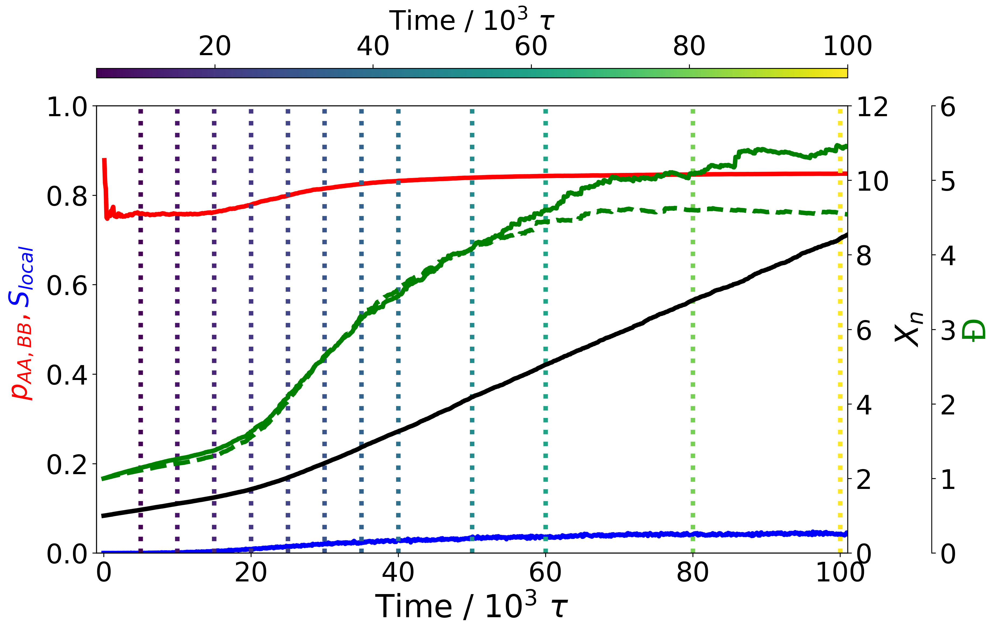

In [54]:
#Flex standard
simid = 19
sim = sims[simid]



fig, host = plt.subplots(1,1,figsize=(12,9))
#fig.suptitle('Standard - Stiff',fontsize=BIGGER_SIZE)
#fig.suptitle('$\epsilon_{AA} = 0.5 k_BT$, $\epsilon_{AB} = 0.2 k_BT$,  $\epsilon_{BB} = 0.1 k_BT$',fontsize=20)

par1 = host.twinx()
par2 = host.twinx()


host.set_xlim(-1, 101)
host.set_ylim(0, 1)
par1.set_ylim(0, 12)
#par2.set_ylim(0, 8)
par2.set_ylim(0, 6)

host.set_xlabel(r"Time / $10^3 \ \tau$")
par1.set_ylabel(r"$X_n$")
par2.set_ylabel(u'\u0110')



# y-axis label
ybox1 = TextArea("$p_{AA,BB}$,", textprops=dict(color="r", size=MEDIUM_SIZE ,rotation='vertical',ha='left',va='bottom'))
#ybox2 = TextArea("Oligomer-Oligomer Bonding,", textprops=dict(color="orange", size=MEDIUM_SIZE-2,rotation='vertical',ha='left',va='bottom'))
ybox3 = TextArea("$S_{local}$", textprops=dict(color="b", size=MEDIUM_SIZE,rotation='vertical',ha='left',va='bottom'))
#ybox = VPacker(children= [ybox3, ybox2, ybox1], align="center", pad=0, sep=8)
ybox = VPacker(children= [ybox3, ybox1], align="center", pad=0, sep=8)


anchored_ybox = AnchoredOffsetbox(loc='center', child=ybox, pad=0., frameon=False,bbox_to_anchor=(-0.1, 0.5),bbox_transform=host.transAxes, borderpad=1.)



#sim index:
#    0         1          2         3         4            5          6          7                 8           9      10     11       12    13          14
#[extent_avg,order_avg,tstep_avg,probs_avg,blockAtotal,blockBtotal,chaindist,BlockA_PDI_avg,BlockB_PDI_avg,PDI_avg,pA_avg,pB_avg,seqs_all,Xn_avg,TotalBlock_PDI_avg]
# probs_avg index
#[pAA_avg,pAB_avg,pBB_avg]


p1, = host.plot(10**(-6)*sim[2], (sim[3][0]+sim[3][2]), label="pAA,BB", color='r', linewidth=lw)
p2, = host.plot(10**(-6)*sim[2], sim[1], label="$S_{local}$", color = 'b', linewidth=lw)
#p_extra, = host.plot(10**(-6)*sim[2],rxn_plot[simid][8],color='orange',label='Oligomer-Oligomer Bonding, ', linewidth=lw)
p3, = par1.plot(10**(-6)*sim[2],sim[13] , label=r"X_n", color='k', linewidth=lw) 
p4, = par2.plot(10**(-6)*sim[2], sim[9], label=u"\u0110", color='g', linewidth=lw)
p5, = par2.plot(10**(-6)*sim[2],((sim[7]+sim[8])/2), label=u"Block \u0110", color='g', linestyle='dashed', linewidth=lw)
#lns = [p1, p2, p_extra, p3, p4, p5]
lns = [p1, p2, p3, p4, p5]



for i,val in enumerate(snap_steps_id):
    host.plot([10**(-6)*sim[2][val],10**(-6)*sim[2][val]],[0,1],color=snap_steps_cmap(color_ids_snap_steps[i]),linewidth=lw,linestyle=':')


# right, left, top, bottom
par2.spines['right'].set_position(('outward', 75))

host.add_artist(anchored_ybox)
par1.yaxis.label.set_color(p3.get_color())
par2.yaxis.label.set_color(p4.get_color())
#host.legend(handles=lns, loc='best');

#colorbar
cbar = fig.colorbar(snap_steps_sm,ax=host,location='top',aspect=80,pad=0.05)#,label=r'$\frac{\tau_D}{\tau_R}$');
#cbar.formatter.set_powerlimits((0, 0))
cbar.set_label(label=r"Time / $10^3 \ \tau$",size=MEDIUM_SIZE)
cbar.ax.tick_params(labelsize=MEDIUM_SIZE)
cbar.ax.yaxis.offsetText.set_fontsize(MEDIUM_SIZE)
cbar.ax.xaxis.offsetText.set_fontsize(MEDIUM_SIZE)
#cbar.ax.set_yticklabels('')

#fig.savefig('copoly3_ZZrecreated_kinetics_time_flex.png',transparent=True,bbox_inches='tight',dpi=300)
        
plt.show()

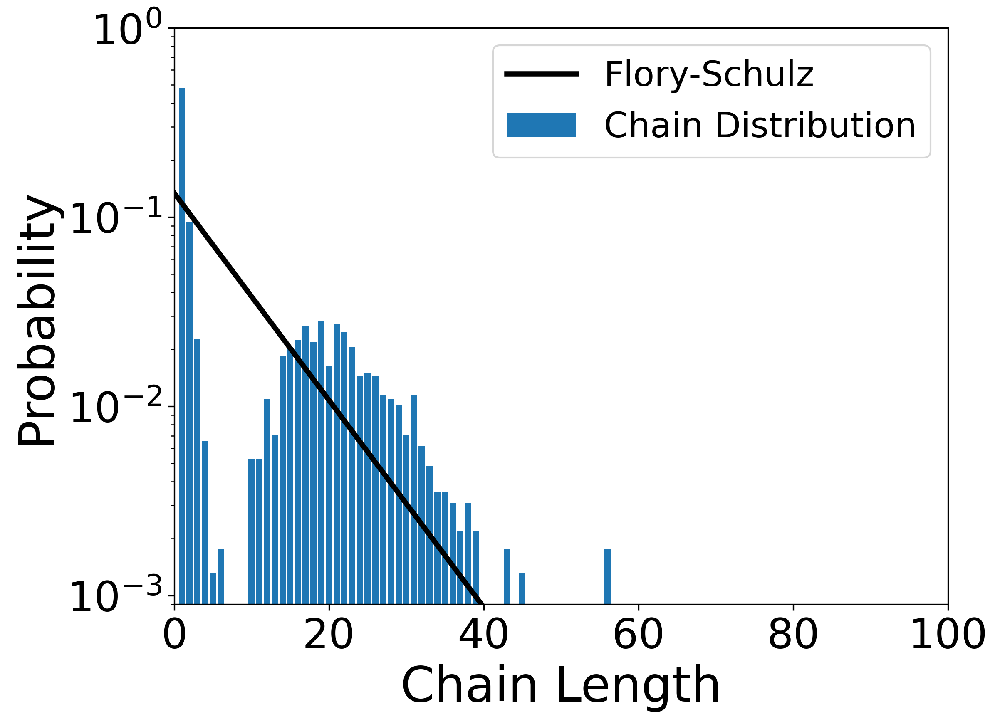

In [57]:


SMALL_SIZE = 20
MEDIUM_SIZE = 24
BIGGER_SIZE = 28

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=BIGGER_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
matplotlib.rcParams['figure.dpi'] = 300

lw = 3.
snap_num=-1


x_chain_FS = np.linspace(0,50,51)
fig,ax = plt.subplots(1,1,figsize=(8,6))
#ax.plot(x_chain_FS, ((1-p[-1])*p[-1]**(x_chain_FS-1)),'-k',linewidth=lw)
ax.plot(x_chain_FS, ((1-p[snap_steps_id[snap_num]])*p[snap_steps_id[snap_num]]**(x_chain_FS-1)),'-k',linewidth=lw)
ax.bar(x_chain,snap_steps_chaindist[snap_num][1:]/np.sum(snap_steps_chaindist[snap_num][1:]),align='center')
#ax.bar(x_chain,ChainDistS/np.sum(ChainDistS),align='center')
ax.set_xlabel('Chain Length')
ax.set_ylabel('Probability')
#ax.set_xlim((0,60))
ax.set_xlim((0,100))
ax.set_yscale('log')
ax.set_ylim((9e-4,1))
#ax.text(30,0.2,label)
ax.legend(('Flory-Schulz','Chain Distribution'));
fig.savefig('copoly3_standard_chain.png',dpi=300, bbox_inches='tight')


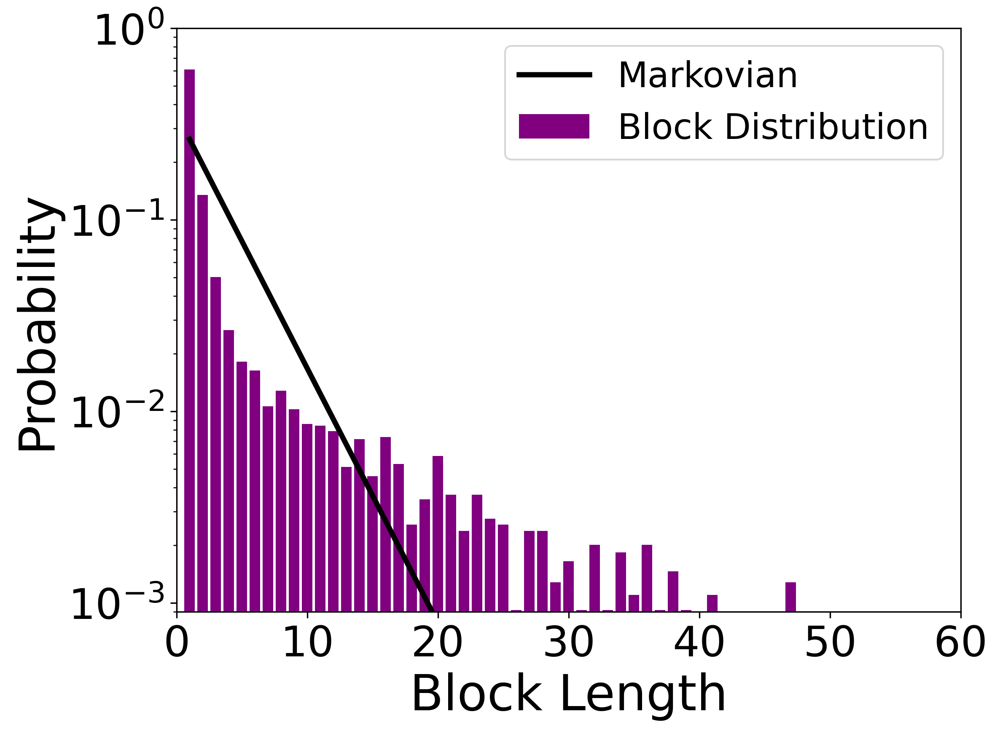

In [58]:


SMALL_SIZE = 20
MEDIUM_SIZE = 24
BIGGER_SIZE = 28

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=BIGGER_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
matplotlib.rcParams['figure.dpi'] = 300

lw = 3.

snap_num = -1


fig,ax = plt.subplots(1,1,figsize=(8,6))
ax.plot(n_block, ((1-(p[snap_steps_id[snap_num]]*(sims[0][3][0][snap_steps_id[snap_num]]+sims[0][3][2][snap_steps_id[snap_num]])))*(p[snap_steps_id[snap_num]]*(sims[0][3][0][snap_steps_id[snap_num]]+sims[0][3][2][snap_steps_id[snap_num]]))**(n_block-1)),'-k',linewidth=lw)
ax.bar(n_block,snap_steps_blockdist_flex[snap_num][1:]/np.sum(snap_steps_blockdist_flex[snap_num][1:]),align='center',color='purple')
ax.set_xlabel('Block Length')
ax.set_ylabel('Probability')
ax.set_xlim((0,60))
ax.set_yscale('log')
ax.set_ylim((9e-4,1))
#ax.text(30,0.2,label)
ax.legend(('Markovian','Block Distribution'));
#fig.savefig('copoly3_5e3tau_block-Markovian.png',dpi=300, bbox_inches='tight')


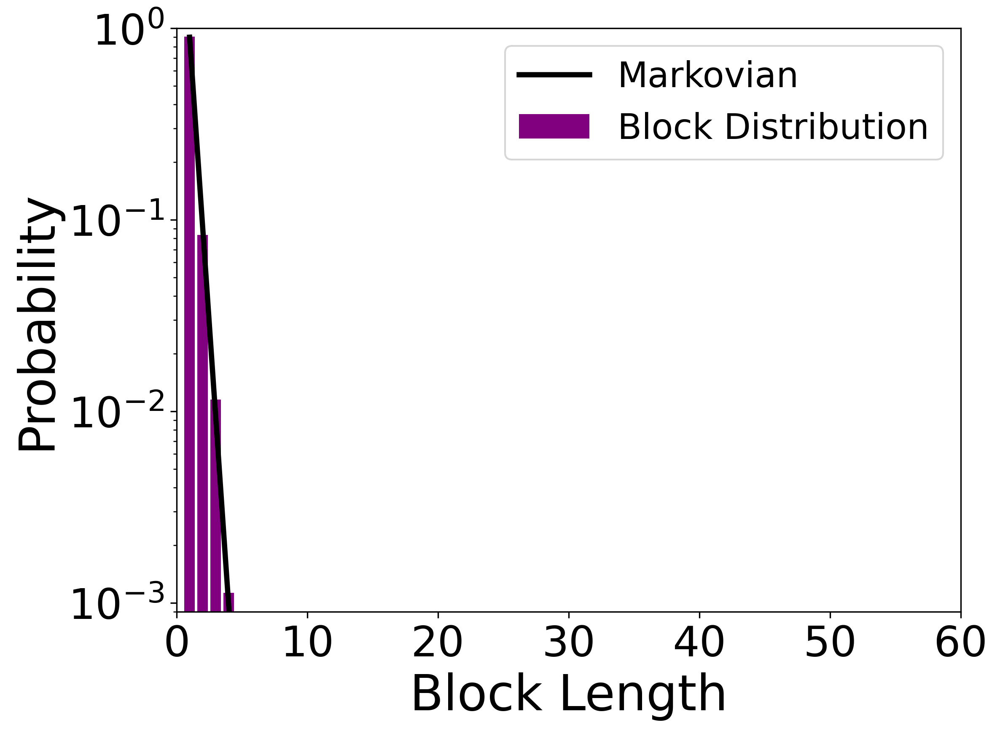

In [59]:


SMALL_SIZE = 20
MEDIUM_SIZE = 24
BIGGER_SIZE = 28

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=BIGGER_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
matplotlib.rcParams['figure.dpi'] = 300

lw = 3.

snap_num = 0


fig,ax = plt.subplots(1,1,figsize=(8,6))
ax.plot(n_block, ((1-(p[snap_steps_id[snap_num]]*(sims[0][3][0][snap_steps_id[snap_num]]+sims[0][3][2][snap_steps_id[snap_num]])))*(p[snap_steps_id[snap_num]]*(sims[0][3][0][snap_steps_id[snap_num]]+sims[0][3][2][snap_steps_id[snap_num]]))**(n_block-1)),'-k',linewidth=lw)
ax.bar(n_block,snap_steps_blockdist[snap_num][1:]/np.sum(snap_steps_blockdist[snap_num][1:]),align='center',color='purple')
ax.set_xlabel('Block Length')
ax.set_ylabel('Probability')
ax.set_xlim((0,60))
ax.set_yscale('log')
ax.set_ylim((9e-4,1))
#ax.text(30,0.2,label)
ax.legend(('Markovian','Block Distribution'));
fig.savefig('copoly3_5e3tau_block-Markovian.png',dpi=300, bbox_inches='tight')


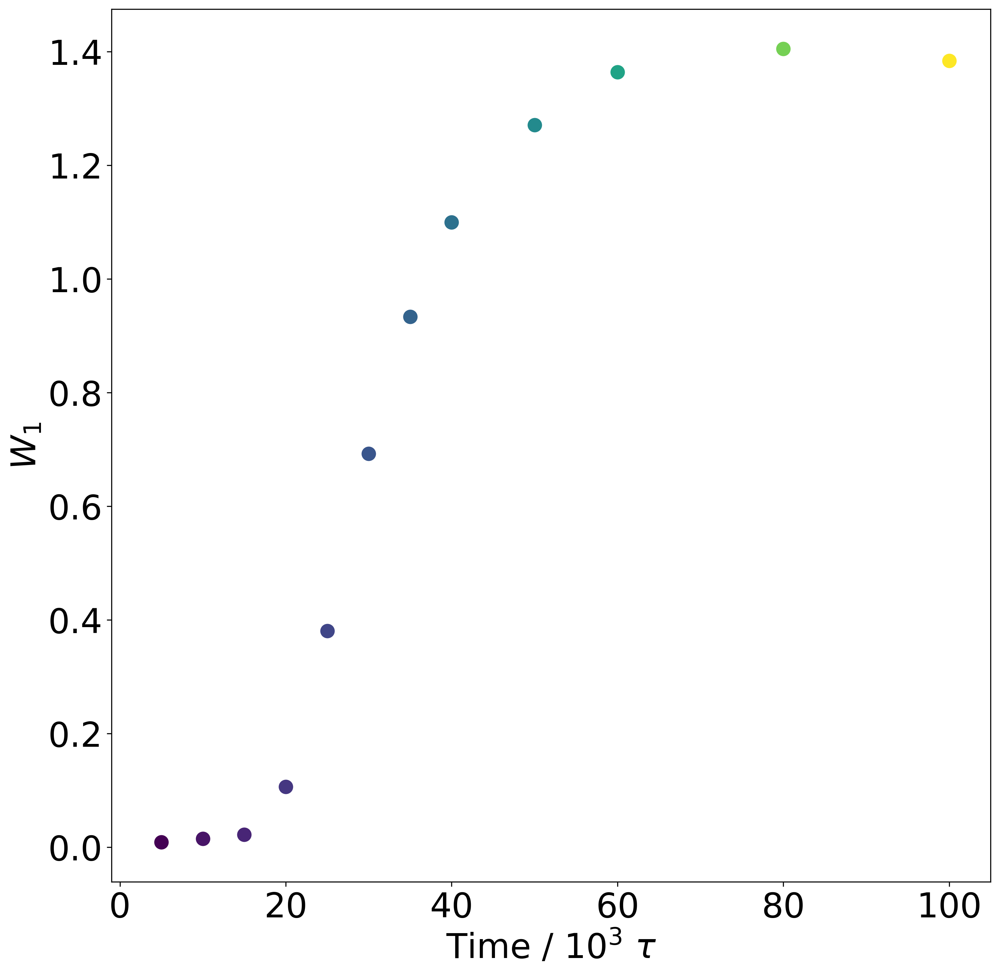

In [60]:
fig, host = plt.subplots(1,1,figsize = (12,12))
host.tick_params(axis='both', which='major', labelsize=26)

host.set_xlim(-1, 105)
host.set_xlabel(r"Time / $10^3 \ \tau$",size=26)
host.set_ylabel(r"$W_1$",size=26)


x_time_fit = []
y_Wasserstein_fit = []
point_colors=[]

for snap_num in range(len(snap_steps_id)):
    Markov = ((1-(p[snap_steps_id[snap_num]]*(sims[0][3][0][snap_steps_id[snap_num]]+sims[0][3][2][snap_steps_id[snap_num]])))*(p[snap_steps_id[snap_num]]*(sims[0][3][0][snap_steps_id[snap_num]]+sims[0][3][2][snap_steps_id[snap_num]]))**(n_block-1))
    block_Wasserstein = [emd(n_block,n_block,snap_steps_blockdist[snap_num][1:]/np.sum(snap_steps_blockdist[snap_num][1:]),Markov)]
    host.scatter(10**(-6)*sims[0][2][snap_steps_id[snap_num]],block_Wasserstein,100,color=snap_steps_cmap(color_ids_snap_steps[snap_num]),marker='o')
    y_Wasserstein_fit.append(block_Wasserstein[0])
    x_time_fit.append(10**(-6)*sims[0][2][snap_steps_id[snap_num]])
    point_colors.append(snap_steps_cmap(color_ids_snap_steps[snap_num]))
        

#host.set_xlim(-13.05, -7.05);
fig.savefig('copoly3_Wasserstein_blockMarkov_emergence_time.png',dpi=300, bbox_inches='tight')

## Bonding Matrix

In [66]:
with open('./MC_FS_pairs.pickle','rb') as f:
    MC_FS_trials_pairs=pickle.load(f)
with open('./MC_FS_nums.pickle','rb') as f:
    MC_FS_trials_nums=pickle.load(f)
with open('./MC_FS_extent.pickle','rb') as f:
    MC_FS_extent_list=pickle.load(f)

In [67]:
#choosing simulation phases to split into
break_points = [0.3,0.6,0.9]
MC_FS_break_index = [np.abs(np.array(MC_FS_extent_list)-val).argmin() for val in break_points]
#maximum chain length to track (any higher lengths binned along with max length)
cutoff_len = 50

#initializing arrays
MC_FS_bond_mat_early = np.zeros((cutoff_len,cutoff_len))
MC_FS_bond_mat_mid = np.zeros((cutoff_len,cutoff_len))
MC_FS_bond_mat_late = np.zeros((cutoff_len,cutoff_len))

bonds_early=0
bonds_mid=0
bonds_late=0

#calculating pair matrix for each phase
for trial in MC_FS_trials_pairs:
    for pair in trial[:MC_FS_break_index[0]]:
        if pair[0] >= cutoff_len:
            MC_FS_bond_mat_early[cutoff_len-1,cutoff_len-1]+=1
            bonds_early += 1
        elif pair[1] >= cutoff_len:
            MC_FS_bond_mat_early[pair[0]-1,cutoff_len-1]+=1
            bonds_early += 1
        else:
            MC_FS_bond_mat_early[pair[0]-1,pair[1]-1]+=1
            bonds_early += 1

    for pair in trial[MC_FS_break_index[0]:MC_FS_break_index[1]]:
        if pair[0] >= cutoff_len:
            MC_FS_bond_mat_mid[cutoff_len-1,cutoff_len-1]+=1
            bonds_mid+=1
        elif pair[1] >= cutoff_len:
            MC_FS_bond_mat_mid[pair[0]-1,cutoff_len-1]+=1
            bonds_mid+=1
        else:
            MC_FS_bond_mat_mid[pair[0]-1,pair[1]-1]+=1
            bonds_mid+=1

    for pair in trial[MC_FS_break_index[1]:MC_FS_break_index[2]]:
        if pair[0] >= cutoff_len:
            MC_FS_bond_mat_late[cutoff_len-1,cutoff_len-1]+=1
            bonds_late+=1
        elif pair[1] >= cutoff_len:
            MC_FS_bond_mat_late[pair[0]-1,cutoff_len-1]+=1
            bonds_late+=1
        else:
            MC_FS_bond_mat_late[pair[0]-1,pair[1]-1]+=1
            bonds_late+=1
MC_FS_bond_mat_early/=bonds_early
MC_FS_bond_mat_mid/=bonds_mid
MC_FS_bond_mat_late/=bonds_late
for i in range(cutoff_len):
    for j in range(cutoff_len):
        MC_FS_bond_mat_early[j,i] = MC_FS_bond_mat_early[i,j]
        MC_FS_bond_mat_mid[j,i] = MC_FS_bond_mat_mid[i,j]
        MC_FS_bond_mat_late[j,i] = MC_FS_bond_mat_late[i,j]

In [70]:
simid = 0

#reminder of bond_pair data structure
#print(sims[simid][17][4][-3])

#choosing simulation phases to split into
break_points = [0.3,0.6,0.9]
break_index = [np.abs(sims[simid][0]-val).argmin() for val in break_points]
#maximum chain length to track (any higher lengths binned along with max length)
#cutoff_len = 30

#initializing arrays
stiff_bond_mat_early = np.zeros((cutoff_len,cutoff_len))
stiff_bond_mat_mid = np.zeros((cutoff_len,cutoff_len))
stiff_bond_mat_late = np.zeros((cutoff_len,cutoff_len))

bonds_early=0
bonds_mid=0
bonds_late=0

#calculating pair matrix for each phase
for pair_list in sims[simid][17][4][0:break_index[0]]:
    for pair in pair_list:
        if pair[0] >= cutoff_len:
            stiff_bond_mat_early[cutoff_len-1,cutoff_len-1]+=1
            bonds_early += 1
        elif pair[1] >= cutoff_len:
            stiff_bond_mat_early[pair[0]-1,cutoff_len-1]+=1
            bonds_early += 1
        else:
            stiff_bond_mat_early[pair[0]-1,pair[1]-1]+=1
            bonds_early += 1
stiff_bond_mat_early/=bonds_early

for pair_list in sims[simid][17][4][break_index[0]:break_index[1]]:
    for pair in pair_list:
        if pair[0] >= cutoff_len:
            stiff_bond_mat_mid[cutoff_len-1,cutoff_len-1]+=1
            bonds_mid+=1
        elif pair[1] >= cutoff_len:
            stiff_bond_mat_mid[pair[0]-1,cutoff_len-1]+=1
            bonds_mid+=1
        else:
            stiff_bond_mat_mid[pair[0]-1,pair[1]-1]+=1
            bonds_mid+=1
stiff_bond_mat_mid/=bonds_mid

for pair_list in sims[simid][17][4][break_index[1]:break_index[2]]:
    for pair in pair_list:
        if pair[0] >= cutoff_len:
            stiff_bond_mat_late[cutoff_len-1,cutoff_len-1]+=1
            bonds_late+=1
        elif pair[1] >= cutoff_len:
            stiff_bond_mat_late[pair[0]-1,cutoff_len-1]+=1
            bonds_late+=1
        else:
            stiff_bond_mat_late[pair[0]-1,pair[1]-1]+=1
            bonds_late+=1
stiff_bond_mat_late/=bonds_late
for i in range(cutoff_len):
    for j in range(cutoff_len):
        stiff_bond_mat_early[j,i] = stiff_bond_mat_early[i,j]
        stiff_bond_mat_mid[j,i] = stiff_bond_mat_mid[i,j]
        stiff_bond_mat_late[j,i] = stiff_bond_mat_late[i,j]

In [73]:
simid = 19

#reminder of bond_pair data structure
#print(sims[simid][17][4][-3])

#choosing simulation phases to split into
break_points = [0.3,0.6,0.9]
break_index = [np.abs(sims[simid][0]-val).argmin() for val in break_points]
#maximum chain length to track (any higher lengths binned along with max length)
#cutoff_len = 30

#initializing arrays
flex_bond_mat_early = np.zeros((cutoff_len,cutoff_len))
flex_bond_mat_mid = np.zeros((cutoff_len,cutoff_len))
flex_bond_mat_late = np.zeros((cutoff_len,cutoff_len))

bonds_early=0
bonds_mid=0
bonds_late=0

#calculating pair matrix for each phase
for pair_list in sims[simid][17][4][0:break_index[0]]:
    for pair in pair_list:
        if pair[0] >= cutoff_len:
            flex_bond_mat_early[cutoff_len-1,cutoff_len-1]+=1
            bonds_early += 1
        elif pair[1] >= cutoff_len:
            flex_bond_mat_early[pair[0]-1,cutoff_len-1]+=1
            bonds_early += 1
        else:
            flex_bond_mat_early[pair[0]-1,pair[1]-1]+=1
            bonds_early += 1
flex_bond_mat_early/=bonds_early

for pair_list in sims[simid][17][4][break_index[0]:break_index[1]]:
    for pair in pair_list:
        if pair[0] >= cutoff_len:
            flex_bond_mat_mid[cutoff_len-1,cutoff_len-1]+=1
            bonds_mid+=1
        elif pair[1] >= cutoff_len:
            flex_bond_mat_mid[pair[0]-1,cutoff_len-1]+=1
            bonds_mid+=1
        else:
            flex_bond_mat_mid[pair[0]-1,pair[1]-1]+=1
            bonds_mid+=1
flex_bond_mat_mid/=bonds_mid

for pair_list in sims[simid][17][4][break_index[1]:break_index[2]]:
    for pair in pair_list:
        if pair[0] >= cutoff_len:
            flex_bond_mat_late[cutoff_len-1,cutoff_len-1]+=1
            bonds_late+=1
        elif pair[1] >= cutoff_len:
            flex_bond_mat_late[pair[0]-1,cutoff_len-1]+=1
            bonds_late+=1
        else:
            flex_bond_mat_late[pair[0]-1,pair[1]-1]+=1
            bonds_late+=1
flex_bond_mat_late/=bonds_late
for i in range(cutoff_len):
    for j in range(cutoff_len):
        flex_bond_mat_early[j,i] = flex_bond_mat_early[i,j]
        flex_bond_mat_mid[j,i] = flex_bond_mat_mid[i,j]
        flex_bond_mat_late[j,i] = flex_bond_mat_late[i,j]

In [76]:
flex_mask = np.zeros_like(flex_bond_mat_early,dtype=bool)
stiff_mask = np.zeros_like(stiff_bond_mat_early,dtype=bool)
stiff_mask[np.tril_indices_from(stiff_mask)] = True
stiff_mask[np.diag_indices_from(stiff_mask)] = False
flex_mask[np.triu_indices_from(flex_mask)] = True
flex_mask[np.diag_indices_from(flex_mask)] = False

# print(flex_mask)
# print(np.ma.array(flex_bond_mat_early-MC_FS_bond_mat_early,mask=flex_mask))

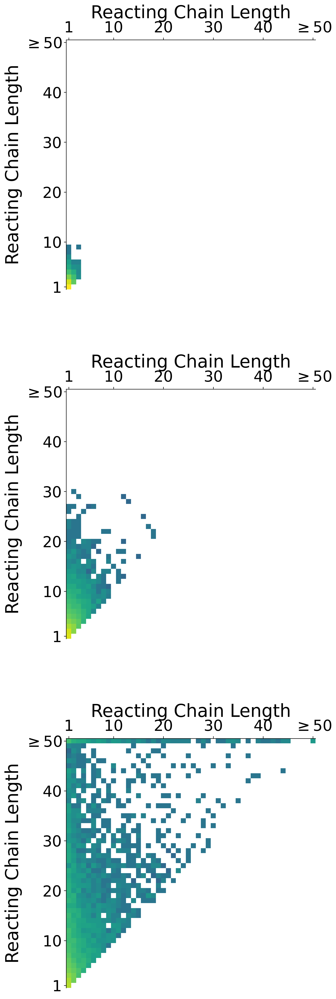

In [77]:
fig, (ax1,ax2,ax3) = plt.subplots(3,1,figsize = (18,27), gridspec_kw={'hspace': 0.4})



pixEarly=ax1.imshow(np.ma.array(flex_bond_mat_early,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixMid=ax2.imshow(np.ma.array(flex_bond_mat_mid,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixLate=ax3.imshow(np.ma.array(flex_bond_mat_late,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))


# cb_AA = plt.colorbar(pixEarly, ax=[ax1,ax2,ax3] , orientation='vertical',location='right', aspect=100, pad=0.025)

# cb_AA.set_label(r'$\Delta p_{FS}$',size=largesize)

# cb_AA.set_ticks([-0.1,-0.01,-0.001,-0.0001,-0.00001,0.0,0.00001,0.0001,0.001,0.01,0.1])

for ax in [ax1,ax2,ax3]:
    ax.set_xlim(-0.5,cutoff_len-0.5)
    ax.set_ylim(-0.5,cutoff_len-0.5)
    ax.set_xticks([0,9,19,29,39,49])
    ax.set_xticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_yticks([0,9,19,29,39,49])
    ax.set_yticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_xlabel('Reacting Chain Length')
    ax.xaxis.set_label_position('top') 
    ax.xaxis.tick_top()
    ax.set_ylabel('Reacting Chain Length')
    #ax.spines['top'].set_visible(False)
    #ax.spines['left'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    

plt.show()
fig.savefig('copoly3_bond_prob_mat_flex.png',dpi=300, bbox_inches='tight',transparent=True)

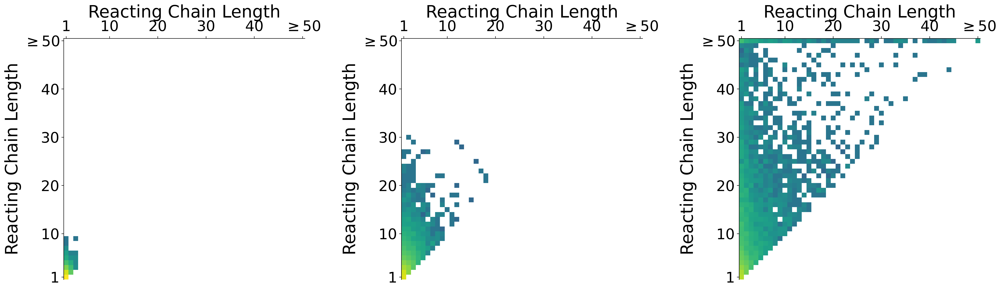

In [78]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize = (27,18), gridspec_kw={'wspace': 0.4})



pixEarly=ax1.imshow(np.ma.array(flex_bond_mat_early,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixMid=ax2.imshow(np.ma.array(flex_bond_mat_mid,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixLate=ax3.imshow(np.ma.array(flex_bond_mat_late,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))


# cb_AA = plt.colorbar(pixEarly, ax=[ax1,ax2,ax3] , orientation='vertical',location='right', aspect=100, pad=0.025)

# cb_AA.set_label(r'$\Delta p_{FS}$',size=largesize)

# cb_AA.set_ticks([-0.1,-0.01,-0.001,-0.0001,-0.00001,0.0,0.00001,0.0001,0.001,0.01,0.1])

for ax in [ax1,ax2,ax3]:
    ax.set_xlim(-0.5,cutoff_len-0.5)
    ax.set_ylim(-0.5,cutoff_len-0.5)
    ax.set_xticks([0,9,19,29,39,49])
    ax.set_xticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_yticks([0,9,19,29,39,49])
    ax.set_yticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_xlabel('Reacting Chain Length')
    ax.xaxis.set_label_position('top') 
    ax.xaxis.tick_top()
    ax.set_ylabel('Reacting Chain Length')
    #ax.spines['top'].set_visible(False)
    #ax.spines['left'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    

plt.show()
fig.savefig('copoly3_bond_prob_mat_flex_horizontal.png',dpi=300, bbox_inches='tight',transparent=True)

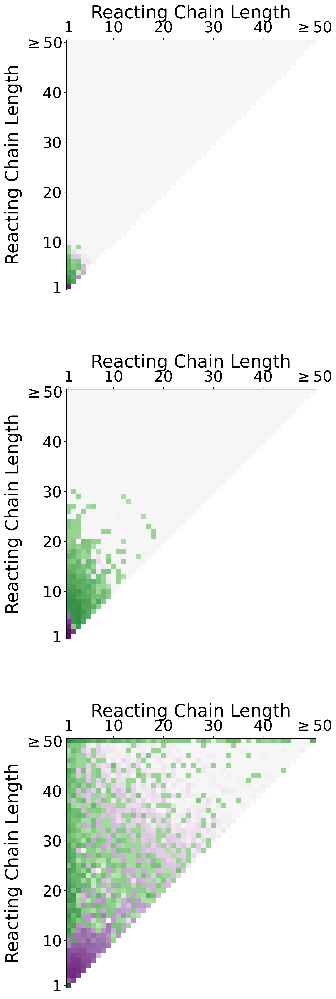

In [79]:
fig, (ax1,ax2,ax3) = plt.subplots(3,1,figsize = (18,27), gridspec_kw={'hspace': 0.4})



pixEarly=ax1.imshow(np.ma.array(flex_bond_mat_early-MC_FS_bond_mat_early,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1.,vmin=-0.2, vmax=0.2, base=10))
pixMid=ax2.imshow(np.ma.array(flex_bond_mat_mid-MC_FS_bond_mat_mid,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1., vmin=-0.2, vmax=0.2, base=10))
pixLate=ax3.imshow(np.ma.array(flex_bond_mat_late-MC_FS_bond_mat_late,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1., vmin=-0.2, vmax=0.2, base=10))


# cb_AA = plt.colorbar(pixEarly, ax=[ax1,ax2,ax3] , orientation='vertical',location='right', aspect=100, pad=0.025)

# cb_AA.set_label(r'$\Delta p_{FS}$',size=largesize)

# cb_AA.set_ticks([-0.1,-0.01,-0.001,-0.0001,-0.00001,0.0,0.00001,0.0001,0.001,0.01,0.1])

for ax in [ax1,ax2,ax3]:
    ax.set_xlim(-0.5,cutoff_len-0.5)
    ax.set_ylim(-0.5,cutoff_len-0.5)
    ax.set_xticks([0,9,19,29,39,49])
    ax.set_xticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_yticks([0,9,19,29,39,49])
    ax.set_yticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_xlabel('Reacting Chain Length')
    ax.xaxis.set_label_position('top') 
    ax.xaxis.tick_top()
    ax.set_ylabel('Reacting Chain Length')
    #ax.spines['top'].set_visible(False)
    #ax.spines['left'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    

plt.show()
fig.savefig('copoly3_bond_prob_mat_flex_delta.png',dpi=300, bbox_inches='tight',transparent=True)

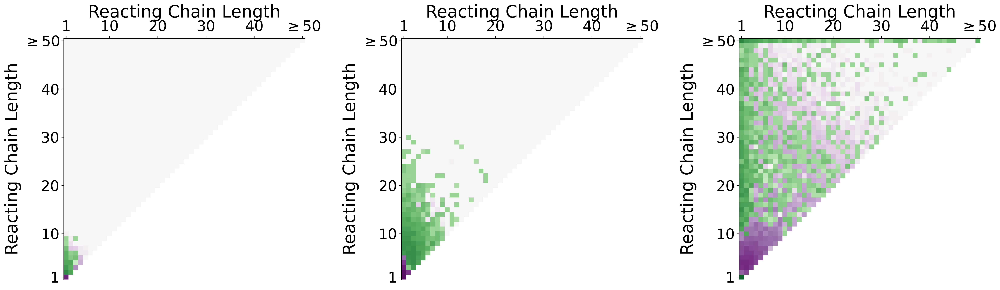

In [80]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize = (27,18), gridspec_kw={'wspace': 0.4})



pixEarly=ax1.imshow(np.ma.array(flex_bond_mat_early-MC_FS_bond_mat_early,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1.,vmin=-0.2, vmax=0.2, base=10))
pixMid=ax2.imshow(np.ma.array(flex_bond_mat_mid-MC_FS_bond_mat_mid,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1., vmin=-0.2, vmax=0.2, base=10))
pixLate=ax3.imshow(np.ma.array(flex_bond_mat_late-MC_FS_bond_mat_late,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1., vmin=-0.2, vmax=0.2, base=10))


# cb_AA = plt.colorbar(pixEarly, ax=[ax1,ax2,ax3] , orientation='vertical',location='right', aspect=100, pad=0.025)

# cb_AA.set_label(r'$\Delta p_{FS}$',size=largesize)

# cb_AA.set_ticks([-0.1,-0.01,-0.001,-0.0001,-0.00001,0.0,0.00001,0.0001,0.001,0.01,0.1])

for ax in [ax1,ax2,ax3]:
    ax.set_xlim(-0.5,cutoff_len-0.5)
    ax.set_ylim(-0.5,cutoff_len-0.5)
    ax.set_xticks([0,9,19,29,39,49])
    ax.set_xticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_yticks([0,9,19,29,39,49])
    ax.set_yticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_xlabel('Reacting Chain Length')
    ax.xaxis.set_label_position('top') 
    ax.xaxis.tick_top()
    ax.set_ylabel('Reacting Chain Length')
    #ax.spines['top'].set_visible(False)
    #ax.spines['left'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    

plt.show()
fig.savefig('copoly3_bond_prob_mat_flex_delta_horizontal.png',dpi=300, bbox_inches='tight',transparent=True)

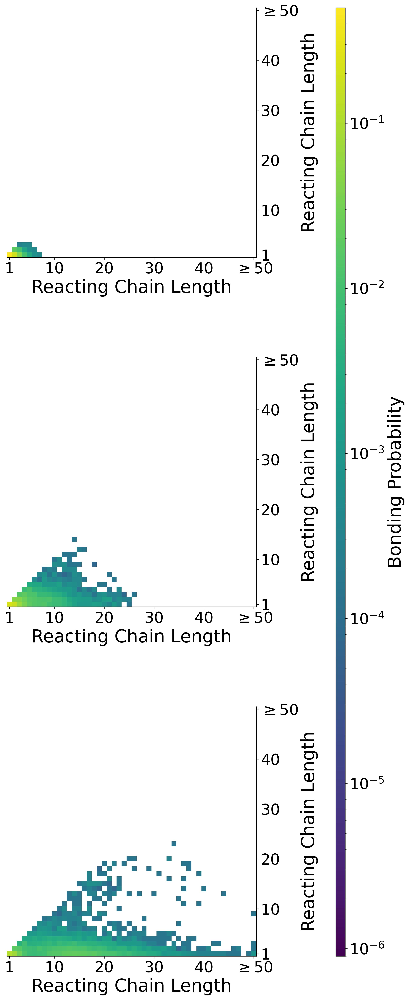

In [81]:
fig, (ax1,ax2,ax3) = plt.subplots(3,1,figsize = (18,27), gridspec_kw={'hspace': 0.4})


pixEarly=ax1.imshow(np.ma.array(stiff_bond_mat_early,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixMid=ax2.imshow(np.ma.array(stiff_bond_mat_mid,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixLate=ax3.imshow(np.ma.array(stiff_bond_mat_late,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))


cb_AA = plt.colorbar(pixEarly, ax=[ax1,ax2,ax3] , orientation='vertical',location='right', aspect=100, pad=0.125)
cb_AA.set_label(r'Bonding Probability')

for ax in [ax1,ax2,ax3]:
    ax.set_xlim(-0.5,cutoff_len-0.5)
    ax.set_ylim(-0.5,cutoff_len-0.5)
    ax.set_xticks([0,9,19,29,39,49])
    ax.set_xticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_yticks([0,9,19,29,39,49])
    ax.set_yticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_xlabel('Reacting Chain Length')
    ax.yaxis.tick_right()
    ax.yaxis.set_label_position('right')
    ax.set_ylabel('Reacting Chain Length')
    ax.spines['top'].set_visible(False)
    ax.spines['left'].set_visible(False)
    #ax.spines['right'].set_visible(False)
    #ax.spines['bottom'].set_visible(False)


plt.show()
fig.savefig('copoly3_bond_prob_mat_stiff.png',dpi=300, bbox_inches='tight',transparent=True)

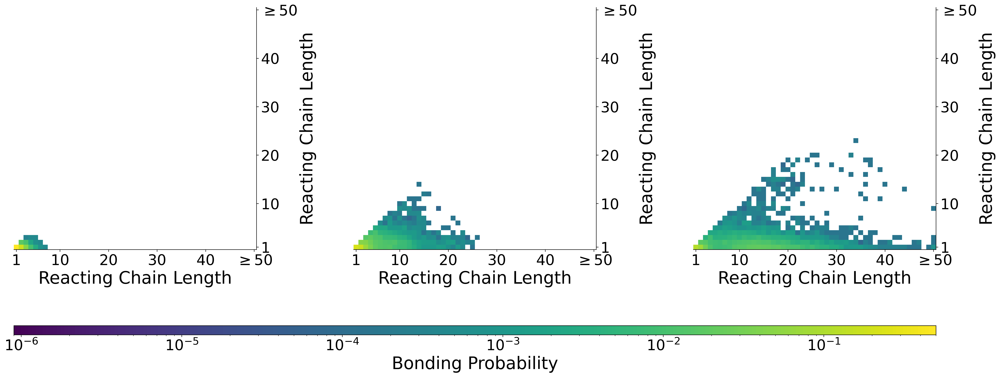

In [82]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize = (27,18), gridspec_kw={'wspace': 0.4})


pixEarly=ax1.imshow(np.ma.array(stiff_bond_mat_early,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixMid=ax2.imshow(np.ma.array(stiff_bond_mat_mid,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixLate=ax3.imshow(np.ma.array(stiff_bond_mat_late,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))


cb_AA = plt.colorbar(pixEarly, ax=[ax1,ax2,ax3] , orientation='horizontal',location='bottom', aspect=100, pad=0.125)
cb_AA.set_label(r'Bonding Probability')

for ax in [ax1,ax2,ax3]:
    ax.set_xlim(-0.5,cutoff_len-0.5)
    ax.set_ylim(-0.5,cutoff_len-0.5)
    ax.set_xticks([0,9,19,29,39,49])
    ax.set_xticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_yticks([0,9,19,29,39,49])
    ax.set_yticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_xlabel('Reacting Chain Length')
    ax.yaxis.tick_right()
    ax.yaxis.set_label_position('right')
    ax.set_ylabel('Reacting Chain Length')
    ax.spines['top'].set_visible(False)
    ax.spines['left'].set_visible(False)
    #ax.spines['right'].set_visible(False)
    #ax.spines['bottom'].set_visible(False)


plt.show()
fig.savefig('copoly3_bond_prob_mat_stiff_horizontal.png',dpi=300, bbox_inches='tight',transparent=True)

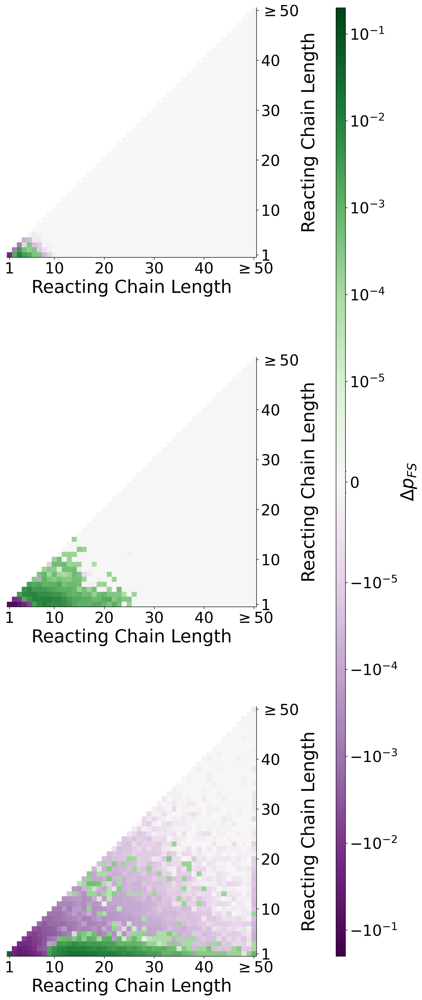

In [83]:
fig, (ax1,ax2,ax3) = plt.subplots(3,1,figsize = (18,27), gridspec_kw={'hspace': 0.4})


pixEarly=ax1.imshow(np.ma.array(stiff_bond_mat_early-MC_FS_bond_mat_early,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1.,vmin=-0.2, vmax=0.2, base=10))
pixMid=ax2.imshow(np.ma.array(stiff_bond_mat_mid-MC_FS_bond_mat_mid,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1., vmin=-0.2, vmax=0.2, base=10))
pixLate=ax3.imshow(np.ma.array(stiff_bond_mat_late-MC_FS_bond_mat_late,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1., vmin=-0.2, vmax=0.2, base=10))


cb_AA = plt.colorbar(pixEarly, ax=[ax1,ax2,ax3] , orientation='vertical',location='right', aspect=100, pad=0.125)

cb_AA.set_label(r'$\Delta p_{FS}$')

cb_AA.set_ticks([-0.1,-0.01,-0.001,-0.0001,-0.00001,0.0,0.00001,0.0001,0.001,0.01,0.1])

for ax in [ax1,ax2,ax3]:
    ax.set_xlim(-0.5,cutoff_len-0.5)
    ax.set_ylim(-0.5,cutoff_len-0.5)
    ax.set_xticks([0,9,19,29,39,49])
    ax.set_xticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_yticks([0,9,19,29,39,49])
    ax.set_yticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_xlabel('Reacting Chain Length')
    ax.yaxis.tick_right()
    ax.yaxis.set_label_position('right')
    ax.set_ylabel('Reacting Chain Length')
    ax.spines['top'].set_visible(False)
    ax.spines['left'].set_visible(False)
    #ax.spines['right'].set_visible(False)
    #ax.spines['bottom'].set_visible(False)


plt.show()
fig.savefig('copoly3_bond_prob_mat_stiff_delta.png',dpi=300, bbox_inches='tight',transparent=True)

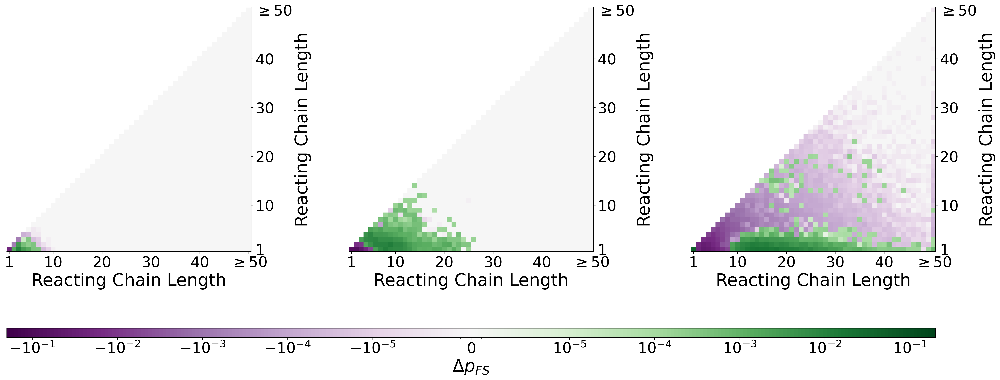

In [84]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize = (27,18), gridspec_kw={'wspace': 0.4})


pixEarly=ax1.imshow(np.ma.array(stiff_bond_mat_early-MC_FS_bond_mat_early,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1.,vmin=-0.2, vmax=0.2, base=10))
pixMid=ax2.imshow(np.ma.array(stiff_bond_mat_mid-MC_FS_bond_mat_mid,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1., vmin=-0.2, vmax=0.2, base=10))
pixLate=ax3.imshow(np.ma.array(stiff_bond_mat_late-MC_FS_bond_mat_late,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1., vmin=-0.2, vmax=0.2, base=10))


cb_AA = plt.colorbar(pixEarly, ax=[ax1,ax2,ax3] , orientation='horizontal',location='bottom', aspect=100, pad=0.125)

cb_AA.set_label(r'$\Delta p_{FS}$')

cb_AA.set_ticks([-0.1,-0.01,-0.001,-0.0001,-0.00001,0.0,0.00001,0.0001,0.001,0.01,0.1])

for ax in [ax1,ax2,ax3]:
    ax.set_xlim(-0.5,cutoff_len-0.5)
    ax.set_ylim(-0.5,cutoff_len-0.5)
    ax.set_xticks([0,9,19,29,39,49])
    ax.set_xticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_yticks([0,9,19,29,39,49])
    ax.set_yticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_xlabel('Reacting Chain Length')
    ax.yaxis.tick_right()
    ax.yaxis.set_label_position('right')
    ax.set_ylabel('Reacting Chain Length')
    ax.spines['top'].set_visible(False)
    ax.spines['left'].set_visible(False)
    #ax.spines['right'].set_visible(False)
    #ax.spines['bottom'].set_visible(False)


plt.show()
fig.savefig('copoly3_bond_prob_mat_stiff_delta_horizontal.png',dpi=300, bbox_inches='tight',transparent=True)

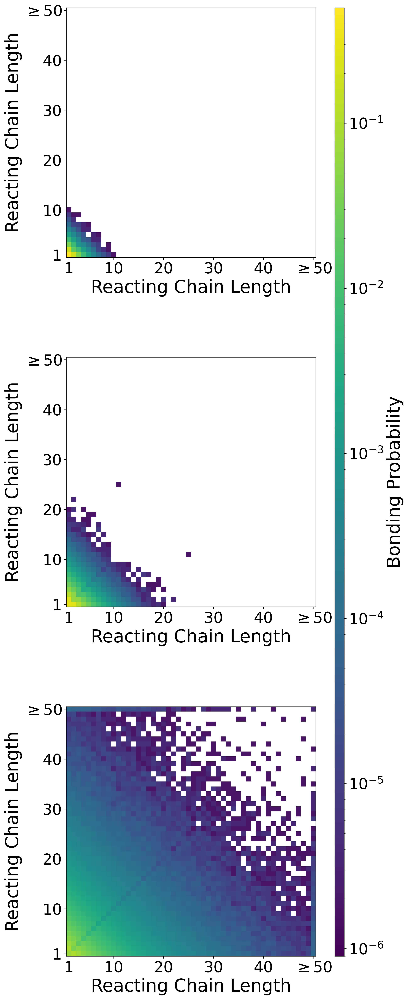

In [85]:
fig, (ax1,ax2,ax3) = plt.subplots(3,1,figsize = (18,27), gridspec_kw={'hspace': 0.4})


pixEarly=ax1.imshow(MC_FS_bond_mat_early, interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixMid=ax2.imshow(MC_FS_bond_mat_mid, interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixLate=ax3.imshow(MC_FS_bond_mat_late, interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))


cb_AA = plt.colorbar(pixEarly, ax=[ax1,ax2,ax3] , orientation='vertical',location='right', aspect=100, pad=0.03)
cb_AA.set_label(r'Bonding Probability')



for ax in [ax1,ax2,ax3]:
    ax.set_xlim(-0.5,cutoff_len-0.5)
    ax.set_ylim(-0.5,cutoff_len-0.5)
    ax.set_xticks([0,9,19,29,39,49])
    ax.set_xticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_yticks([0,9,19,29,39,49])
    ax.set_yticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.xaxis.get_majorticklabels()[5].set_x(-25.)
    ax.set_xlabel('Reacting Chain Length')
    #ax.xaxis.set_label_position('top') 
    #ax.xaxis.tick_top()
    ax.set_ylabel('Reacting Chain Length')


plt.show()
fig.savefig('copoly3_bond_prob_mat_FS.png',dpi=300, bbox_inches='tight',transparent=True)

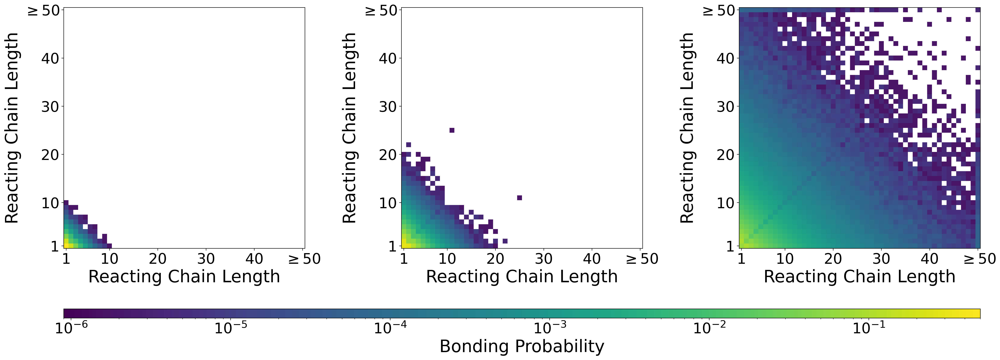

In [86]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize = (27,18), gridspec_kw={'wspace': 0.4})


pixEarly=ax1.imshow(MC_FS_bond_mat_early, interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixMid=ax2.imshow(MC_FS_bond_mat_mid, interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixLate=ax3.imshow(MC_FS_bond_mat_late, interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))


cb_AA = plt.colorbar(pixEarly, ax=[ax1,ax2,ax3] , orientation='horizontal',location='bottom', aspect=100, pad=0.1)
cb_AA.set_label(r'Bonding Probability')



for ax in [ax1,ax2,ax3]:
    ax.set_xlim(-0.5,cutoff_len-0.5)
    ax.set_ylim(-0.5,cutoff_len-0.5)
    ax.set_xticks([0,9,19,29,39,49])
    ax.set_xticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_yticks([0,9,19,29,39,49])
    ax.set_yticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.xaxis.get_majorticklabels()[5].set_x(-25.)
    ax.set_xlabel('Reacting Chain Length')
    #ax.xaxis.set_label_position('top') 
    #ax.xaxis.tick_top()
    ax.set_ylabel('Reacting Chain Length')


plt.show()
fig.savefig('copoly3_bond_prob_mat_FS_horizontal.png',dpi=300, bbox_inches='tight',transparent=True)

## Bonding Matrix - Updated Split

In [87]:
#choosing simulation phases to split into
#break_points = [0.3,0.6,0.9]
break_points = [0.4,0.7,0.9]
MC_FS_break_index = [np.abs(np.array(MC_FS_extent_list)-val).argmin() for val in break_points]
#maximum chain length to track (any higher lengths binned along with max length)
cutoff_len = 50

#initializing arrays
MC_FS_bond_mat_early = np.zeros((cutoff_len,cutoff_len))
MC_FS_bond_mat_mid = np.zeros((cutoff_len,cutoff_len))
MC_FS_bond_mat_late = np.zeros((cutoff_len,cutoff_len))

bonds_early=0
bonds_mid=0
bonds_late=0

#calculating pair matrix for each phase
for trial in MC_FS_trials_pairs:
    for pair in trial[:MC_FS_break_index[0]]:
        if pair[0] >= cutoff_len:
            MC_FS_bond_mat_early[cutoff_len-1,cutoff_len-1]+=1
            bonds_early += 1
        elif pair[1] >= cutoff_len:
            MC_FS_bond_mat_early[pair[0]-1,cutoff_len-1]+=1
            bonds_early += 1
        else:
            MC_FS_bond_mat_early[pair[0]-1,pair[1]-1]+=1
            bonds_early += 1

    for pair in trial[MC_FS_break_index[0]:MC_FS_break_index[1]]:
        if pair[0] >= cutoff_len:
            MC_FS_bond_mat_mid[cutoff_len-1,cutoff_len-1]+=1
            bonds_mid+=1
        elif pair[1] >= cutoff_len:
            MC_FS_bond_mat_mid[pair[0]-1,cutoff_len-1]+=1
            bonds_mid+=1
        else:
            MC_FS_bond_mat_mid[pair[0]-1,pair[1]-1]+=1
            bonds_mid+=1

    for pair in trial[MC_FS_break_index[1]:MC_FS_break_index[2]]:
        if pair[0] >= cutoff_len:
            MC_FS_bond_mat_late[cutoff_len-1,cutoff_len-1]+=1
            bonds_late+=1
        elif pair[1] >= cutoff_len:
            MC_FS_bond_mat_late[pair[0]-1,cutoff_len-1]+=1
            bonds_late+=1
        else:
            MC_FS_bond_mat_late[pair[0]-1,pair[1]-1]+=1
            bonds_late+=1
MC_FS_bond_mat_early/=bonds_early
MC_FS_bond_mat_mid/=bonds_mid
MC_FS_bond_mat_late/=bonds_late
for i in range(cutoff_len):
    for j in range(cutoff_len):
        MC_FS_bond_mat_early[j,i] = MC_FS_bond_mat_early[i,j]
        MC_FS_bond_mat_mid[j,i] = MC_FS_bond_mat_mid[i,j]
        MC_FS_bond_mat_late[j,i] = MC_FS_bond_mat_late[i,j]

In [88]:
simid = 0

#reminder of bond_pair data structure
#print(sims[simid][17][4][-3])

#choosing simulation phases to split into
#break_points = [0.3,0.6,0.9]
break_index = [np.abs(sims[simid][0]-val).argmin() for val in break_points]
#maximum chain length to track (any higher lengths binned along with max length)
#cutoff_len = 30

#initializing arrays
stiff_bond_mat_early = np.zeros((cutoff_len,cutoff_len))
stiff_bond_mat_mid = np.zeros((cutoff_len,cutoff_len))
stiff_bond_mat_late = np.zeros((cutoff_len,cutoff_len))

bonds_early=0
bonds_mid=0
bonds_late=0

#calculating pair matrix for each phase
for pair_list in sims[simid][17][4][0:break_index[0]]:
    for pair in pair_list:
        if pair[0] >= cutoff_len:
            stiff_bond_mat_early[cutoff_len-1,cutoff_len-1]+=1
            bonds_early += 1
        elif pair[1] >= cutoff_len:
            stiff_bond_mat_early[pair[0]-1,cutoff_len-1]+=1
            bonds_early += 1
        else:
            stiff_bond_mat_early[pair[0]-1,pair[1]-1]+=1
            bonds_early += 1
stiff_bond_mat_early/=bonds_early

for pair_list in sims[simid][17][4][break_index[0]:break_index[1]]:
    for pair in pair_list:
        if pair[0] >= cutoff_len:
            stiff_bond_mat_mid[cutoff_len-1,cutoff_len-1]+=1
            bonds_mid+=1
        elif pair[1] >= cutoff_len:
            stiff_bond_mat_mid[pair[0]-1,cutoff_len-1]+=1
            bonds_mid+=1
        else:
            stiff_bond_mat_mid[pair[0]-1,pair[1]-1]+=1
            bonds_mid+=1
stiff_bond_mat_mid/=bonds_mid

for pair_list in sims[simid][17][4][break_index[1]:break_index[2]]:
    for pair in pair_list:
        if pair[0] >= cutoff_len:
            stiff_bond_mat_late[cutoff_len-1,cutoff_len-1]+=1
            bonds_late+=1
        elif pair[1] >= cutoff_len:
            stiff_bond_mat_late[pair[0]-1,cutoff_len-1]+=1
            bonds_late+=1
        else:
            stiff_bond_mat_late[pair[0]-1,pair[1]-1]+=1
            bonds_late+=1
stiff_bond_mat_late/=bonds_late
for i in range(cutoff_len):
    for j in range(cutoff_len):
        stiff_bond_mat_early[j,i] = stiff_bond_mat_early[i,j]
        stiff_bond_mat_mid[j,i] = stiff_bond_mat_mid[i,j]
        stiff_bond_mat_late[j,i] = stiff_bond_mat_late[i,j]

In [89]:
simid = 19

#reminder of bond_pair data structure
#print(sims[simid][17][4][-3])

#choosing simulation phases to split into
#break_points = [0.3,0.6,0.9]
break_index = [np.abs(sims[simid][0]-val).argmin() for val in break_points]
#maximum chain length to track (any higher lengths binned along with max length)
#cutoff_len = 30

#initializing arrays
flex_bond_mat_early = np.zeros((cutoff_len,cutoff_len))
flex_bond_mat_mid = np.zeros((cutoff_len,cutoff_len))
flex_bond_mat_late = np.zeros((cutoff_len,cutoff_len))

bonds_early=0
bonds_mid=0
bonds_late=0

#calculating pair matrix for each phase
for pair_list in sims[simid][17][4][0:break_index[0]]:
    for pair in pair_list:
        if pair[0] >= cutoff_len:
            flex_bond_mat_early[cutoff_len-1,cutoff_len-1]+=1
            bonds_early += 1
        elif pair[1] >= cutoff_len:
            flex_bond_mat_early[pair[0]-1,cutoff_len-1]+=1
            bonds_early += 1
        else:
            flex_bond_mat_early[pair[0]-1,pair[1]-1]+=1
            bonds_early += 1
flex_bond_mat_early/=bonds_early

for pair_list in sims[simid][17][4][break_index[0]:break_index[1]]:
    for pair in pair_list:
        if pair[0] >= cutoff_len:
            flex_bond_mat_mid[cutoff_len-1,cutoff_len-1]+=1
            bonds_mid+=1
        elif pair[1] >= cutoff_len:
            flex_bond_mat_mid[pair[0]-1,cutoff_len-1]+=1
            bonds_mid+=1
        else:
            flex_bond_mat_mid[pair[0]-1,pair[1]-1]+=1
            bonds_mid+=1
flex_bond_mat_mid/=bonds_mid

for pair_list in sims[simid][17][4][break_index[1]:break_index[2]]:
    for pair in pair_list:
        if pair[0] >= cutoff_len:
            flex_bond_mat_late[cutoff_len-1,cutoff_len-1]+=1
            bonds_late+=1
        elif pair[1] >= cutoff_len:
            flex_bond_mat_late[pair[0]-1,cutoff_len-1]+=1
            bonds_late+=1
        else:
            flex_bond_mat_late[pair[0]-1,pair[1]-1]+=1
            bonds_late+=1
flex_bond_mat_late/=bonds_late
for i in range(cutoff_len):
    for j in range(cutoff_len):
        flex_bond_mat_early[j,i] = flex_bond_mat_early[i,j]
        flex_bond_mat_mid[j,i] = flex_bond_mat_mid[i,j]
        flex_bond_mat_late[j,i] = flex_bond_mat_late[i,j]

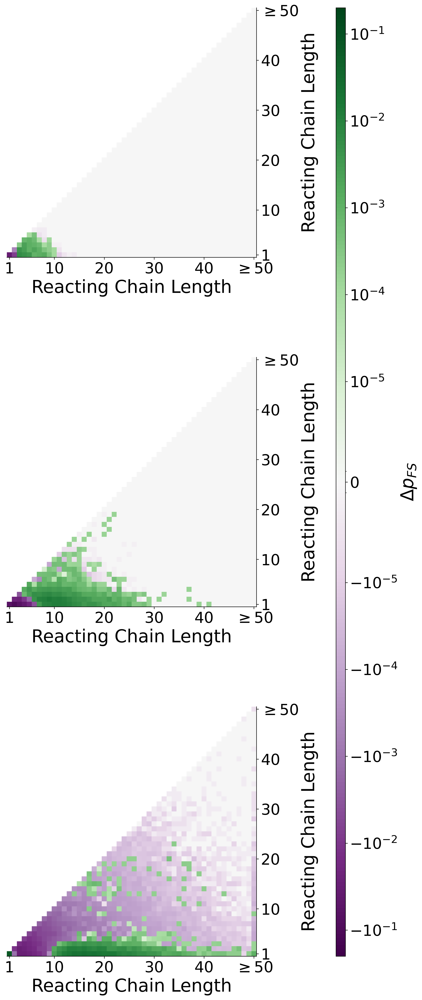

In [93]:
fig, (ax1,ax2,ax3) = plt.subplots(3,1,figsize = (18,27), gridspec_kw={'hspace': 0.4})


pixEarly=ax1.imshow(np.ma.array(stiff_bond_mat_early-MC_FS_bond_mat_early,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1.,vmin=-0.2, vmax=0.2, base=10))
pixMid=ax2.imshow(np.ma.array(stiff_bond_mat_mid-MC_FS_bond_mat_mid,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1., vmin=-0.2, vmax=0.2, base=10))
pixLate=ax3.imshow(np.ma.array(stiff_bond_mat_late-MC_FS_bond_mat_late,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1., vmin=-0.2, vmax=0.2, base=10))


cb_AA = plt.colorbar(pixEarly, ax=[ax1,ax2,ax3] , orientation='vertical',location='right', aspect=100, pad=0.125)

cb_AA.set_label(r'$\Delta p_{FS}$')

cb_AA.set_ticks([-0.1,-0.01,-0.001,-0.0001,-0.00001,0.0,0.00001,0.0001,0.001,0.01,0.1])

for ax in [ax1,ax2,ax3]:
    ax.set_xlim(-0.5,cutoff_len-0.5)
    ax.set_ylim(-0.5,cutoff_len-0.5)
    ax.set_xticks([0,9,19,29,39,49])
    ax.set_xticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_yticks([0,9,19,29,39,49])
    ax.set_yticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_xlabel('Reacting Chain Length')
    ax.yaxis.tick_right()
    ax.yaxis.set_label_position('right')
    ax.set_ylabel('Reacting Chain Length')
    ax.spines['top'].set_visible(False)
    ax.spines['left'].set_visible(False)
    #ax.spines['right'].set_visible(False)
    #ax.spines['bottom'].set_visible(False)


plt.show()
fig.savefig('230621_altsplit_copoly3_bond_prob_mat_stiff_delta.png',dpi=300, bbox_inches='tight',transparent=True)

## Bonding Matrix - Cleaner Alternative

In [97]:
#choosing simulation phases to split into
#break_points = [0.3,0.6,0.9]
break_points = [0.4,0.7,0.9]
MC_FS_break_index = [np.abs(np.array(MC_FS_extent_list)-val).argmin() for val in break_points]
#maximum chain length to track (any higher lengths binned along with max length)
cutoff_len = 50

#initializing arrays
MC_FS_bond_mat_early = np.zeros((cutoff_len,cutoff_len))
MC_FS_bond_mat_mid = np.zeros((cutoff_len,cutoff_len))
MC_FS_bond_mat_late = np.zeros((cutoff_len,cutoff_len))

bonds_early=0
bonds_mid=0
bonds_late=0

#calculating pair matrix for each phase
for trial in MC_FS_trials_pairs:
    for pair in trial[:MC_FS_break_index[0]]:
        if pair[0] >= cutoff_len:
            MC_FS_bond_mat_early[cutoff_len-1,cutoff_len-1]+=1
            bonds_early += 1
        elif pair[1] >= cutoff_len:
            MC_FS_bond_mat_early[pair[0]-1,cutoff_len-1]+=1
            bonds_early += 1
        else:
            MC_FS_bond_mat_early[pair[0]-1,pair[1]-1]+=1
            bonds_early += 1

    for pair in trial[MC_FS_break_index[0]:MC_FS_break_index[1]]:
        if pair[0] >= cutoff_len:
            MC_FS_bond_mat_mid[cutoff_len-1,cutoff_len-1]+=1
            bonds_mid+=1
        elif pair[1] >= cutoff_len:
            MC_FS_bond_mat_mid[pair[0]-1,cutoff_len-1]+=1
            bonds_mid+=1
        else:
            MC_FS_bond_mat_mid[pair[0]-1,pair[1]-1]+=1
            bonds_mid+=1

    for pair in trial[MC_FS_break_index[1]:MC_FS_break_index[2]]:
        if pair[0] >= cutoff_len:
            MC_FS_bond_mat_late[cutoff_len-1,cutoff_len-1]+=1
            bonds_late+=1
        elif pair[1] >= cutoff_len:
            MC_FS_bond_mat_late[pair[0]-1,cutoff_len-1]+=1
            bonds_late+=1
        else:
            MC_FS_bond_mat_late[pair[0]-1,pair[1]-1]+=1
            bonds_late+=1
MC_FS_bond_mat_early/=bonds_early
MC_FS_bond_mat_mid/=bonds_mid
MC_FS_bond_mat_late/=bonds_late
for i in range(cutoff_len):
    for j in range(cutoff_len):
        MC_FS_bond_mat_early[j,i] = MC_FS_bond_mat_early[i,j]
        MC_FS_bond_mat_mid[j,i] = MC_FS_bond_mat_mid[i,j]
        MC_FS_bond_mat_late[j,i] = MC_FS_bond_mat_late[i,j]

In [98]:
simid = 0

#reminder of bond_pair data structure
#print(sims[simid][17][4][-3])

#choosing simulation phases to split into
#break_points = [0.3,0.6,0.9]
break_index = [np.abs(sims[simid][0]-val).argmin() for val in break_points]
#maximum chain length to track (any higher lengths binned along with max length)
#cutoff_len = 30

#initializing arrays
stiff_bond_mat_early = np.zeros((cutoff_len,cutoff_len))
stiff_bond_mat_mid = np.zeros((cutoff_len,cutoff_len))
stiff_bond_mat_late = np.zeros((cutoff_len,cutoff_len))

bonds_early=0
bonds_mid=0
bonds_late=0

#calculating pair matrix for each phase
for pair_list in sims[simid][17][4][0:break_index[0]]:
    for pair in pair_list:
        if pair[0] >= cutoff_len:
            stiff_bond_mat_early[cutoff_len-1,cutoff_len-1]+=1
            bonds_early += 1
        elif pair[1] >= cutoff_len:
            stiff_bond_mat_early[pair[0]-1,cutoff_len-1]+=1
            bonds_early += 1
        else:
            stiff_bond_mat_early[pair[0]-1,pair[1]-1]+=1
            bonds_early += 1
stiff_bond_mat_early/=bonds_early

for pair_list in sims[simid][17][4][break_index[0]:break_index[1]]:
    for pair in pair_list:
        if pair[0] >= cutoff_len:
            stiff_bond_mat_mid[cutoff_len-1,cutoff_len-1]+=1
            bonds_mid+=1
        elif pair[1] >= cutoff_len:
            stiff_bond_mat_mid[pair[0]-1,cutoff_len-1]+=1
            bonds_mid+=1
        else:
            stiff_bond_mat_mid[pair[0]-1,pair[1]-1]+=1
            bonds_mid+=1
stiff_bond_mat_mid/=bonds_mid

for pair_list in sims[simid][17][4][break_index[1]:break_index[2]]:
    for pair in pair_list:
        if pair[0] >= cutoff_len:
            stiff_bond_mat_late[cutoff_len-1,cutoff_len-1]+=1
            bonds_late+=1
        elif pair[1] >= cutoff_len:
            stiff_bond_mat_late[pair[0]-1,cutoff_len-1]+=1
            bonds_late+=1
        else:
            stiff_bond_mat_late[pair[0]-1,pair[1]-1]+=1
            bonds_late+=1
stiff_bond_mat_late/=bonds_late
for i in range(cutoff_len):
    for j in range(cutoff_len):
        stiff_bond_mat_early[j,i] = stiff_bond_mat_early[i,j]
        stiff_bond_mat_mid[j,i] = stiff_bond_mat_mid[i,j]
        stiff_bond_mat_late[j,i] = stiff_bond_mat_late[i,j]

In [99]:
simid = 19

#reminder of bond_pair data structure
#print(sims[simid][17][4][-3])

#choosing simulation phases to split into
#break_points = [0.3,0.6,0.9]
break_index = [np.abs(sims[simid][0]-val).argmin() for val in break_points]
#maximum chain length to track (any higher lengths binned along with max length)
#cutoff_len = 30

#initializing arrays
flex_bond_mat_early = np.zeros((cutoff_len,cutoff_len))
flex_bond_mat_mid = np.zeros((cutoff_len,cutoff_len))
flex_bond_mat_late = np.zeros((cutoff_len,cutoff_len))

bonds_early=0
bonds_mid=0
bonds_late=0

#calculating pair matrix for each phase
for pair_list in sims[simid][17][4][0:break_index[0]]:
    for pair in pair_list:
        if pair[0] >= cutoff_len:
            flex_bond_mat_early[cutoff_len-1,cutoff_len-1]+=1
            bonds_early += 1
        elif pair[1] >= cutoff_len:
            flex_bond_mat_early[pair[0]-1,cutoff_len-1]+=1
            bonds_early += 1
        else:
            flex_bond_mat_early[pair[0]-1,pair[1]-1]+=1
            bonds_early += 1
flex_bond_mat_early/=bonds_early

for pair_list in sims[simid][17][4][break_index[0]:break_index[1]]:
    for pair in pair_list:
        if pair[0] >= cutoff_len:
            flex_bond_mat_mid[cutoff_len-1,cutoff_len-1]+=1
            bonds_mid+=1
        elif pair[1] >= cutoff_len:
            flex_bond_mat_mid[pair[0]-1,cutoff_len-1]+=1
            bonds_mid+=1
        else:
            flex_bond_mat_mid[pair[0]-1,pair[1]-1]+=1
            bonds_mid+=1
flex_bond_mat_mid/=bonds_mid

for pair_list in sims[simid][17][4][break_index[1]:break_index[2]]:
    for pair in pair_list:
        if pair[0] >= cutoff_len:
            flex_bond_mat_late[cutoff_len-1,cutoff_len-1]+=1
            bonds_late+=1
        elif pair[1] >= cutoff_len:
            flex_bond_mat_late[pair[0]-1,cutoff_len-1]+=1
            bonds_late+=1
        else:
            flex_bond_mat_late[pair[0]-1,pair[1]-1]+=1
            bonds_late+=1
flex_bond_mat_late/=bonds_late
for i in range(cutoff_len):
    for j in range(cutoff_len):
        flex_bond_mat_early[j,i] = flex_bond_mat_early[i,j]
        flex_bond_mat_mid[j,i] = flex_bond_mat_mid[i,j]
        flex_bond_mat_late[j,i] = flex_bond_mat_late[i,j]

/tmp/ipykernel_30711/4098077055.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


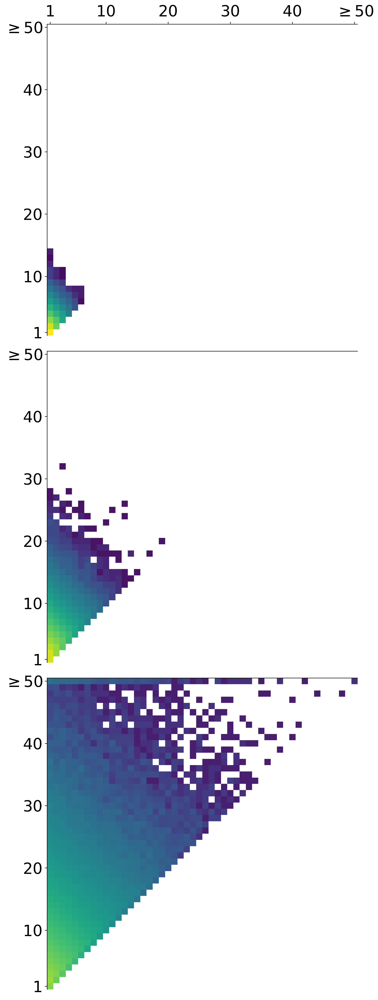

In [100]:
fig, (ax1,ax2,ax3) = plt.subplots(3,1,figsize = (18,27), gridspec_kw={'hspace': 0.05})



pixEarly=ax1.imshow(np.ma.array(MC_FS_bond_mat_early,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixMid=ax2.imshow(np.ma.array(MC_FS_bond_mat_mid,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixLate=ax3.imshow(np.ma.array(MC_FS_bond_mat_late,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))


# cb_AA = plt.colorbar(pixEarly, ax=[ax1,ax2,ax3] , orientation='vertical',location='right', aspect=100, pad=0.025)

# cb_AA.set_label(r'$\Delta p_{FS}$',size=largesize)

# cb_AA.set_ticks([-0.1,-0.01,-0.001,-0.0001,-0.00001,0.0,0.00001,0.0001,0.001,0.01,0.1])

for ax in [ax1,ax2,ax3]:
    ax.set_xlim(-0.5,cutoff_len-0.5)
    ax.set_ylim(-0.5,cutoff_len-0.5)
    ax.set_xticks([0,9,19,29,39,49])
    ax.set_xticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_yticks([0,9,19,29,39,49])
    ax.set_yticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    #ax.set_xlabel('Reacting Chain Length')
    ax.xaxis.set_label_position('top') 
    ax.xaxis.tick_top()
    #ax.set_ylabel('Reacting Chain Length')
    #ax.spines['top'].set_visible(False)
    #ax.spines['left'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    

# Hide axes label marks
ax2.xaxis.set_tick_params(labelbottom=False)
ax3.xaxis.set_tick_params(labelbottom=False)
#ax2.yaxis.set_tick_params(labelleft=False)
#ax3.yaxis.set_tick_params(labelleft=False)

# Hide axes tick marks
ax2.set_xticks([])
ax3.set_xticks([])
#ax2.set_yticks([])
#ax3.set_yticks([])
    
fig.tight_layout()
plt.show()
#fig.savefig('230701_clean_copoly3_bond_prob_mat_FS_flex.png',dpi=300, bbox_inches='tight',transparent=True)
fig.savefig('230701_clean_copoly3_bond_prob_mat_FS_flex.png',dpi=300, transparent=True)

/tmp/ipykernel_30711/1174833752.py:46: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


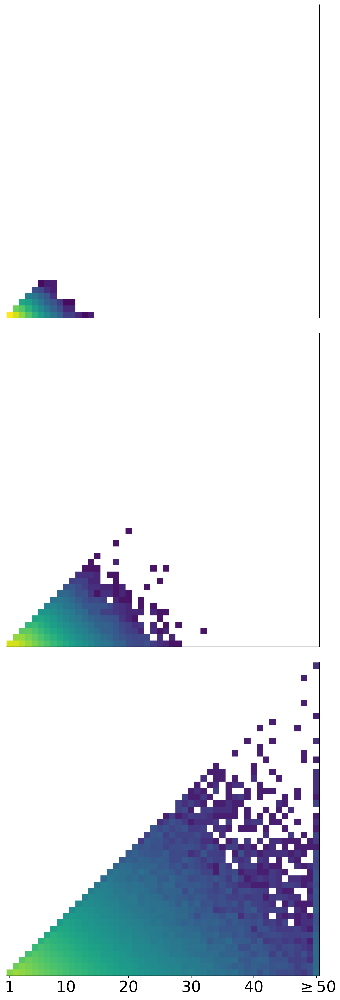

In [104]:
fig, (ax1,ax2,ax3) = plt.subplots(3,1,figsize = (18,27), gridspec_kw={'hspace': 0.05})


pixEarly=ax1.imshow(np.ma.array(MC_FS_bond_mat_early,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixMid=ax2.imshow(np.ma.array(MC_FS_bond_mat_mid,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixLate=ax3.imshow(np.ma.array(MC_FS_bond_mat_late,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))


#cb_AA = plt.colorbar(pixEarly, ax=[ax1,ax2,ax3] , orientation='vertical',location='right', aspect=100, pad=0.075)
#cb_AA.set_label(r'Bonding Probability')

for ax in [ax1,ax2,ax3]:
    ax.set_xlim(-0.5,cutoff_len-0.5)
    ax.set_ylim(-0.5,cutoff_len-0.5)
    ax.set_xticks([0,9,19,29,39,49])
    ax.set_xticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_yticks([0,9,19,29,39,49])
    ax.set_yticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    #ax.set_xlabel('Reacting Chain Length')
    ax.yaxis.tick_right()
    ax.yaxis.set_label_position('right')
    #ax.set_ylabel('Reacting Chain Length')
    ax.spines['top'].set_visible(False)
    ax.spines['left'].set_visible(False)
    #ax.spines['right'].set_visible(False)
    #ax.spines['bottom'].set_visible(False)
    

# Hide axes label marks
ax1.xaxis.set_tick_params(labelbottom=False)
ax2.xaxis.set_tick_params(labelbottom=False)
#ax3.xaxis.set_tick_params(labelbottom=False)
ax1.yaxis.set_tick_params(labelright=False)
ax2.yaxis.set_tick_params(labelright=False)
ax3.yaxis.set_tick_params(labelright=False)


# Hide axes tick marks
ax1.set_xticks([])
ax2.set_xticks([])
#ax3.set_xticks([])
ax1.set_yticks([])
ax2.set_yticks([])
ax3.set_yticks([])

fig.tight_layout()
plt.show()
#fig.savefig('230701_clean_copoly3_bond_prob_mat_FS_stiff.png',dpi=300, bbox_inches='tight',transparent=True)
fig.savefig('230701_clean_copoly3_bond_prob_mat_FS_stiff.png',dpi=300,transparent=True)

/tmp/ipykernel_30711/1804039360.py:50: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


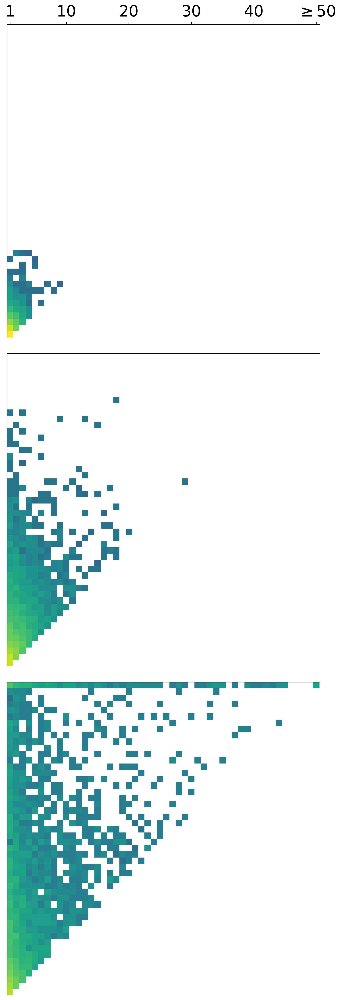

In [105]:
fig, (ax1,ax2,ax3) = plt.subplots(3,1,figsize = (18,27), gridspec_kw={'hspace': 0.05})



pixEarly=ax1.imshow(np.ma.array(flex_bond_mat_early,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixMid=ax2.imshow(np.ma.array(flex_bond_mat_mid,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixLate=ax3.imshow(np.ma.array(flex_bond_mat_late,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))


# cb_AA = plt.colorbar(pixEarly, ax=[ax1,ax2,ax3] , orientation='vertical',location='right', aspect=100, pad=0.025)

# cb_AA.set_label(r'$\Delta p_{FS}$',size=largesize)

# cb_AA.set_ticks([-0.1,-0.01,-0.001,-0.0001,-0.00001,0.0,0.00001,0.0001,0.001,0.01,0.1])

for ax in [ax1,ax2,ax3]:
    ax.set_xlim(-0.5,cutoff_len-0.5)
    ax.set_ylim(-0.5,cutoff_len-0.5)
    ax.set_xticks([0,9,19,29,39,49])
    ax.set_xticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_yticks([0,9,19,29,39,49])
    ax.set_yticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    #ax.set_xlabel('Reacting Chain Length')
    ax.xaxis.set_label_position('top') 
    ax.xaxis.tick_top()
    #ax.set_ylabel('Reacting Chain Length')
    #ax.spines['top'].set_visible(False)
    #ax.spines['left'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    
    
# Hide axes label marks
#ax1.xaxis.set_tick_params(labeltop=False)
ax2.xaxis.set_tick_params(labeltop=False)
ax3.xaxis.set_tick_params(labeltop=False)
ax1.yaxis.set_tick_params(labelleft=False)
ax2.yaxis.set_tick_params(labelleft=False)
ax3.yaxis.set_tick_params(labelleft=False)


# Hide axes tick marks
#ax1.set_xticks([])
ax2.set_xticks([])
ax3.set_xticks([])
ax1.set_yticks([])
ax2.set_yticks([])
ax3.set_yticks([])

fig.tight_layout()
plt.show()
#fig.savefig('230701_clean_copoly3_bond_prob_mat_flex.png',dpi=300, bbox_inches='tight',transparent=True)
fig.savefig('230701_clean_copoly3_bond_prob_mat_flex.png',dpi=300,transparent=True)

/tmp/ipykernel_30711/1844316470.py:46: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


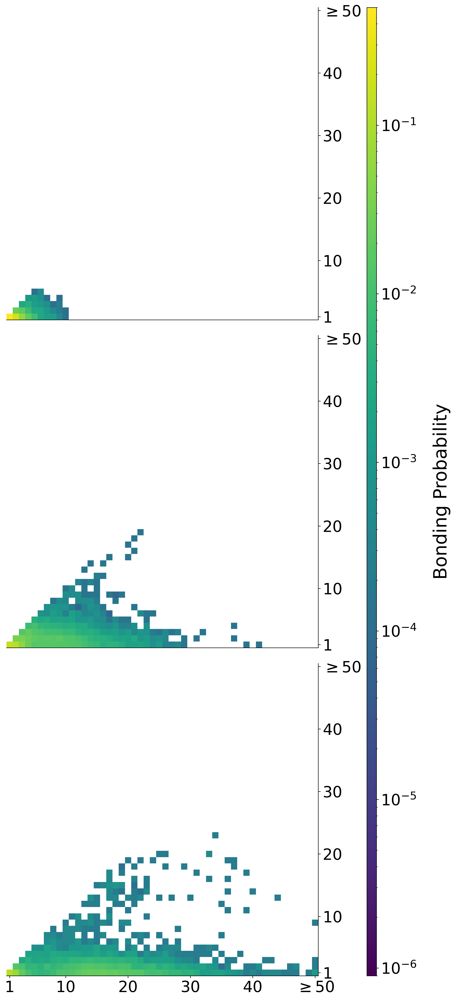

In [106]:
fig, (ax1,ax2,ax3) = plt.subplots(3,1,figsize = (18,27), gridspec_kw={'hspace': 0.05})


pixEarly=ax1.imshow(np.ma.array(stiff_bond_mat_early,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixMid=ax2.imshow(np.ma.array(stiff_bond_mat_mid,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))
pixLate=ax3.imshow(np.ma.array(stiff_bond_mat_late,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.viridis,norm=matplotlib.colors.LogNorm(vmin=9*(10**-7), vmax=0.5))


cb_AA = plt.colorbar(pixEarly, ax=[ax1,ax2,ax3] , orientation='vertical',location='right', aspect=100, pad=0.075)
cb_AA.set_label(r'Bonding Probability',labelpad=25)

for ax in [ax1,ax2,ax3]:
    ax.set_xlim(-0.5,cutoff_len-0.5)
    ax.set_ylim(-0.5,cutoff_len-0.5)
    ax.set_xticks([0,9,19,29,39,49])
    ax.set_xticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_yticks([0,9,19,29,39,49])
    ax.set_yticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    #ax.set_xlabel('Reacting Chain Length')
    ax.yaxis.tick_right()
    ax.yaxis.set_label_position('right')
    #ax.set_ylabel('Reacting Chain Length')
    ax.spines['top'].set_visible(False)
    ax.spines['left'].set_visible(False)
    #ax.spines['right'].set_visible(False)
    #ax.spines['bottom'].set_visible(False)
    
    
# Hide axes label marks
ax1.xaxis.set_tick_params(labelbottom=False)
ax2.xaxis.set_tick_params(labelbottom=False)
#ax3.xaxis.set_tick_params(labelbottom=False)
#ax1.yaxis.set_tick_params(labelright=False)
#ax2.yaxis.set_tick_params(labelright=False)
#ax3.yaxis.set_tick_params(labelright=False)


# Hide axes tick marks
ax1.set_xticks([])
ax2.set_xticks([])
#ax3.set_xticks([])
#ax1.set_yticks([])
#ax2.set_yticks([])
#ax3.set_yticks([])

fig.tight_layout()
plt.show()
#fig.savefig('230701_clean_copoly3_bond_prob_mat_stiff.png',dpi=300, bbox_inches='tight',transparent=True)
fig.savefig('230701_clean_copoly3_bond_prob_mat_stiff.png',dpi=300,transparent=True)

/tmp/ipykernel_30711/4097821536.py:49: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


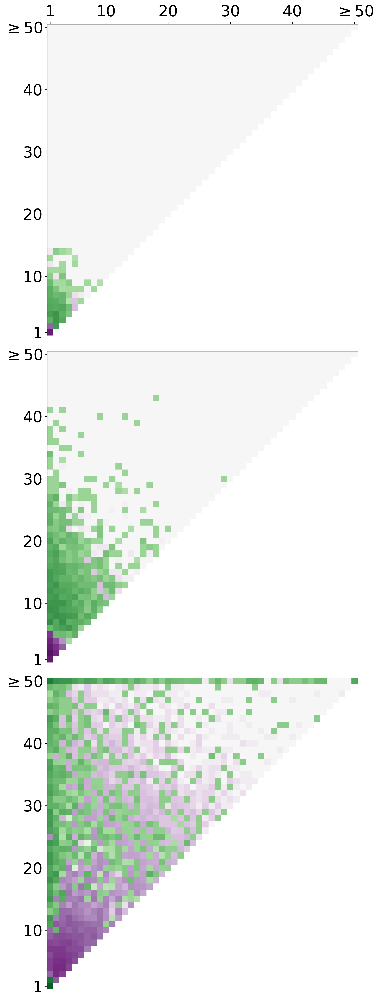

In [107]:
fig, (ax1,ax2,ax3) = plt.subplots(3,1,figsize = (18,27), gridspec_kw={'hspace': 0.05})



pixEarly=ax1.imshow(np.ma.array(flex_bond_mat_early-MC_FS_bond_mat_early,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1.,vmin=-0.2, vmax=0.2, base=10))
pixMid=ax2.imshow(np.ma.array(flex_bond_mat_mid-MC_FS_bond_mat_mid,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1., vmin=-0.2, vmax=0.2, base=10))
pixLate=ax3.imshow(np.ma.array(flex_bond_mat_late-MC_FS_bond_mat_late,mask=flex_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1., vmin=-0.2, vmax=0.2, base=10))


# cb_AA = plt.colorbar(pixEarly, ax=[ax1,ax2,ax3] , orientation='vertical',location='right', aspect=100, pad=0.025)

# cb_AA.set_label(r'$\Delta p_{FS}$',size=largesize)

# cb_AA.set_ticks([-0.1,-0.01,-0.001,-0.0001,-0.00001,0.0,0.00001,0.0001,0.001,0.01,0.1])

for ax in [ax1,ax2,ax3]:
    ax.set_xlim(-0.5,cutoff_len-0.5)
    ax.set_ylim(-0.5,cutoff_len-0.5)
    ax.set_xticks([0,9,19,29,39,49])
    ax.set_xticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_yticks([0,9,19,29,39,49])
    ax.set_yticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    #ax.set_xlabel('Reacting Chain Length')
    ax.xaxis.set_label_position('top') 
    ax.xaxis.tick_top()
    #ax.set_ylabel('Reacting Chain Length')
    #ax.spines['top'].set_visible(False)
    #ax.spines['left'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    
    
# Hide axes label marks
#ax1.xaxis.set_tick_params(labelbottom=False)
ax2.xaxis.set_tick_params(labelbottom=False)
ax3.xaxis.set_tick_params(labelbottom=False)
#ax1.yaxis.set_tick_params(labelleft=False)
#ax2.yaxis.set_tick_params(labelleft=False)
#ax3.yaxis.set_tick_params(labelleft=False)

# Hide axes tick marks
#ax1.set_xticks([])
ax2.set_xticks([])
ax3.set_xticks([])
#ax1.set_yticks([])
#ax2.set_yticks([])
#ax3.set_yticks([])
    
fig.tight_layout()
plt.show()
#fig.savefig('230701_clean_copoly3_bond_prob_mat_flex_delta.png',dpi=300, bbox_inches='tight',transparent=True)
fig.savefig('230701_clean_copoly3_bond_prob_mat_flex_delta.png',dpi=300, transparent=True)

/tmp/ipykernel_30711/1122527232.py:52: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


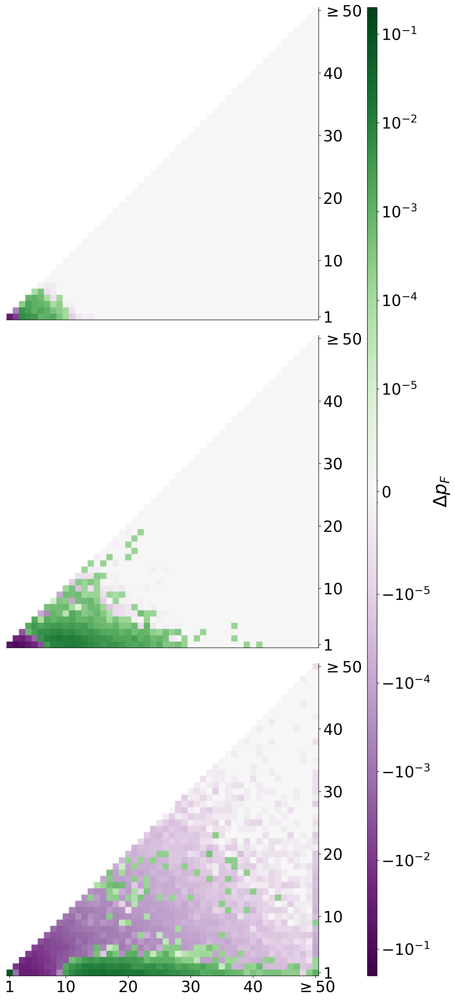

In [108]:
fig, (ax1,ax2,ax3) = plt.subplots(3,1,figsize = (18,27), gridspec_kw={'hspace': 0.05})


pixEarly=ax1.imshow(np.ma.array(stiff_bond_mat_early-MC_FS_bond_mat_early,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1.,vmin=-0.2, vmax=0.2, base=10))
pixMid=ax2.imshow(np.ma.array(stiff_bond_mat_mid-MC_FS_bond_mat_mid,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1., vmin=-0.2, vmax=0.2, base=10))
pixLate=ax3.imshow(np.ma.array(stiff_bond_mat_late-MC_FS_bond_mat_late,mask=stiff_mask), interpolation='none', cmap=matplotlib.cm.PRGn, norm=matplotlib.colors.SymLogNorm(linthresh=9*(10**-6), linscale=1., vmin=-0.2, vmax=0.2, base=10))


cb_AA = plt.colorbar(pixEarly, ax=[ax1,ax2,ax3] , orientation='vertical',location='right', aspect=100, pad=0.075)

cb_AA.set_label(r'$\Delta p_{F}$')

cb_AA.set_ticks([-0.1,-0.01,-0.001,-0.0001,-0.00001,0.0,0.00001,0.0001,0.001,0.01,0.1])

for ax in [ax1,ax2,ax3]:
    ax.set_xlim(-0.5,cutoff_len-0.5)
    ax.set_ylim(-0.5,cutoff_len-0.5)
    ax.set_xticks([0,9,19,29,39,49])
    ax.set_xticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    ax.set_yticks([0,9,19,29,39,49])
    ax.set_yticklabels([r'1',r'10',r'20',r'30',r'40',r'$\geq 50$'])
    #ax.set_xlabel('Reacting Chain Length')
    ax.yaxis.tick_right()
    ax.yaxis.set_label_position('right')
    #ax.set_ylabel('Reacting Chain Length')
    ax.spines['top'].set_visible(False)
    ax.spines['left'].set_visible(False)
    #ax.spines['right'].set_visible(False)
    #ax.spines['bottom'].set_visible(False)
    
    
    
    
# Hide axes label marks
ax1.xaxis.set_tick_params(labelbottom=False)
ax2.xaxis.set_tick_params(labelbottom=False)
#ax3.xaxis.set_tick_params(labelbottom=False)
#ax1.yaxis.set_tick_params(labelright=False)
#ax2.yaxis.set_tick_params(labelright=False)
#ax3.yaxis.set_tick_params(labelright=False)


# Hide axes tick marks
ax1.set_xticks([])
ax2.set_xticks([])
#ax3.set_xticks([])
#ax1.set_yticks([])
#ax2.set_yticks([])
#ax3.set_yticks([])


fig.tight_layout()
plt.show()
#fig.savefig('230701_clean_copoly3_bond_prob_mat_stiff_delta.png',dpi=300, bbox_inches='tight',transparent=True)
fig.savefig('230701_clean_copoly3_bond_prob_mat_stiff_delta.png',dpi=300,transparent=True)